# Libraries

In [1]:
import numpy as np
import random
import pickle
import os
# Change directory to the root of the folder (this script was launched from the subfolder python_scripts)
# All utils presuppose that we are working from the root directory of the github folder
os.chdir("../")
import sys
# Add utils directory in the list of directories to look for packages to import
sys.path.insert(0, os.path.join(os.getcwd(),'utils'))
from tqdm.notebook import tqdm
import pandas as pd
from datetime import datetime
import joblib
import gzip
from scipy.stats import pearsonr
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
from matplotlib.legend_handler import HandlerBase
from matplotlib import gridspec
from matplotlib.colors import ListedColormap, Normalize
from matplotlib.cm import ScalarMappable
from matplotlib import gridspec
import matplotlib.ticker
import pingouin as pg
from cycler import cycler
from scipy.stats import gaussian_kde
import copy
from scipy.integrate import odeint
import glob
import csv
import fnmatch

In [2]:
# local utils
from powerlaw_regr import *

In [3]:
figures_folder = "./figures/"
os.makedirs(figures_folder, exist_ok = True)

In [4]:
# DEFAULT PARAMETERS IN THE FIGURES TO BE ADJUSTED!!!!

plt.style.use("default")

multiplicator = 4
width_fig = 5.70978 * multiplicator # default text width in Comnet is 5.70978
height_fig = width_fig * 2 / 3

# this comes from "tableau-colorblind10",
CB_color_cycle = ['#006BA4', '#FF800E', '#ABABAB', '#595959',
                 '#5F9ED1', '#C85200', '#898989', '#A2C8EC', '#FFBC79', '#CFCFCF']
# Another good color blind one could be CB_color_cycle = ['#377eb8', '#ff7f00', '#4daf4a',
#                   '#f781bf', '#a65628', '#984ea3',
#                   '#999999', '#e41a1c', '#dede00']
params_default = {
    # change matplotlib cycle colors
    'axes.prop_cycle' : cycler('color', CB_color_cycle), 
    # change colormap
    'image.cmap' : 'cividis',
    # no upper and right axes
    'axes.spines.right' : False,
    'axes.spines.top' : False,
    # no frame around the legend
    "legend.frameon" : False,

    # dimensions of figures and labels
    # we will play with these once we see how they are rendered in the latex
    'figure.figsize' : (width_fig, height_fig),

    'axes.labelsize' : 8 * multiplicator, #22,
    'axes.titlesize' : 8 * multiplicator, #25,
    'xtick.labelsize' : 6 * multiplicator, #18,
    'ytick.labelsize' : 6 * multiplicator, #18,
    'legend.fontsize' : 6 * multiplicator, #16,
    'font.size' : 8 * multiplicator,

    # no grids (?)
    'axes.grid' : False,

    # the default color(s) for lines in the plots: in order if multiple lines. We can change them or add colors if needed
#     'axes.prop_cycle' : mpl.cycler(color=["#00008B", "#BF0000", "#006400"]), 

    # default quality of the plot. Not too high but neither too low
    "savefig.dpi" : 300,
    "savefig.bbox" : 'tight', 
    
#     'mathtext.fontset': 'stix',
#     'font.family': 'STIXGeneral',
    'font.family' : 'sans-serif', 
    'font.sans-serif' : ['Tahoma', 'DejaVu Sans', 'Lucida Grande', 'Verdana'], 
#     'text.usetex' : True,
#     'text.latex.preamble': r"\usepackage{amsmath}",
}

plt.rcParams.update(params_default)
letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'.lower()

In [5]:
class continuous_and_dashed_line_handle(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       x0, y0, width, height, fontsize, trans):
        if orig_handle[2]:
            l1 = plt.Line2D([x0,y0+width], [0.3*height,0.3*height],
                               linestyle=orig_handle[1], color=orig_handle[0])
            l2 = plt.Line2D([x0,y0+width], [0.7*height,0.7*height], 
                               color=orig_handle[0])
            return [l1, l2]
        else:
            l1 = plt.Line2D([x0,y0+width], [0.5*height,0.5*height],
                               linestyle=orig_handle[1], color=orig_handle[0])
            return [l1]

class line_and_filled_handle(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       x0, y0, width, height, fontsize, trans):
            l1 = plt.Line2D([x0,y0+width], [0.5*height,0.5*height],
                               color=orig_handle[0])
            l2 = plt.Line2D([x0+width*0.1,y0+width*0.9], [0.5*height,0.5*height], 
                               color=orig_handle[1], lw=10)
            return [l1, l2]

Text(0, 0.5, 'Last.fm')

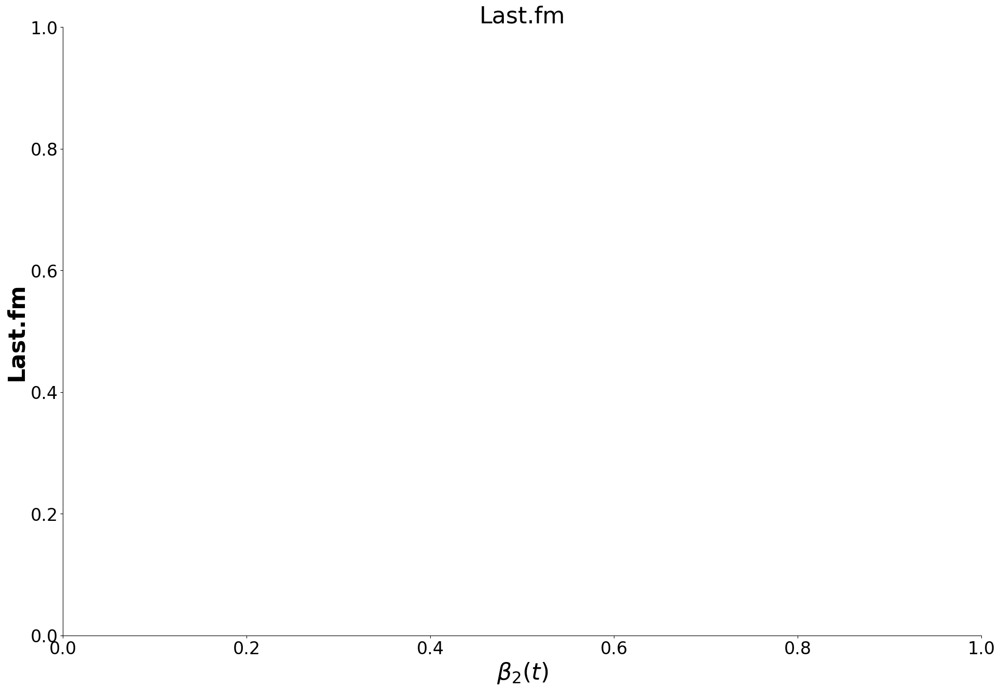

In [6]:
plt.title('Last.fm')
plt.xlabel(r"$\beta_2(t)$")
plt.ylabel('Last.fm', fontweight='bold')

In [7]:
def find_pattern(pattern, path):
    '''
        Finds all the paths inside path that are of the given pattern.

        E.g.: find_pattern("*.pkl", "./") to find all the files terminating with .pkl inside the current directory

        Returns the list of all such paths (empty is none is found).
    '''
    result = []
    for root, dirs, files in os.walk(path):
        for name in files:
            if fnmatch.fnmatch(name, pattern):
                result.append(os.path.join(root, name))
    return result

# Load data

## Load essential data

In [7]:
with gzip.open('./data/essential_data_for_figures.pkl.gz', "rb") as fp:
    data = joblib.load(fp)

In [8]:
with gzip.open('./data/essential_data_labels_for_figures.pkl.gz', "rb") as fp:
    data_labels = joblib.load(fp)

/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.1, the latest is 0.2.2.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(
/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.1, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


## Prepare essential data

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

### Load analyzed data

In [396]:
with gzip.open("./data/ocelma-dataset/lastfm-dataset-1K/results_light_users_lastfm.pkl.gz", "rb") as fp:
    results_light_individual_lastfm = joblib.load(fp)

In [9]:
with gzip.open("./data/ocelma-dataset/lastfm-dataset-1K/results_light_users_lastfm_artists.pkl.gz", "rb") as fp:
    results_light_individual_lastfm_artists = joblib.load(fp)

In [10]:
with open(os.path.join('./data/ocelma-dataset/lastfm-dataset-1K/', f"average_individual_results.pkl"), "rb") as fp:
    average_results_individual_lastfm = joblib.load(fp)

In [11]:
with open("./data/ocelma-dataset/lastfm-dataset-1K/average_individual_results_artists.pkl", "rb") as fp:
    average_results_individual_lastfm_artists = joblib.load(fp)

In [12]:
print(len(results_light_individual_lastfm))

890


In [796]:
# with gzip.open("./data/gutenberg/analysis/results_light_texts.pkl.gz", "rb") as fp:
with gzip.open("./data/gutenberg/analysis/results_light_texts_positive_intercept.pkl.gz", "rb") as fp:
    results_light_individual_gutenberg = joblib.load(fp)

In [14]:
with gzip.open("./data/gutenberg/analysis/results_light_stems.pkl.gz", "rb") as fp:
    results_light_individual_gutenberg_stems = joblib.load(fp)

In [15]:
with open("./data/gutenberg/analysis/average_individual_results.pkl", "rb") as fp:
    average_results_individual_gutenberg = joblib.load(fp)

In [16]:
with open("./data/gutenberg/analysis/average_individual_results_stems.pkl", "rb") as fp:
    average_results_individual_gutenberg_stems = joblib.load(fp)

In [17]:
print(len(results_light_individual_gutenberg))

19637


In [815]:
results_light_individual_journals_fieldsOfStudy['Art']['0'].keys()

dict_keys(['ts', 'indices', 'ts_geom', 'indices_geom', 'D_indices', 'D2_indices', 'D3_indices', 'D4_indices', 'weighted_diff_entropies', 'beta_mean_indices', 'beta2_mean_indices', 'beta3_mean_indices', 'beta4_mean_indices', 'beta_loglogregr_indices_geom', 'beta2_loglogregr_indices_geom', 'beta3_loglogregr_indices_geom', 'beta4_loglogregr_indices_geom'])

In [399]:
corpus_version = '2022-01-01'
with open(os.path.join('./data/semanticscholar/analysis/', corpus_version, 'journals_fieldsOfStudy_light', 'results_light_texts.pkl'), 'rb') as fp:
    results_light_individual_journals_fieldsOfStudy = joblib.load(fp)

In [ ]:
corpus_version = '2022-01-01'
with open(os.path.join('./data/semanticscholar/analysis/', corpus_version, 'journals_fieldsOfStudy_stems_light', 'results_light_stems.pkl'), 'rb') as fp:
    results_light_individual_journals_fieldsOfStudy_stems = joblib.load(fp)

In [ ]:
with open(os.path.join('./data/semanticscholar/analysis/', corpus_version, 'average_individual_results_journals_fieldsOfStudy.pkl'), 'rb') as fp:
    average_results_individual_journals_fieldsOfStudy = joblib.load(fp)

In [ ]:
with open(os.path.join('./data/semanticscholar/analysis/', corpus_version, 'average_individual_results_journals_fieldsOfStudy_stems.pkl'), 'rb') as fp:
    average_results_individual_journals_fieldsOfStudy_stems = joblib.load(fp)

In [ ]:
print(len(results_light_individual_journals_fieldsOfStudy), sum([len(tmp) for tmp in results_light_individual_journals_fieldsOfStudy.values()]))

### Get essential stats for figures

#### Functions

In [49]:
def adjust_positive_intercept_fit_result_sequence(result):
    indices_geom = result['indices_geom']
    ts_geom = result['ts_geom']
    D_indices_geom = result['D_indices'][indices_geom]
    D2_indices_geom = result['D2_indices'][indices_geom]
    D3_indices_geom = result['D3_indices'][indices_geom]
    D4_indices_geom = result['D4_indices'][indices_geom]

    beta_list = []
    beta2_list = []
    beta3_list = []
    beta4_list = []
    intercept_list = []
    intercept2_list = []
    intercept3_list = []
    intercept4_list = []
    std_err_beta_list = []
    std_err_beta2_list = []
    std_err_beta3_list = []
    std_err_beta4_list = []
    std_err_intercept_list = []
    std_err_intercept2_list = []
    std_err_intercept3_list = []
    std_err_intercept4_list = []
    for i in range(len(ts_geom)):
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(0,i-100)+1:i+1], D_indices_geom[max(0,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta_list.append(slope)
        intercept_list.append(intercept)
        std_err_beta_list.append(std_err[0])
        std_err_intercept_list.append(std_err[1])
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(1,i-100)+1:i+1]-1, D2_indices_geom[max(1,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta2_list.append(slope)
        intercept2_list.append(intercept)
        std_err_beta2_list.append(std_err[0])
        std_err_intercept2_list.append(std_err[1])
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(2,i-100)+1:i+1]-2, D3_indices_geom[max(2,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta3_list.append(slope)
        intercept3_list.append(intercept)
        std_err_beta3_list.append(std_err[0])
        std_err_intercept3_list.append(std_err[1])
        slope, intercept, std_err = powerLawRegrPoints(ts_geom[max(3,i-100)+1:i+1]-3, D4_indices_geom[max(3,i-100)+1:i+1], intercept_left_lim = 0, intercept_right_lim = np.inf)
        beta4_list.append(slope)
        intercept4_list.append(intercept)
        std_err_beta4_list.append(std_err[0])
        std_err_intercept4_list.append(std_err[1])
    result["beta"] = np.array(beta_list)
    result["beta2"] = np.array(beta2_list)
    result["beta3"] = np.array(beta3_list)
    result["beta4"] = np.array(beta4_list)
    result["intercept"] = np.array(intercept_list)
    result["intercept2"] = np.array(intercept2_list)
    result["intercept3"] = np.array(intercept3_list)
    result["intercept4"] = np.array(intercept4_list)
    result["std_err_beta"] = np.array(std_err_beta_list)
    result["std_err_beta2"] = np.array(std_err_beta2_list)
    result["std_err_beta3"] = np.array(std_err_beta3_list)
    result["std_err_beta4"] = np.array(std_err_beta4_list)
    result["std_err_intercept"] = np.array(std_err_intercept_list)
    result["std_err_intercept2"] = np.array(std_err_intercept2_list)
    result["std_err_intercept3"] = np.array(std_err_intercept3_list)
    result["std_err_intercept4"] = np.array(std_err_intercept4_list)
    return result

In [542]:
def get_info_stats_last_results(results):
    new_results = {}
    for order_index,order in enumerate(['', '2', '3', '4']):
        print(f"Order {order_index}")
        betas = []
        loglog_intercepts = []
        intercepts = []
        std_err_betas = []
        std_err_intercepts = []
        confidence_intervals_betas = []
        t_values_betas = []
        p_values_betas = []
        confidence_intervals_loglog_intercepts = []
        t_values_loglog_intercepts = []
        p_values_loglog_intercepts = []
        for result in results.values():
            indices_geom = result['indices_geom']
            ts_geom = result['ts_geom']
            D_indices_geom = result[f'D{order}_indices'][indices_geom]
            i = list(range(len(ts_geom)))[-1]
            xs = ts_geom[max(order_index,i-100)+1:i+1]-order_index
            ys = D_indices_geom[max(order_index,i-100)+1:i+1]
            xs = np.log10(xs)
            ys = np.log10(ys)
            beta, loglog_intercept, std_err, confidence_intervals, t_values, p_values = lin_regr_with_stats(
                xs, ys, 
                intercept_left_lim = 0, intercept_right_lim = np.inf, 
                get_more_statistcs = True, 
                alpha_for_conf_interv = 0.99
            )
            betas.append(beta)
            loglog_intercepts.append(loglog_intercept)
            intercepts.append(10**loglog_intercept)
            std_err_betas.append(std_err[0])
            std_err_intercepts.append(std_err[1])
            confidence_intervals_betas.append(confidence_intervals[0])
            t_values_betas.append(t_values[0])
            p_values_betas.append(p_values[0])
            confidence_intervals_loglog_intercepts.append(confidence_intervals[1])
            t_values_loglog_intercepts.append(t_values[1])
            p_values_loglog_intercepts.append(p_values[1])
        new_results[f'betas{order}'] = np.array(betas)
        new_results[f'loglog_intercepts{order}'] = np.array(loglog_intercepts)
        new_results[f'intercepts{order}'] = np.array(intercepts)
        new_results[f'std_err_betas{order}'] = np.array(std_err_betas)
        new_results[f'std_err_intercepts{order}'] = np.array(std_err_intercepts)
        new_results[f'confidence_intervals_betas{order}'] = np.array(confidence_intervals_betas)
        new_results[f't_values_betas{order}'] = np.array(t_values_betas)
        new_results[f'p_values_betas{order}'] = np.array(p_values_betas)
        new_results[f'confidence_intervals_loglog_intercepts{order}'] = np.array(confidence_intervals_loglog_intercepts)
        new_results[f't_values_loglog_intercepts{order}'] = np.array(t_values_loglog_intercepts)
        new_results[f'p_values_loglog_intercepts{order}'] = np.array(p_values_loglog_intercepts)
    new_results['len'] = np.array([result["ts"][-1] for result in results.values()])
    new_results['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for result in results.values()])
    return new_results

#### Data

In [63]:
results_light = {
    "Last.fm" : results_light_individual_lastfm,
    "Project Gutenberg" : results_light_individual_gutenberg,
    "Semantic Scholar" : {f"{field}_{index}" : result for field, field_results in results_light_individual_journals_fieldsOfStudy.items() for index, result in field_results.items()},
}

In [64]:
average_results_to_adjust = {
    "Last.fm" : average_results_individual_lastfm, 
    "Project Gutenberg" : average_results_individual_gutenberg, 
    "Semantic Scholar" : average_results_individual_journals_fieldsOfStudy, 
}

In [ ]:
data = {}
for dataset_name, results in results_light.items():
    print(f"Starting {dataset_name}")
    data[dataset_name] = get_info_stats_last_results(results)
    data[dataset_name]['average_results'] = adjust_positive_intercept_fit_result_sequence(average_results_to_adjust[dataset_name])
with gzip.open('./data/essential_data_for_figures.pkl.gz', "wb") as fp:
    joblib.dump(data, fp)
print('Dumped')

Starting Last.fm
Order 0


/tmp/2785684.1.all.q/ipykernel_27565/3776544883.py:182: RuntimeWarning: divide by zero encountered in true_divide
  tstat_beta = parameters / parameterStatistics.sd_beta # coeff t-statistics


Order 1
Order 2
Order 3
Starting Project Gutenberg
Order 0
Order 1
Order 2
Order 3
Starting Semantic Scholar
Order 0
Order 1


In [57]:
# for dataset in data.values():
#     for order_index,order in enumerate(['', '2', '3', '4']):
#         dataset[f'betas{order}'] = np.array(dataset[f'betas{order}'])
#         dataset[f'loglog_intercepts{order}'] = np.array(dataset[f'loglog_intercepts{order}'])
#         dataset[f'intercepts{order}'] = np.array(dataset[f'intercepts{order}'])
#         dataset[f'std_err_betas{order}'] = np.array(dataset[f'std_err_betas{order}'])
#         dataset[f'std_err_intercepts{order}'] = np.array(dataset[f'std_err_intercepts{order}'])
#         dataset[f'confidence_intervals_betas{order}'] = np.array(dataset[f'confidence_intervals_betas{order}'])
#         dataset[f't_values_betas{order}'] = np.array(dataset[f't_values_betas{order}'])
#         dataset[f'p_values_betas{order}'] = np.array(dataset[f'p_values_betas{order}'])
#         dataset[f'confidence_intervals_loglog_intercepts{order}'] = np.array(dataset[f'confidence_intervals_loglog_intercepts{order}'])
#         dataset[f't_values_loglog_intercepts{order}'] = np.array(dataset[f't_values_loglog_intercepts{order}'])
#         dataset[f'p_values_loglog_intercepts{order}'] = np.array(dataset[f'p_values_loglog_intercepts{order}'])

In [58]:
# with gzip.open('./data/essential_data_for_figures.pkl.gz', "wb") as fp:
#     joblib.dump(data, fp)

#### Data labels

In [ ]:
results_light_labels = {
    "Last.fm" : results_light_individual_lastfm_artists,
    "Project Gutenberg" : results_light_individual_gutenberg_stems,
    "Semantic Scholar" : {f"{field}_{index}" : result for field, field_results in results_light_individual_journals_fieldsOfStudy_stems.items() for index, result in field_results.items()},
}

In [ ]:
average_results_labels_to_adjust = {
    "Last.fm" : average_results_individual_lastfm_artists, 
    "Project Gutenberg" : average_results_individual_gutenberg_stems, 
    "Semantic Scholar" : average_results_individual_journals_fieldsOfStudy_stems
}

In [ ]:
data_labels = {}
for dataset_name, results in results_light_labels.items():
    print(f"Starting {dataset_name}")
    data_labels[dataset_name] = get_info_stats_last_results(results)
    data_labels[dataset_name]['average_results'] = adjust_positive_intercept_fit_result_sequence(average_results_labels_to_adjust[dataset_name])
with gzip.open('./data/essential_data_labels_for_figures.pkl.gz', "wb") as fp:
    joblib.dump(data_labels, fp)
print('Dumped')

In [59]:
# for dataset in data_labels.values():
#     for order_index,order in enumerate(['', '2', '3', '4']):
#         dataset[f'betas{order}'] = np.array(dataset[f'betas{order}'])
#         dataset[f'loglog_intercepts{order}'] = np.array(dataset[f'loglog_intercepts{order}'])
#         dataset[f'intercepts{order}'] = np.array(dataset[f'intercepts{order}'])
#         dataset[f'std_err_betas{order}'] = np.array(dataset[f'std_err_betas{order}'])
#         dataset[f'std_err_intercepts{order}'] = np.array(dataset[f'std_err_intercepts{order}'])
#         dataset[f'confidence_intervals_betas{order}'] = np.array(dataset[f'confidence_intervals_betas{order}'])
#         dataset[f't_values_betas{order}'] = np.array(dataset[f't_values_betas{order}'])
#         dataset[f'p_values_betas{order}'] = np.array(dataset[f'p_values_betas{order}'])
#         dataset[f'confidence_intervals_loglog_intercepts{order}'] = np.array(dataset[f'confidence_intervals_loglog_intercepts{order}'])
#         dataset[f't_values_loglog_intercepts{order}'] = np.array(dataset[f't_values_loglog_intercepts{order}'])
#         dataset[f'p_values_loglog_intercepts{order}'] = np.array(dataset[f'p_values_loglog_intercepts{order}'])

In [60]:
# with gzip.open('./data/essential_data_labels_for_figures.pkl.gz', "wb") as fp:
#     joblib.dump(data_labels, fp)

# Figure: Higher order Heaps' exponents DATA

## Prep data

## Functions

In [8]:
def fig_1_subplot_a(average_result, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = 1, 
                    ylim_bottom = 1, ylim_top = 1, 
                    ylabel = None, xlabel = None, 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    labels = []
    for i,order in enumerate(['', '2', '3']): # , '4'
        ax.plot(average_result["ts"]-i, average_result[f"D{order}_indices"], color = CB_color_cycle[i])
#         ax.plot([1]+list(average_result["ts"]-i+1), [1]+list(average_result[f"D{order}_indices"]), color = CB_color_cycle[i])
#         ax.plot(average_result["ts"],average_result["ts"]**average_result[f"beta{order}"][-1] * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
        if f"intercept{order}" in average_result:
            intercept = average_result[f"intercept{order}"][-1]
        else:
            intercept = 1
        ax.plot(average_result["ts"], intercept * average_result["ts"]**average_result[f"beta{order}"][-1], # * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
                color = CB_color_cycle[i], ls = "--", alpha=alpha)
        if order == '':
            labels.append(r"$D_1(t)\sim t^{%.2f}$"%(average_result["beta"][-1]))
        else:
            labels.append(r"$D_{%s}(t)\sim t^{%.2f}$"%(order, average_result[f"beta{order}"][-1]))
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel)#, fontweight='bold')
    ax.set_ylabel(ylabel)#, fontweight='bold')
    ax.loglog()
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    ax.yaxis.set_major_locator(locmaj)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Legend
#     leg1 = ax.legend([(color,"--",True) for color in CB_color_cycle[:2]], labels[:2] , 
#                      handler_map={tuple: continuous_and_dashed_line_handle()},
#                      handletextpad=0.1, bbox_to_anchor=(-0.06,1.1), loc="upper left", labelspacing = 0, handlelength = 1.5
#     ) 

#     leg2 = ax.legend([(color,"--",True) for color in CB_color_cycle[2:4]], labels[2:] , 
    leg = ax.legend([(color,"--",True) for color in CB_color_cycle], labels, 
                     handler_map={tuple: continuous_and_dashed_line_handle()},
                     handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0, handlelength = 1.5
    )
#     ax.add_artist(leg1)
    if write_number == True:
#         ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [9]:
def scatter_with_density(x, y, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    # Calculate the point density
    x = np.array(x)
    y = np.array(y)

    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]

    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [10]:
def plot_distribution_histograms_on_axes(x, y, ax = None, color_x = None, color_y = None, alpha = 0.3, max_hist = 0.25, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = min(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = min(y)
    
    n, bins, rects = ax.hist(x,density=True, bins = np.linspace(min_x,max_x, 30),alpha=alpha, bottom=min_y-0.02, color=color_x, rasterized=True)
    max_hist_proportioned = max_hist * (max_y-0.02 - min_y+0.02)
    max_height = max(1,max([r.get_height() for r in rects]))
    for r in rects:
        r.set_height(r.get_height()*max_hist_proportioned/max_height)
    n, bins, rects = ax.hist(y,density=True, bins = np.linspace(min_y,max_y, 30),alpha=alpha, bottom=min_x-0.02, orientation='horizontal',color=color_y, rasterized=True)
    max_hist_proportioned = max_hist * (max_x-0.02 - min_x+0.02)
    max_width = max(1,max([r.get_width() for r in rects]))
    for r in rects:
        r.set_width(r.get_width()*max_hist_proportioned/max_width)
        

In [11]:
def last_modifications_fig_1_subplot_b_d(x, y, number_to_write = 0, write_number = False, 
                                         do_dashed_line = True, 
                                         x_correlation_text = 0.63, y_correlation_text = .32, ax = None, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = min(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = min(y)
    xlim = [min_x-0.02, max_x + 0.02]
    ylim = [min_y-0.02, max_y + 0.02]
    if do_dashed_line == True:
#         ax.plot([min_x-0.02, max_x + 0.02], [min_x-0.02,max_x + 0.02], '--', color="gray") 
        ax.plot([-100000, 100000], [-100000, 100000], '--', color="gray") 
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    # Impose xticks
    if min_x > -0.1 and min_x <=0 and max_x >= 1 and max_x < 1.1: 
        ax.set_xticks(np.arange(0,1.0000001,0.1), minor=True)
        ax.set_yticks(np.arange(0,1.0000001,0.1), minor=True)
        ax.set_xticks(np.arange(0,1.0000001,0.5), minor=False)
        ax.set_yticks(np.arange(0,1.0000001,0.5), minor=False)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
#     leg = ax.legend(handletextpad=0.1,bbox_to_anchor=(1.06,0.5), loc="center right", labelspacing = 0, handlelength = 1.5)
    pearsonr_test = pearsonr(x,y)
    text_to_write = r'$r=%.2f$'%(pearsonr_test[0])
    print(f"p-value pearson between {xlabel} and {ylabel}", pearsonr_test[1], flush=True)
    ax.text(x_correlation_text, y_correlation_text, text_to_write, transform=ax.transAxes, fontsize=multiplicator*6) #  fontsize=32, 
    if write_number == True:
        letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'.lower()
#         ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')

In [12]:
def fig_1_subplot_b_d(
    x, 
    y, 
    ax = None, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    number_to_write = 0, 
    write_number = False, 
    ylabel = None, 
    xlabel = None, 
    min_x = None, 
    max_x = None,
    min_y = None, 
    max_y = None,
    do_dashed_line = True,
):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = max(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = max(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_density(x, y, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
    plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_fig_1_subplot_b_d(x, y, do_dashed_line = do_dashed_line,
                                         number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [13]:
def fig_1(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = None,
          max_beta = None,
          min_beta_higher = None,
          max_beta_higher = None,
          use_same_x_y_max_lim = True,
          do_dashed_line = True,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
         ):
    nrows = num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios = [10]+[1], wspace=0.1) # 0.25
    wspace = 0.38
    hspace = 0.3
    higher_orders = [2,3]
    ncols = len(higher_orders) + 1
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for dataset_label, dataset_dict in data.items():
            max_t = max(max_t, dataset_dict['average_results']["ts"][-1]+1)
            for order in ['', '2', '3']: #  '4'
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[0],wspace=wspace,hspace=hspace)
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        print(dataset_label)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b_d = None
        ax = plt.Subplot(fig, inner[i*ncols])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['']+[str(tmp_order) for tmp_order in higher_orders]:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        fig_1_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = '\n'.join(dataset_label.split(' ')), xlabel = xlabel_a, write_number = True,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate(higher_orders, start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i*ncols + i_order])
            fig_1_subplot_b_d(dataset_dict['betas'], dataset_dict[f'betas{order}'], 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = True, #i==0, 
                              do_dashed_line = do_dashed_line,
                              ylabel = fr"$\beta_{order}$", xlabel = xlabel_b_d, 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                            x_correlation_text = x_correlation_text, 
                            y_correlation_text = y_correlation_text,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[-1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.75,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    cb.ax.get_yaxis().set_ticks([0,1]) 
    cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.1, the latest is 0.2.2.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(
/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.1, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


## Figure

Last.fm
p-value pearson between None and $\beta_2$ 1.428738990674999e-36
p-value pearson between None and $\beta_3$ 1.6898241661829013e-25
Project Gutenberg
p-value pearson between None and $\beta_2$ 0.0
p-value pearson between None and $\beta_3$ 0.0
Semantic Scholar
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
p-value pearson between $\beta_1$ and $\beta_3$ 0.0


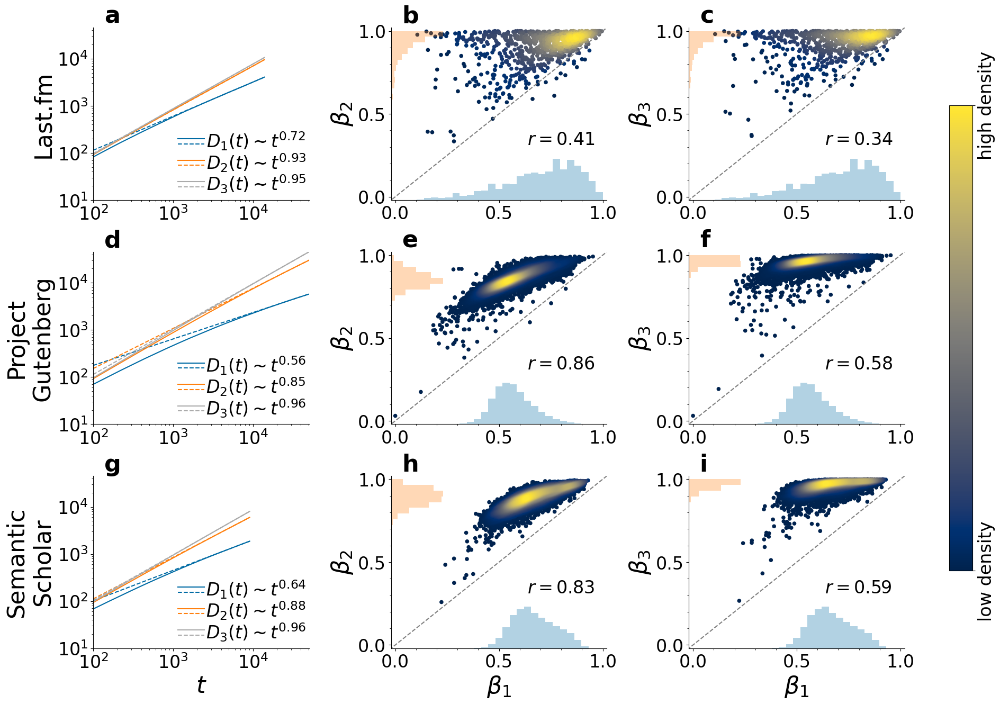

In [1113]:
fig = fig_1(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e1,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
    use_same_x_y_max_lim = True,
    do_dashed_line = True,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets.pdf"),format='pdf')

Last.fm
p-value pearson between None and $\beta_2$ 1.428738990674999e-36
p-value pearson between None and $\beta_3$ 1.6898241661829013e-25
p-value pearson between None and $\beta_4$ 2.3435326013386827e-21
Project Gutenberg
p-value pearson between None and $\beta_2$ 0.0
p-value pearson between None and $\beta_3$ 0.0
p-value pearson between None and $\beta_4$ 0.0
Semantic Scholar
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
p-value pearson between $\beta_1$ and $\beta_3$ 0.0
p-value pearson between $\beta_1$ and $\beta_4$ 0.0


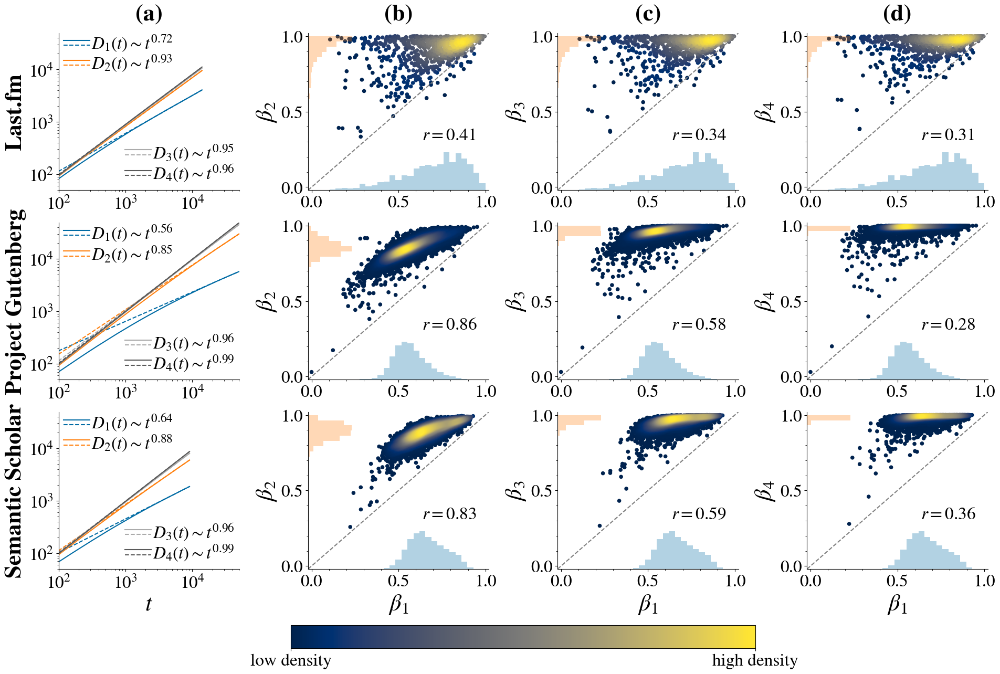

In [485]:
fig = fig_1(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 5e1,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
    use_same_x_y_max_lim = True,
    do_dashed_line = True,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets.pdf"),format='pdf')

## Functions new

In [226]:
def fig_1_new(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, 
              color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = None,
          max_beta = None,
          min_beta_higher = None,
          max_beta_higher = None,
          use_same_x_y_max_lim = True,
        do_dashed_line = False,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
              normalize=True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for dataset_label, dataset_dict in data.items():
            max_t = max(max_t, dataset_dict['average_results']["ts"][-1]+1)
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        print(dataset_label)
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b = r"$\beta_1$"
            xlabel_c = r"$\beta_1$"
            xlabel_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
        ax = plt.Subplot(fig, inner[0])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        fig_1_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = dataset_label, xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate([2,3,4], start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i_order])
            x = np.array(dataset_dict[f'betas'])
            y = np.array(dataset_dict[f'betas{order}'])
            y = (y-x)
            if normalize==True:
                y /= 1-x
            fig_1_subplot_b_d(x, y, 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              do_dashed_line = do_dashed_line,
                              write_number = i==0, 
                              x_correlation_text = x_correlation_text, 
                              y_correlation_text = y_correlation_text,
                              xlabel = xlabel_b, 
                              ylabel = fr"$(\beta_{order} - \beta_{1}) / (1 - \beta_{1})$" if normalize==True else fr"$\beta_{order} - \beta_{1}$", 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure new

Last.fm
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 4.093214506247945e-06
p-value pearson between None and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 1.0455699429973347e-06
p-value pearson between None and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 1.231932312436595e-06
Project Gutenberg
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 2.8172965329696038e-33
Semantic Scholar
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 2.971801611616885e-242
p-value pearson between $\beta_1$ and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 1.945698409917331e-40


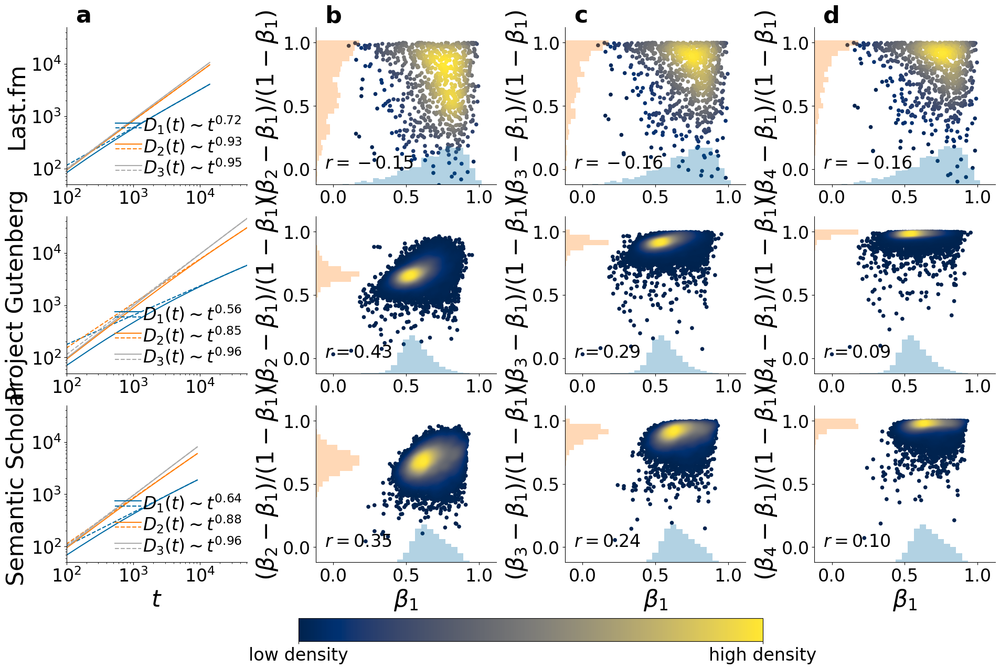

In [227]:
fig = fig_1_new(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 5e1,
    min_beta = -0.1,
    max_beta = 1.1,
    min_beta_higher = -0.1,
    max_beta_higher = 1.1,
    use_same_x_y_max_lim = True,
    do_dashed_line = False,
    x_correlation_text = 0.05,
    y_correlation_text = 0.1,
    normalize = True,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new_normalized.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res_new_normalized.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new_normalized.pdf"),format='pdf')

Last.fm
p-value pearson between None and $\beta_2 - \beta_1$ 9.146459496893713e-229
p-value pearson between None and $\beta_3 - \beta_1$ 5.120569370697204e-290
p-value pearson between None and $\beta_4 - \beta_1$ 0.0
Project Gutenberg
p-value pearson between None and $\beta_2 - \beta_1$ 0.0
p-value pearson between None and $\beta_3 - \beta_1$ 0.0
p-value pearson between None and $\beta_4 - \beta_1$ 0.0
Semantic Scholar
p-value pearson between $\beta_1$ and $\beta_2 - \beta_1$ 0.0
p-value pearson between $\beta_1$ and $\beta_3 - \beta_1$ 0.0
p-value pearson between $\beta_1$ and $\beta_4 - \beta_1$ 0.0


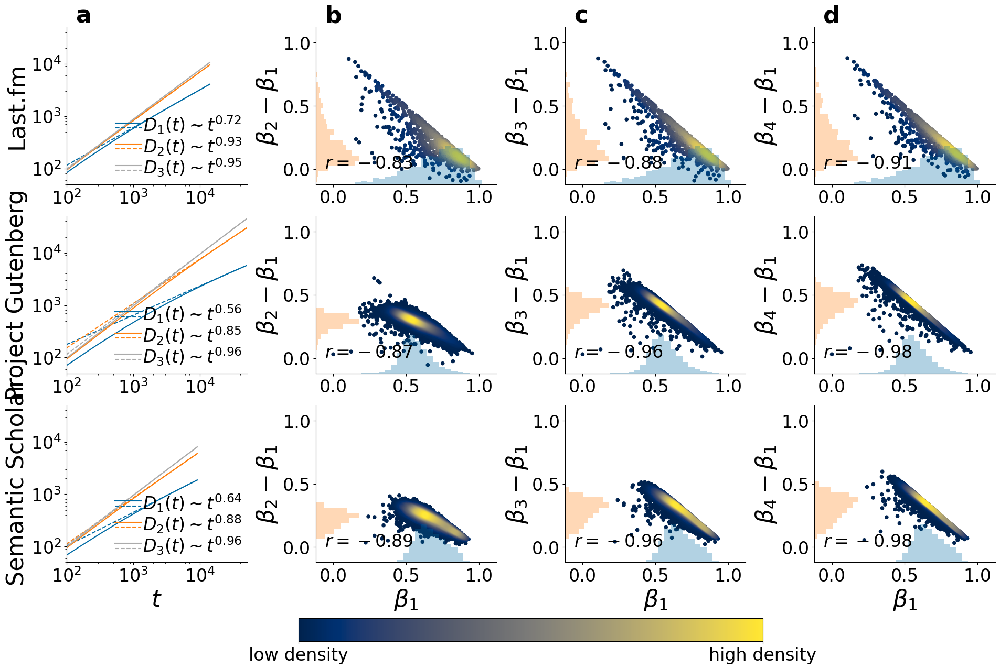

In [228]:
fig = fig_1_new(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 5e1,
    min_beta = -0.1,
    max_beta = 1.1,
    min_beta_higher = -0.1,
    max_beta_higher = 1.1,
    use_same_x_y_max_lim = True,
    do_dashed_line = False,
    x_correlation_text = 0.05,
    y_correlation_text = 0.1,
    normalize = False,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new_not_normalized.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res_new_not_normalized.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new_not_normalized.pdf"),format='pdf')

## Functions new2

In [237]:
def fig_1_new2(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, 
              color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = None,
          max_beta = None,
          min_beta_higher = None,
          max_beta_higher = None,
          use_same_x_y_max_lim = True,
        do_dashed_line = False,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
              normalize=True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for dataset_label, dataset_dict in data.items():
            max_t = max(max_t, dataset_dict['average_results']["ts"][-1]+1)
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        print(dataset_label)
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b = r"$\beta_1$"
            xlabel_c = r"$\beta_1$"
            xlabel_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
        ax = plt.Subplot(fig, inner[0])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        fig_1_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = dataset_label, xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate([2,3,4], start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i_order])
            if n_order == 2:
                previous_order = ''
            else:
                previous_order = str(n_order-1)
            x = np.array(dataset_dict[f'betas{previous_order}'])
            y = np.array(dataset_dict[f'betas{order}'])
            y = (y-x)
            if normalize==True:
                y /= 1-x
            if previous_order == '':
                previous_order = '1'
            if i == num_datasets - 1:
                xlabel_b = fr"$\beta_{previous_order}$"
            else:
                xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
            fig_1_subplot_b_d(x, y, 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              do_dashed_line = do_dashed_line,
                              write_number = i==0, 
                              x_correlation_text = x_correlation_text, 
                              y_correlation_text = y_correlation_text,
                              xlabel = xlabel_b, 
                              ylabel = fr"$(\beta_{order} - \beta_{previous_order}) / (1 - \beta_{previous_order})$" if normalize==True else fr"$\beta_{order} - \beta_{previous_order}$", 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure new2

Last.fm
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 4.093214506247945e-06
p-value pearson between None and $(\beta_3 - \beta_2) / (1 - \beta_2)$ 4.9582219482590216e-17
p-value pearson between None and $(\beta_4 - \beta_3) / (1 - \beta_3)$ 1.1757338699378323e-06
Project Gutenberg
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_3 - \beta_2) / (1 - \beta_2)$ 0.0
p-value pearson between None and $(\beta_4 - \beta_3) / (1 - \beta_3)$ 0.0
Semantic Scholar
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_2$ and $(\beta_3 - \beta_2) / (1 - \beta_2)$ 0.0
p-value pearson between $\beta_3$ and $(\beta_4 - \beta_3) / (1 - \beta_3)$ 0.0


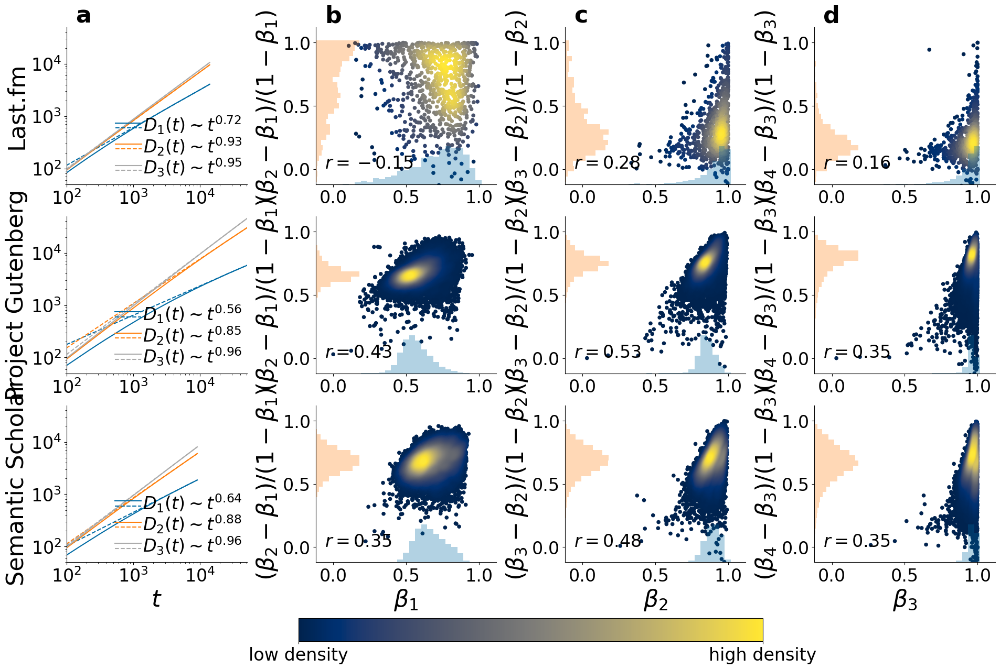

In [238]:
fig = fig_1_new2(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 5e1,
    min_beta = -0.1,
    max_beta = 1.1,
    min_beta_higher = -0.1,
    max_beta_higher = 1.1,
    use_same_x_y_max_lim = True,
    do_dashed_line = False,
    x_correlation_text = 0.05,
    y_correlation_text = 0.1,
    normalize = True,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new2_normalized.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res_new2_normalized.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new2_normalized.pdf"),format='pdf')

Last.fm
p-value pearson between None and $\beta_2 - \beta_1$ 9.146459496893713e-229
p-value pearson between None and $\beta_3 - \beta_2$ 5.081834702365511e-115
p-value pearson between None and $\beta_4 - \beta_3$ 5.569613417306869e-112
Project Gutenberg
p-value pearson between None and $\beta_2 - \beta_1$ 0.0
p-value pearson between None and $\beta_3 - \beta_2$ 0.0
p-value pearson between None and $\beta_4 - \beta_3$ 0.0
Semantic Scholar
p-value pearson between $\beta_1$ and $\beta_2 - \beta_1$ 0.0
p-value pearson between $\beta_2$ and $\beta_3 - \beta_2$ 0.0
p-value pearson between $\beta_3$ and $\beta_4 - \beta_3$ 0.0


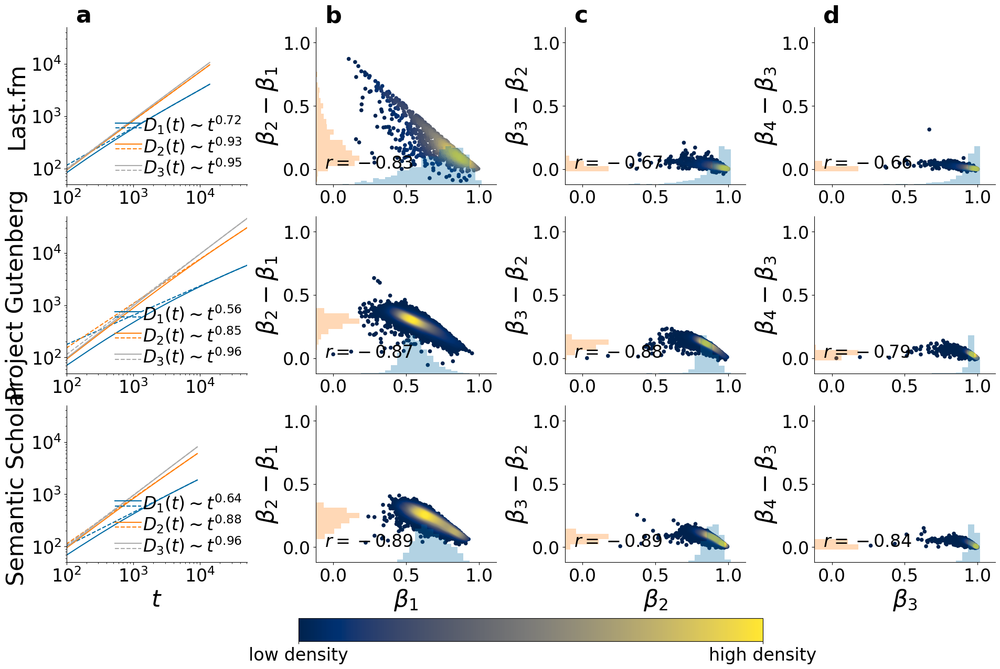

In [239]:
fig = fig_1_new2(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 5e1,
    min_beta = -0.1,
    max_beta = 1.1,
    min_beta_higher = -0.1,
    max_beta_higher = 1.1,
    use_same_x_y_max_lim = True,
    do_dashed_line = False,
    x_correlation_text = 0.05,
    y_correlation_text = 0.1,
    normalize = False,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new2_not_normalized.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res_new2_not_normalized.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new2_not_normalized.pdf"),format='pdf')

## Table SI: info heaps exponents

In [63]:
data_to_table = {
    'datasets' : [],
    'mean_beta' : [], 
    'std_beta' : [], 
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['mean_beta'].append(np.mean(dataset_dict[f'betas{order}']))
        data_to_table['std_beta'].append(np.std(dataset_dict[f'betas{order}']))
        data_to_table['min_betas'].append(np.min(dataset_dict[f'betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"mean" : data_to_table['mean_beta'],
    r"std" : data_to_table['std_beta'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} perc." : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} perc." : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} perc." : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} perc." : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas'],
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.4f", escape=False))

\begin{tabular}{cccccccccc}
\toprule
          Dataset ($\beta_n$) &   mean &    std &     min &  $1$\textsuperscript{st} perc. &  $25$\textsuperscript{th} perc. &  median &  $75$\textsuperscript{th} perc. &  $99$\textsuperscript{th} perc. &    max \\
\midrule
          Last.fm ($\beta_1$) & 0.7029 & 0.1797 &  0.1063 &                         0.2010 &                          0.5965 &  0.7395 &                          0.8436 &                          0.9761 & 0.9959 \\
          Last.fm ($\beta_2$) & 0.9048 & 0.1014 &  0.3342 &                         0.5725 &                          0.8699 &  0.9388 &                          0.9754 &                          0.9999 & 0.9999 \\
          Last.fm ($\beta_3$) & 0.9286 & 0.0862 &  0.3664 &                         0.6123 &                          0.9041 &  0.9583 &                          0.9861 &                          0.9999 & 1.0000 \\
          Last.fm ($\beta_4$) & 0.9411 & 0.0759 &  0.3837 &                         0.6643 &  

Last.fm
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 4.093214506247945e-06
p-value pearson between None and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 1.0455699429973347e-06
p-value pearson between None and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 1.231932312436595e-06
Project Gutenberg
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 2.8172965329696038e-33
Semantic Scholar
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 2.971801611616885e-242
p-value pearson between $\beta_1$ and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 1.945698409917331e-40


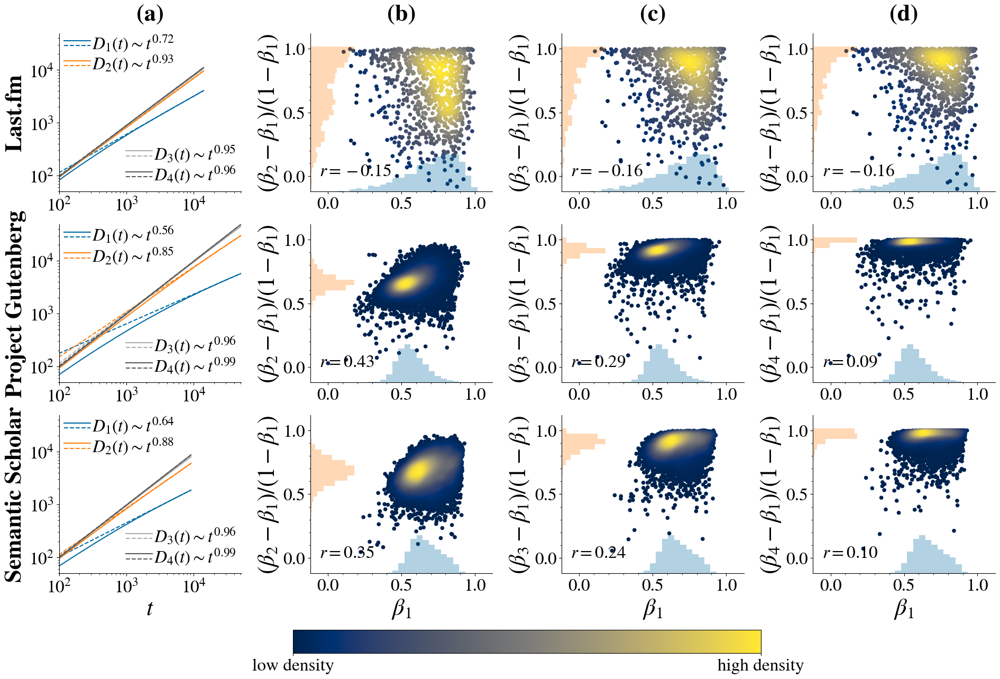

In [939]:
fig = fig_1_new(
    data, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 5e1,
    min_beta = -0.1,
    max_beta = 1.1,
    min_beta_higher = -0.1,
    max_beta_higher = 1.1,
    use_same_x_y_max_lim = True,
    do_dashed_line = False,
    x_correlation_text = 0.05,
    y_correlation_text = 0.1,
)

fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new.png"))
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_low_res_new.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig1_Heaps_datasets_new.pdf"),format='pdf')

In [64]:
data_to_table = {
    'datasets' : [],
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['min_betas'].append(np.min(dataset_dict[f'std_err_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'std_err_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'std_err_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} perc." : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} perc." : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} perc." : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} perc." : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas']
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.4f", escape=False))

\begin{tabular}{cccccccc}
\toprule
          Dataset ($\beta_n$) &    min &  $1$\textsuperscript{st} perc. &  $25$\textsuperscript{th} perc. &  median &  $75$\textsuperscript{th} perc. &  $99$\textsuperscript{th} perc. &    max \\
\midrule
          Last.fm ($\beta_1$) & 0.0007 &                         0.0016 &                          0.0052 &  0.0079 &                          0.0129 &                          0.0693 & 0.1988 \\
          Last.fm ($\beta_2$) & 0.0000 &                         0.0001 &                          0.0026 &  0.0047 &                          0.0091 &                          0.0510 & 0.1497 \\
          Last.fm ($\beta_3$) & 0.0000 &                         0.0000 &                          0.0019 &  0.0038 &                          0.0073 &                          0.0388 & 0.1366 \\
          Last.fm ($\beta_4$) & 0.0000 &                         0.0000 &                          0.0015 &  0.0031 &                          0.0064 &                     

### Average Heaps' exponent fits and standard error

(or standard deviation of its estimator)

For each, do min, 1st quartile, mean, 3rd quartile and max, for the last regression.

Compare with std of previous table

In [65]:
data_to_table = {
    'datasets' : [],
    'mean_value_beta' : [], 
    'std_value_beta' : [], 
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['mean_value_beta'].append(np.mean(dataset_dict[f'betas{order}']))
        data_to_table['std_value_beta'].append(np.std(dataset_dict[f'betas{order}']))
        data_to_table['min_betas'].append(np.min(dataset_dict[f'std_err_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'std_err_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'std_err_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'std_err_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"mean value" : data_to_table['mean_value_beta'],
    r"std value" : data_to_table['std_value_beta'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} perc." : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} perc." : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} perc." : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} perc." : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas'],
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.4f", escape=False))

\begin{tabular}{cccccccccc}
\toprule
          Dataset ($\beta_n$) &  mean value &  std value &    min &  $1$\textsuperscript{st} perc. &  $25$\textsuperscript{th} perc. &  median &  $75$\textsuperscript{th} perc. &  $99$\textsuperscript{th} perc. &    max \\
\midrule
          Last.fm ($\beta_1$) &      0.7029 &     0.1797 & 0.0007 &                         0.0016 &                          0.0052 &  0.0079 &                          0.0129 &                          0.0693 & 0.1988 \\
          Last.fm ($\beta_2$) &      0.9048 &     0.1014 & 0.0000 &                         0.0001 &                          0.0026 &  0.0047 &                          0.0091 &                          0.0510 & 0.1497 \\
          Last.fm ($\beta_3$) &      0.9286 &     0.0862 & 0.0000 &                         0.0000 &                          0.0019 &  0.0038 &                          0.0073 &                          0.0388 & 0.1366 \\
          Last.fm ($\beta_4$) &      0.9411 &     0.0759 & 0.0

### Repeat for t-values and p-values (safety check)

In [66]:
data_to_table = {
    'datasets' : [],
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['min_betas'].append(np.min(dataset_dict[f't_values_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f't_values_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f't_values_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f't_values_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} percentile" : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} percentile" : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} percentile" : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} percentile" : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas']
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.12f", escape=False))

\begin{tabular}{cccccccc}
\toprule
          Dataset ($\beta_n$) &             min &  $1$\textsuperscript{st} percentile &  $25$\textsuperscript{th} percentile &            median &  $75$\textsuperscript{th} percentile &  $99$\textsuperscript{th} percentile &                             max \\
\midrule
          Last.fm ($\beta_1$) &  5.326220648471 &                     19.313237622896 &                      69.078834646016 &  116.179885496063 &                     278.816724995955 &                    6446.215071571602 &              25460.161078702229 \\
          Last.fm ($\beta_2$) &  6.524946234118 &                     44.867339773862 &                     176.688264084273 &  478.168878113243 &                    2601.230651784433 &                   74428.846836042198 &             312359.616596910288 \\
          Last.fm ($\beta_3$) &  7.519964675021 &                     40.161934913262 &                     220.861246125754 &  604.919937700397 &                    3415.49879

In [67]:
data_to_table = {
    'datasets' : [],
    'min_betas' : [],
    'first_percentile_betas' : [],
    'first_quartile_betas' : [],
    'median_betas' : [],
    'third_quartile_betas' : [],
    'last_percentile_betas' : [],
    'max_betas' : [],
}

for dataset_label, dataset_dict in data.items():
    for i,order in enumerate(['', '2', '3', '4']):
        i += 1
        data_to_table['datasets'].append(fr"{dataset_label} ($\beta_{i}$)")
        data_to_table['min_betas'].append(np.min(dataset_dict[f'p_values_betas{order}']))
        data_to_table['first_percentile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 1))
        data_to_table['first_quartile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 25))
        data_to_table['median_betas'].append(np.median(dataset_dict[f'p_values_betas{order}']))
        data_to_table['third_quartile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 75))
        data_to_table['last_percentile_betas'].append(np.percentile(dataset_dict[f'p_values_betas{order}'], 99))
        data_to_table['max_betas'].append(np.max(dataset_dict[f'p_values_betas{order}']))

df = pd.DataFrame(data = {
    r'Dataset ($\beta_n$)' : data_to_table['datasets'],
    r"min" : data_to_table['min_betas'],
    r"$1$\textsuperscript{st} percentile" : data_to_table['first_percentile_betas'],
    r"$25$\textsuperscript{th} percentile" : data_to_table['first_quartile_betas'],
    r"median" : data_to_table['median_betas'],
    r"$75$\textsuperscript{th} percentile" : data_to_table['third_quartile_betas'],
    r"$99$\textsuperscript{th} percentile" : data_to_table['last_percentile_betas'],
    r"max" : data_to_table['max_betas']
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.12f", escape=False))

\begin{tabular}{cccccccc}
\toprule
          Dataset ($\beta_n$) &            min &  $1$\textsuperscript{st} percentile &  $25$\textsuperscript{th} percentile &         median &  $75$\textsuperscript{th} percentile &  $99$\textsuperscript{th} percentile &            max \\
\midrule
          Last.fm ($\beta_1$) & 0.000000000000 &                      0.000000000000 &                       0.000000000000 & 0.000000000000 &                       0.000000000000 &                       0.000000000000 & 0.000000638950 \\
          Last.fm ($\beta_2$) & 0.000000000000 &                      0.000000000000 &                       0.000000000000 & 0.000000000000 &                       0.000000000000 &                       0.000000000000 & 0.000000003004 \\
          Last.fm ($\beta_3$) & 0.000000000000 &                      0.000000000000 &                       0.000000000000 & 0.000000000000 &                       0.000000000000 &                       0.000000000000 & 0.000000000026 \\


## Figure SI: Distribution lengths

Last.fm	median:	13985.0
Project Gutenberg	median:	50726.0
Semantic Scholar	median:	9114.5


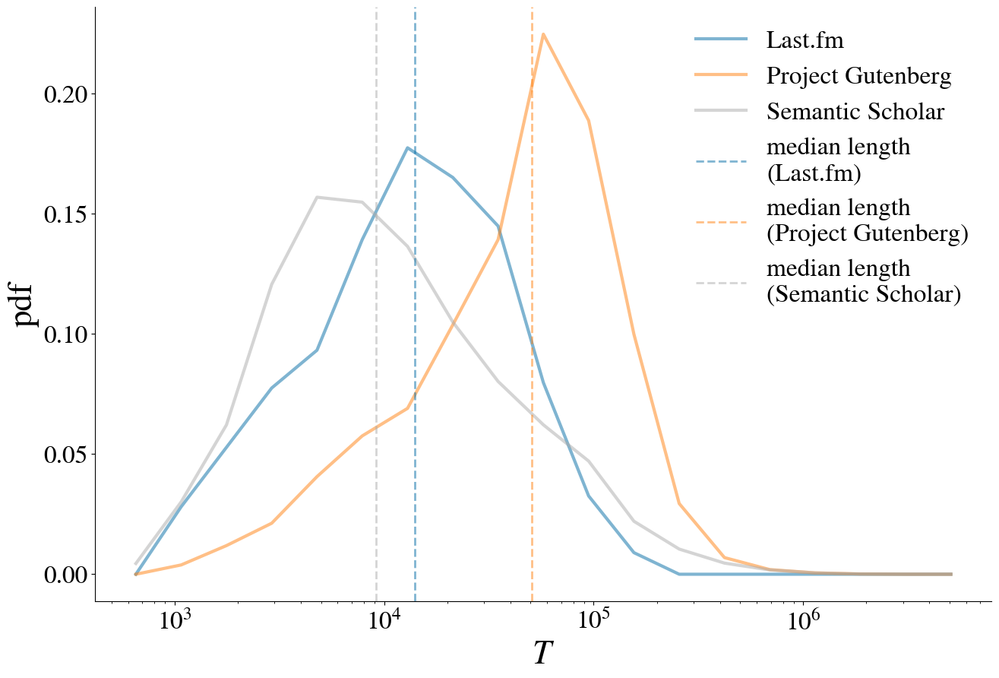

In [493]:
fig = plt.figure(figsize=(width_fig*2/3,width_fig*2/3*2/3))
ax = plt.gca()
minimum = min([min(dataset_dict['len']) for dataset_dict in data.values()])
maximum = max([max(dataset_dict['len']) for dataset_dict in data.values()])
num_bins = 20
colors = []
for dataset_label, dataset_dict in data.items():
    len_data = dataset_dict['len']
    hist,bin_edges = np.histogram(len_data, 
            np.geomspace(minimum, maximum+1, num_bins), 
            density=False)
    bin_centers = 10**((np.log10(bin_edges[1:])+np.log10(bin_edges[:-1]))/2)
    total = len(len_data)
    p = ax.plot(bin_centers, hist/total, label=dataset_label,alpha=0.5,lw=3)
    colors.append(p[0].get_color())

# ax.set_prop_cycle(None)
for i, (dataset_label, dataset_dict) in enumerate(data.items()):
    len_data = dataset_dict['len']
    ax.axvline(np.median(len_data), color=colors[i], ls= '--', lw=2, alpha=0.5, label='median length\n('+ dataset_label + ')')
    print(dataset_label, "median:", np.median(len_data), sep="\t")

ax.legend()
ax.set_xlabel(r"$T$")
ax.set_ylabel(r"pdf")
ax.set_xscale("log")

fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_length_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_length_datasets.pdf"),format='pdf')

## Figure SI: Heaps on seq. of labels

In [69]:
min_beta_labels = min([min(_['betas']) for _ in data_labels.values()])
max_beta_labels = max([max(_['betas']) for _ in data_labels.values()])

min_beta_higher_labels = min([min(list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
max_beta_higher_labels = max([max(list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])

min_beta_labels, max_beta_labels, min_beta_higher_labels, max_beta_higher_labels

(-1.3748081562070524e-09,
 0.9503719989766061,
 0.03043417692512353,
 0.9999537137863118)

In [70]:
min_beta_labels = min_beta_higher_labels = min(min_beta_labels, min_beta_higher_labels)
max_beta_labels = max_beta_higher_labels = max(max_beta_labels, max_beta_higher_labels)

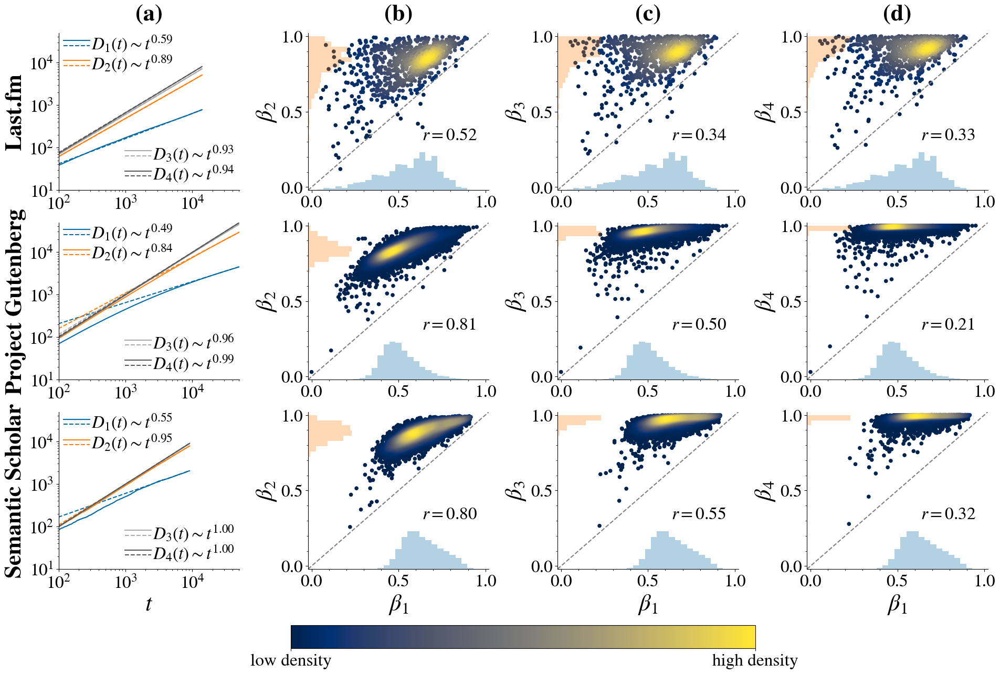

In [71]:
fig = fig_1(
    data_labels, 
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e1,
    min_beta = min_beta_labels,
    max_beta = max_beta_labels,
    min_beta_higher = min_beta_higher_labels,
    max_beta_higher = max_beta_higher_labels,
)

fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_datasets_labels.png"))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_datasets_labels_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_datasets_labels.pdf"),format='pdf')

## Figure SI: Distribution of exponents compared

In [138]:
data.keys()

dict_keys(['Last.fm', 'Project Gutenberg', 'Semantic Scholar'])

In [139]:
minimum_1 = min([min(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
maximum_1 = max([max(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
minimum_1, maximum_1

(-1.3748081562070524e-09, 0.9999537137863118)

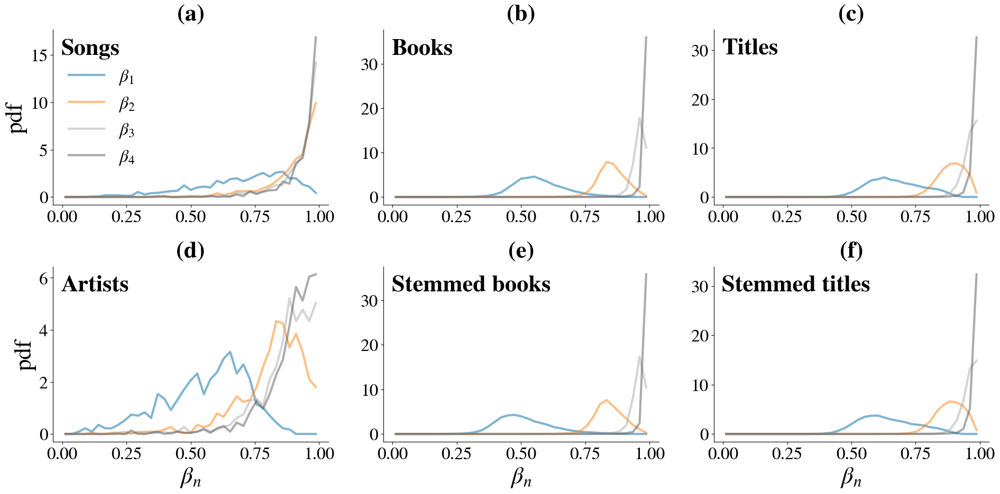

In [80]:
num_datasets = len(data)
fig = plt.figure(figsize=(width_fig*num_datasets/3,width_fig*2/3*2/3))
outer = gridspec.GridSpec(nrows=2, ncols=num_datasets,width_ratios = [10]*num_datasets, hspace=0.35, wspace=0.2)

minimum_0 = min([min(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data.values()])
maximum_0 = max([max(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data.values()])
minimum_1 = min([min(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
maximum_1 = max([max(list(_['betas']) + list(_['betas2']) + list(_['betas3']) + list(_['betas4'])) for _ in data_labels.values()])
minimum = min([minimum_0,minimum_1])
maximum = max([maximum_0,maximum_1])
num_bins = 40
letters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'.lower()

first_row_labels = {'Last.fm': 'Songs', 'Project Gutenberg': 'Books', 'Semantic Scholar': 'Titles'}
second_row_labels = {'Last.fm': 'Artists', 'Project Gutenberg': 'Stemmed books', 'Semantic Scholar': 'Stemmed titles'}
for i, (dataset_label, dataset_dict) in enumerate(data.items()):
    colors = []
    legend_labels = []
    ax = plt.Subplot(fig, outer[0,i])
    for order,key in enumerate(['betas', 'betas2', 'betas3', 'betas4']):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(minimum, maximum, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1))
    ax.text(0.03, 0.95, first_row_labels[dataset_label], transform=ax.transAxes, fontweight='bold', horizontalalignment='left', verticalalignment='top')
    if i == 0:
        ax.legend(loc='center left')
        ax.set_ylabel('pdf')
    ax.text(0.5, 1.05, f"({letters[i]})", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    fig.add_subplot(ax)

    
for i, (dataset_label, dataset_dict) in enumerate(data_labels.items()):
    colors = []
    legend_labels = []
    ax = plt.Subplot(fig, outer[1,i])
    for order,key in enumerate(['betas', 'betas2', 'betas3', 'betas4']):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(minimum, maximum, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1))
    ax.text(0.03, 0.95, second_row_labels[dataset_label], transform=ax.transAxes, fontweight='bold', horizontalalignment='left', verticalalignment='top')
    ax.set_xlabel(r"$\beta_n$")
    if i == 0:
#         ax.legend(labelspacing=0.1)
        ax.set_ylabel('pdf')
    ax.text(0.5, 1.05, f"({letters[i+len(data)]})", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    fig.add_subplot(ax)

fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_beta_datasets.png"))
fig.savefig(os.path.join(figures_folder, f"FigSI_distribution_beta_datasets.pdf"),format='pdf')

# Figure: Clustering (Entropy) in DATA

## Load data with entropy

In [15]:
with gzip.open('./data/essential_entropy_data_for_figure.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

## Create data with entropy

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

In [802]:
data_with_entropy = {}
data_with_entropy['Last.fm'] = {}
data_with_entropy['Project Gutenberg'] = {}
data_with_entropy['Semantic Scholar'] = {}

### Last.fm

In [803]:
data_folder = "./data/ocelma-dataset/lastfm-dataset-1K/"
analysis_folder = data_folder

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
    try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
            result = joblib.load(fp)
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
    except:
        pass
print(count)
data_with_entropy['Last.fm'] = dataset.copy()

  0%|          | 0/890 [00:00<?, ?it/s]

890


### Gutenberg

In [804]:
data_folder = './data/gutenberg/data_processed/'
analysis_folder = './data/gutenberg/analysis/'

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
#     try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
#         with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
#             result = joblib.load(fp)
        result = results_light_individual_gutenberg[file_name]
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
#     except:
#         pass
print(count)
data_with_entropy['Project Gutenberg'] = dataset.copy()

  0%|          | 0/19637 [00:00<?, ?it/s]

19637


### Semantic Scholar

In [38]:
corpus_version = '2022-01-01'
data_folder = os.path.join('./data/semanticscholar/data/', corpus_version) # where you save the data
analysis_folder = os.path.join('./data/semanticscholar/analysis/', corpus_version)
with open(os.path.join(data_folder,'all_fieldsOfStudy.tsv'), 'r', newline='\n') as fp:
    tsv_output = csv.reader(fp, delimiter='\n')
    all_fieldsOfStudy = [] 
    for _ in tsv_output:
        all_fieldsOfStudy.append(_[0])

dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_journals = 1000
for fieldOfStudy in tqdm(all_fieldsOfStudy):
    paths = sorted(find_pattern('*.pkl', os.path.join(analysis_folder, 'journals_fieldsOfStudy_entropy',fieldOfStudy)))
    if len(paths) != num_journals:
        print(f'Error! Found {len(paths)} journals for {fieldOfStudy} instead of {num_journals}')
#         break

    for path in tqdm(paths):
        try:
            file_name = path[-path[::-1].index('/'):path.index('.pkl')]
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            try:
                os.rename(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}.pkl'), os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'))
            except:
                pass
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
            result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
            result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy, f'{file_name}_light.pkl'), 'wb') as fp:
                pickle.dump(result,fp)
            count += 1
        except:
            pass
print(count)
data_with_entropy['Semantic Scholar'] = dataset.copy()

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

19000


### Dump data

In [39]:
for key,val in data_with_entropy.items():
    print(key,len(val['betas']))

Last.fm 890
Project Gutenberg 19637
Semantic Scholar 19000


In [40]:
with gzip.open('./data/essential_entropy_data_for_figure.pkl.gz', "wb") as fp:
    joblib.dump(data_with_entropy, fp)
print('Dumped')

Dumped


## Functions

In [14]:
def fig_2_subplot_a(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    do_legend = True,
                    num_bins = 35,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    # color cycle
    colors_old = plt.rcParams['axes.prop_cycle'].by_key()['color']
    colors = colors_old.copy()
    colors[0] = colors_old[2]
    colors[1] = colors_old[0]
    colors[2] = colors_old[1]
    markers = ['s', 'o', 'd']
    
    
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    x = [freq  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y = [value  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker=markers[0], rasterized = True, facecolors='none', edgecolor=colors[0], #next(cycler)['color'], 
        linewidth=1.5, label=r"$\tilde{S}(f)$", alpha=alpha, s=marker_size, )
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
        ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker=markers[n_order], rasterized = True, facecolors='none', edgecolor=colors[n_order], #next(cycler)['color'], 
            linewidth=1.5, label=r'$S_%d(f)$'%n_order, alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
    
    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    
    if do_legend == True:
        leg = ax.legend(handletextpad=0.1, loc="lower right", labelspacing = 0) # , bbox_to_anchor=(1.06,-0.06), loc="lower right"
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
#         ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 
        ax.set_title(dataset_label,verticalalignment='center',horizontalalignment='center', transform=ax.transAxes)  # ,fontweight='bold'

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.05, 1, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [26]:
def fig_2_subplot_b(dataset_dict, 
                    ax = None, alpha = 0.5, 
                    number_to_write = 0, 
                    num_bins = 35,
                    xlim_left = -0.1, xlim_right = 0.6, 
                    xlabel = r"$\langle \Delta S_n \rangle$", 
                    ylabel = r"pdf", 
                    do_legend = True,
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    
    if xlim_left == None:
        xlim_left = 1000000
        for n_order,key in enumerate(['weighted_diff_entropies', 'weighted_diff_entropies_pairs'], start = 1):
            xlim_left = min(xlim_left, min(dataset_dict[key]))
    if xlim_right == None:
        xlim_right = -10000
        for n_order,key in enumerate(['weighted_diff_entropies', 'weighted_diff_entropies_pairs'], start = 1):
            xlim_right = max(xlim_right, max(dataset_dict[key]))

    for n_order,key in enumerate(['weighted_diff_entropies', 'weighted_diff_entropies_pairs'], start = 1):
        data_to_hist = dataset_dict[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(xlim_left, xlim_right, num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\langle \Delta S_{%d} \rangle$"%(n_order))
    
    # Impose xticks
    ax.set_xticks(np.arange(-10,10.0000001,0.1), minor=True)
    ax.set_xticks(np.arange(-10,10.0000001,0.2), minor=False)
    
    ax.set_xlim(left = xlim_left, right = xlim_right)
    
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)

    if do_legend == True:
        leg = ax.legend(handletextpad=0.1, loc="upper left", labelspacing = 0.1) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)

    if write_number == True:
        ax.text(0.05, 1.0, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='left', verticalalignment='bottom')
    return ax

In [16]:
def fig_2(data, marker_size = 20, alpha_scatter = 1, 
          num_bins = 35,
          min_x_a = None,
          max_x_a = None,
          min_x_b = None,
          max_x_b = None,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    nrows = 2
    ncols = num_datasets
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*nrows/3))
    wspace = 0.3
    hspace = 0.4
    outer = gridspec.GridSpec(nrows=nrows, ncols=ncols,wspace=wspace,hspace=hspace)
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        max_x_a = 1
        min_x_b = 1
        max_x_b = 0
        for dataset_label, dataset_dict in data.items():
            x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in dataset_dict[f"mean_entropies"].items() for value in values]
            max_x_a = max(max_x_a, max(x))
            x = dataset_dict[f"weighted_diff_entropies"]
            min_x_b = min(min_x_b, min(x))
            max_x_b = max(max_x_b, max(x))
            x = dataset_dict[f"weighted_diff_entropies_pairs"]
            min_x_b = min(min_x_b, min(x))
            max_x_b = max(max_x_b, max(x))
    
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = 0
        ax = plt.Subplot(fig, outer[row*ncols+column])
        fig_2_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = '\n'.join(dataset_label.split(' ')),
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        num_bins = num_bins,
                        do_legend = column == 0,
                        xlim_left = min_x_a, xlim_right = max_x_a, 
                        ylim_bottom = 0, ylim_top = 1, 
                        xlabel = r"$f$", write_number = True,
                        ylabel = r"Shannon entropy" if column == 0 else None, 
                       )
        fig.add_subplot(ax)
        
        row = 1
        ax = plt.Subplot(fig, outer[row*ncols+column])
        fig_2_subplot_b(dataset_dict,
                          ax = ax, 
                          num_bins = num_bins,
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          do_legend = column == 0,
                          xlabel = r"$\langle \Delta S_n \rangle$", 
                          ylabel = r"pdf" if column == 0 else None, 
                          xlim_left=min_x_b, xlim_right=max_x_b, 
                         )
        fig.add_subplot(ax)
    
    return fig

## Figure

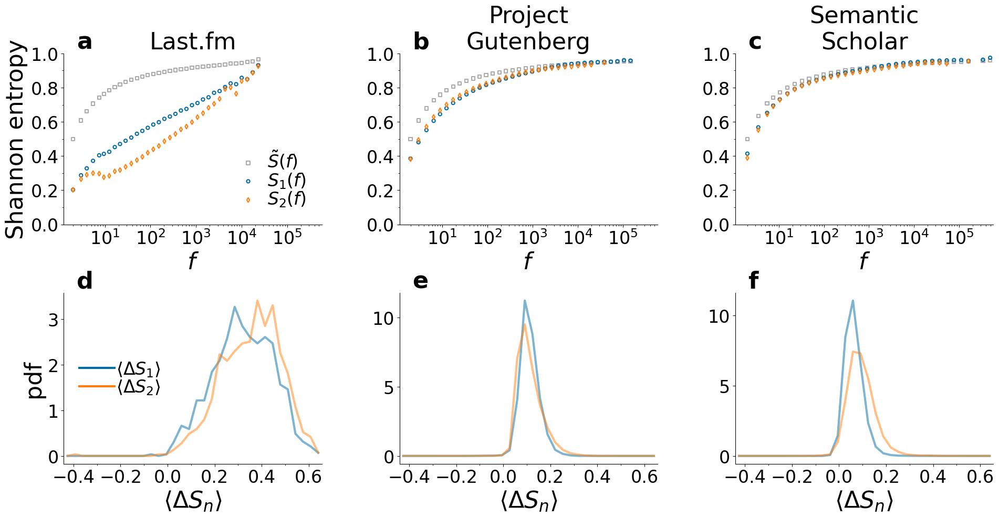

In [128]:
fig = fig_2(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
          num_bins = 35,
          min_x_a = None,
          max_x_a = None,
          min_x_b = None,
          max_x_b = None,
          use_same_x_y_max_lim = True,
         )
fig.savefig(os.path.join(figures_folder, f"Fig2_entropy_beta.png"))
fig.savefig(os.path.join(figures_folder, f"Fig2_entropy_low_res_beta.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig2_entropy_beta.pdf"))

p-value pearson between None and $\langle\Delta S \rangle$ 2.4556612484583385e-06
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.0797027291466465e-131
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 8.185399436005836e-218
p-value pearson between None and $\langle\Delta S_2 \rangle$ 1.3305214081438763e-301
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 2.2839264783179714e-210
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 1.6221697216721574e-23


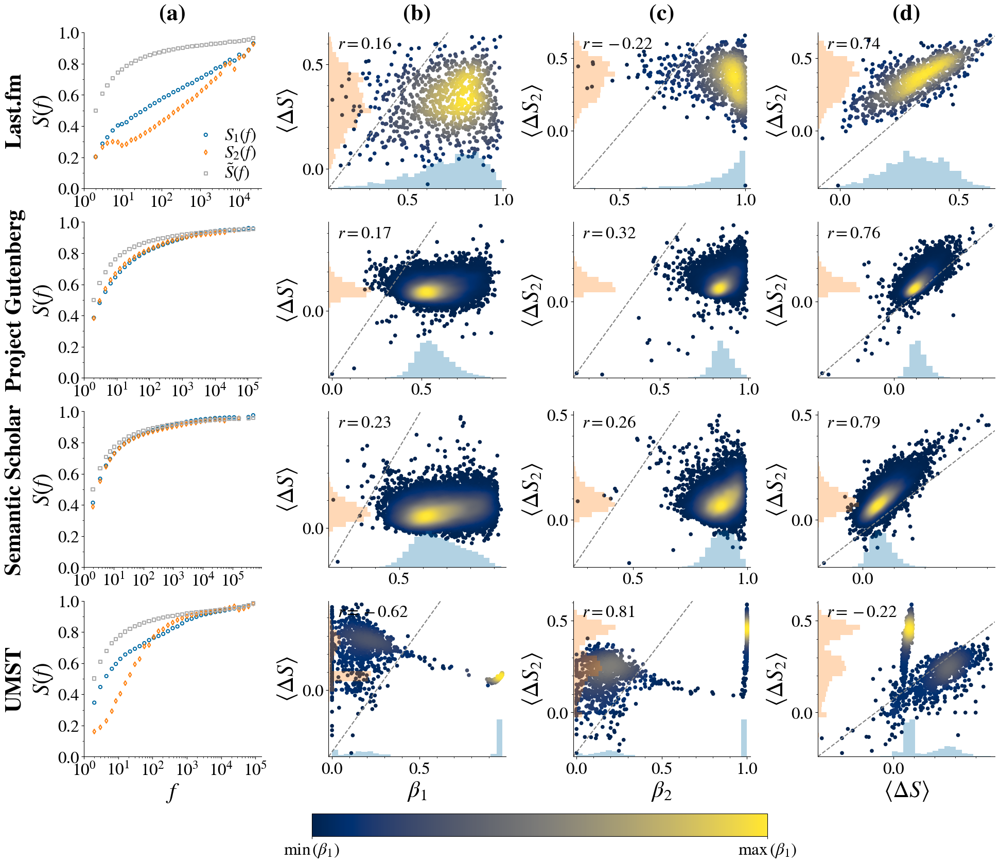

In [947]:
fig = fig_4(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

# Figure: Higher order in MODEL simulations

## Load data simulations

In [8]:
model_data_with_entropy = {}

In [9]:
def get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True):
    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/UMST/simulations/analysis/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
            try:
                try:
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                except:
                    path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    print('FOUND ',count, sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)
    
    return dataset

In [12]:
def get_data_ERRW(do_fig = True):
    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0
    
    light_folder = f"./data/ERRW/new_SW/analysis/light_results/"
    entropies_folder = f"./data/ERRW/new_SW/analysis/entropies_results/"
    filepaths = sorted(find_pattern('*.pkl', light_folder))
    for path in tqdm(filepaths):
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        try:
            with open(os.path.join(entropies_folder, f'{file_name}.pkl'), 'rb') as fp:
                entropy_result = joblib.load(fp)
            with open(os.path.join(light_folder, f'{file_name}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass
    print('FOUND ',count, sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(r'ERRW SW')
        fig.add_subplot(ax)
    
    return dataset

### UMT eta 1 rho 20

  0%|          | 0/12 [00:00<?, ?it/s]

FOUND 	1200


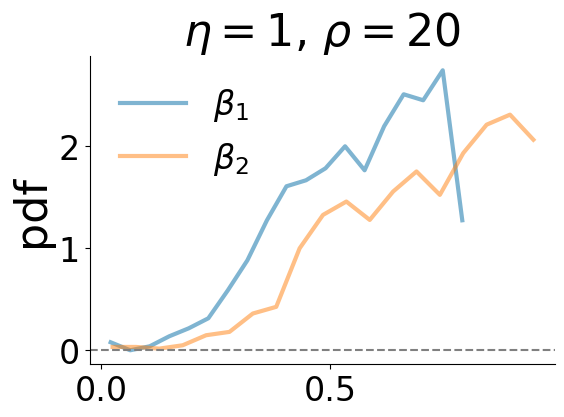

In [186]:
Tmax = int(1e5)
eta = 1
rho = 20
starting_nu = 8
ending_nu = 19

model_data_with_entropy[r"UMT($\eta=%s)$"%(str(eta))] = get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True)

### UMST eta 0.5 rho 20

  0%|          | 0/6 [00:00<?, ?it/s]

FOUND 	600


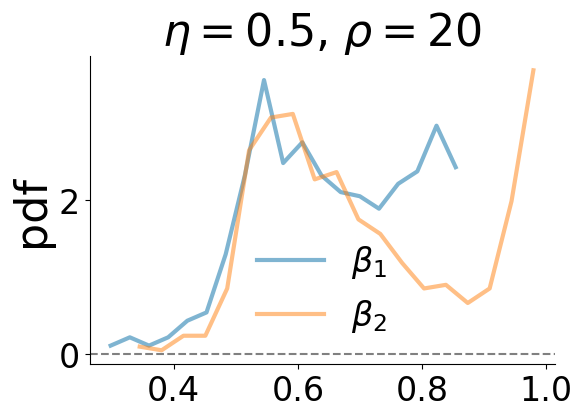

In [188]:
Tmax = int(1e5)
eta = 0.5
rho = 20
starting_nu = 20
ending_nu = 25 #min(20, int(rho/eta))

model_data_with_entropy[r"UMST($\eta=%s)$"%(str(eta))] = get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True)

### UMST eta 0.1 rho 4

  0%|          | 0/12 [00:00<?, ?it/s]

FOUND 	1200


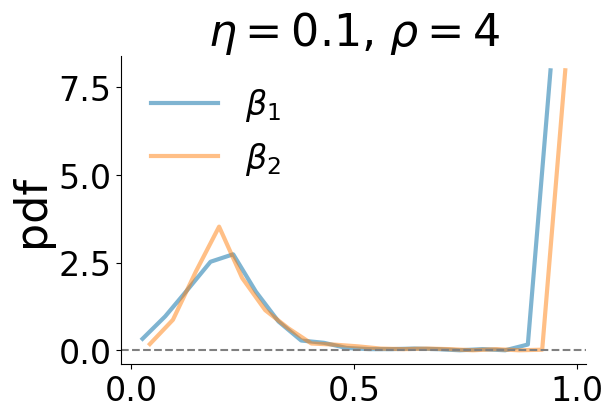

In [189]:
Tmax = int(1e5)
eta = 0.1
rho = 4
starting_nu = 4
ending_nu = 15 #min(20, int(rho/eta))

model_data_with_entropy[r"UMST($\eta=%s)$"%(str(eta))] = get_data_UMST(eta, rho, starting_nu, ending_nu,do_fig = True)

### ERRW on SW

  0%|          | 0/150 [00:00<?, ?it/s]

FOUND 	150


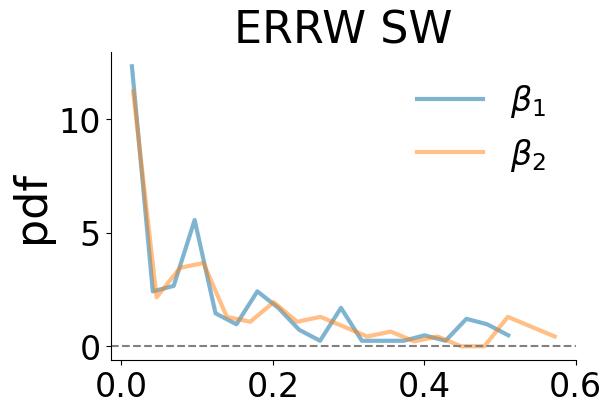

In [11]:
model_data_with_entropy[r"ERRW(SW)"] = get_data_ERRW(do_fig = True)

#### new

  0%|          | 0/120 [00:00<?, ?it/s]

FOUND 	120


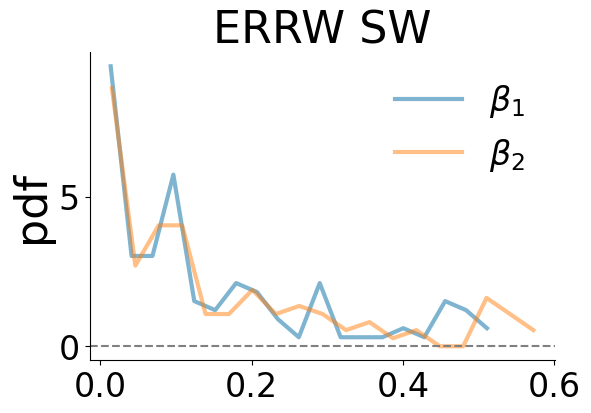

In [13]:
model_data_with_entropy[r"ERRW(new)"] = get_data_ERRW(do_fig = True)

## Functions

In [201]:
# model_data_with_entropy_old = model_data_with_entropy.copy()
# model_data_with_entropy = {}
model_data_with_entropy[r"UMT($\eta=%s)$"%(str(1))] = model_data_with_entropy_old[r"UMT $\eta=%s,\rho=%s$"%(str(1), str(20))]
model_data_with_entropy[r"UMST($\eta=%s)$"%(str(0.5))] = model_data_with_entropy_old[r"UMST $\eta=%s,\rho=%s$"%(str(0.5), str(20))]
model_data_with_entropy[r"UMST($\eta=%s)$"%(str(0.1))] = model_data_with_entropy_old[r"UMST $\eta=%s,\rho=%s$"%(str(0.1), str(4))]
model_data_with_entropy[r"ERRW(SW)"] = model_data_with_entropy_old[r"ERRW SW"]

In [17]:
def fig_3(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
          min_x_a = None,
          max_x_a = None,
          min_y_a = None,
          max_y_a = None,
          use_same_x_y_max_lim = True,
          do_dashed_line = True,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
          num_bins = 35,
          min_x_b = None,
          max_x_b = None,
          min_x_c = None,
          max_x_c = None,
         ):
    nrows = num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios = [1]+[10], wspace=0.1) # 0.25
    wspace = 0.38
    hspace = 0.38
    ncols = 3
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        min_x_a = 100000
        max_x_a = -100000
        min_y_a = 100000
        max_y_a = -100000
        max_x_b = 1
        min_x_c = 100000
        max_x_c = -100000
        for dataset_label, dataset_dict in data.items():
            x = dataset_dict[f"betas"]
            min_x_a = min(min_x_a, min(x))
            max_x_a = max(max_x_a, max(x))
            y = dataset_dict[f"betas2"]
            min_y_a = min(min_y_a, min(y))
            max_y_a = max(max_y_a, max(y))
            x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in dataset_dict[f"mean_entropies"].items() for value in values]
            max_x_b = max(max_x_b, max(x))
            x = dataset_dict[f"weighted_diff_entropies"]
            min_x_c = min(min_x_c, min(x))
            max_x_c = max(max_x_c, max(x))
            x = dataset_dict[f"weighted_diff_entropies_pairs"]
            min_x_c = min(min_x_c, min(x))
            max_x_c = max(max_x_c, max(x))
    
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[-1],wspace=wspace,hspace=hspace)
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = i
        print(dataset_label)
        ax = plt.Subplot(fig, inner[i*ncols])
        i_order = 1
        n_order = 2
        order = str(n_order)
        fig_1_subplot_b_d(np.array(dataset_dict['betas']), np.array(dataset_dict[f'betas{order}']), 
                          ax = ax, 
                          marker_size = 20, alpha_scatter = alpha_scatter,
                          alpha_histogram = alpha_histogram, 
                          color_x = color_x, color_y = color_y, 
                          max_hist = max_hist, 
                          number_to_write = i*ncols, 
                          write_number = True, #i==0, 
                          do_dashed_line = do_dashed_line,
                          ylabel = fr"$\beta_{order}$", xlabel = r"$\beta_1$" if i == num_datasets - 1 else None, 
                          min_x=min_x_a, max_x=max_x_a, min_y=min_y_a, max_y=max_y_a,
                          x_correlation_text = x_correlation_text, 
                          y_correlation_text = y_correlation_text,
                         )
        fig.add_subplot(ax)
    
        # ENTROPY
    
        column = 1
        ax = plt.Subplot(fig, inner[row*ncols+column])
        fig_2_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = '\n'.join(dataset_label.split(' ')),
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        num_bins = num_bins,
                        xlim_left = min_x_b, xlim_right = max_x_b, 
                        ylim_bottom = 0, ylim_top = 1, 
                        do_legend = row == 0,
                        xlabel = r"$f$" if row == nrows-1 else None, write_number = True,
                        ylabel = r"S(f)", 
                       )
        fig.add_subplot(ax)

        column = 2
        ax = plt.Subplot(fig, inner[row*ncols+column])
        fig_2_subplot_b(dataset_dict,
                          ax = ax, 
                          num_bins = num_bins,
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          do_legend = row == 0,
                          xlabel = r"$\langle \Delta S_n \rangle$" if row == nrows-1 else None, 
                          ylabel = r"pdf", 
                          xlim_left=min_x_c, xlim_right=max_x_c, 
                         )
        fig.add_subplot(ax)
        
        
    ####################### COLORBAR #######################
    
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[0])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    cb.ax.get_yaxis().set_ticks([0,1]) 
    cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figures

UMT($\eta=1)$
p-value pearson between None and $\beta_2$ 0.0
UMST($\eta=0.5)$
p-value pearson between None and $\beta_2$ 0.0
UMST($\eta=0.1)$
p-value pearson between None and $\beta_2$ 0.0
ERRW(SW)
p-value pearson between $\beta_1$ and $\beta_2$ 4.290843985355006e-161


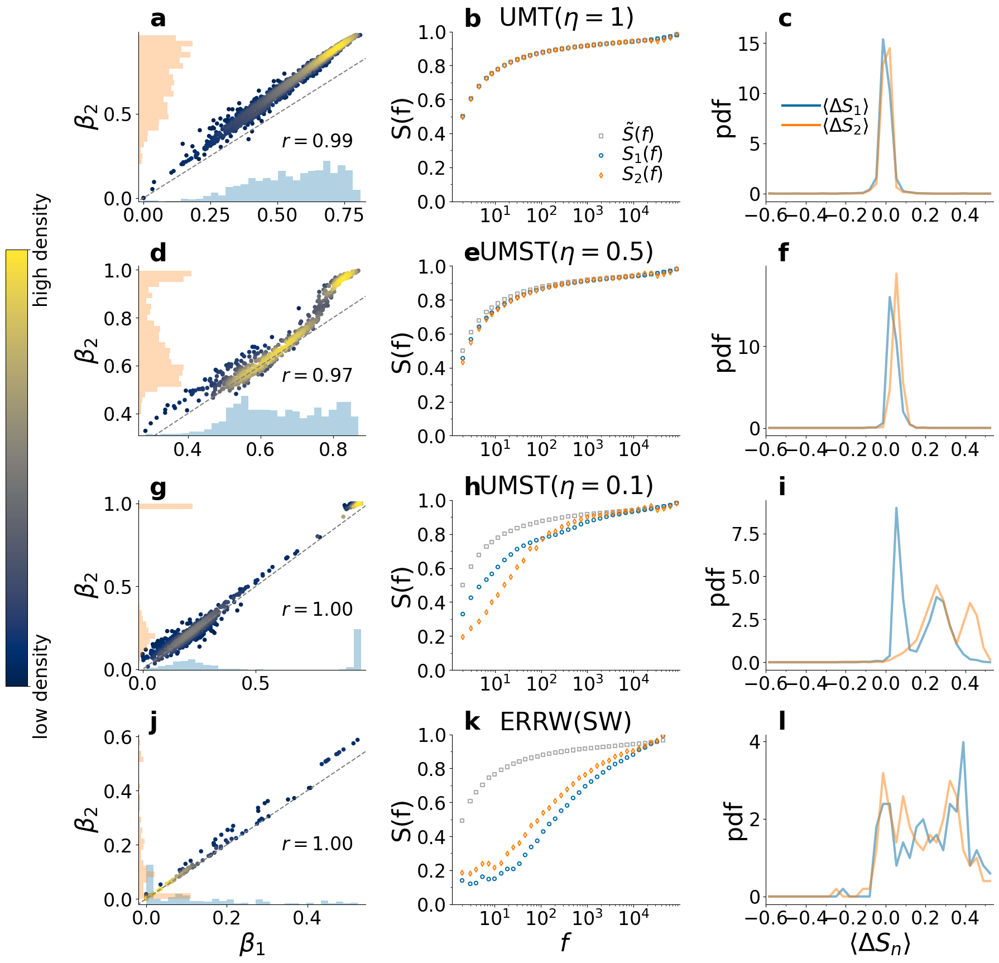

In [207]:
fig = fig_3(
    model_data_with_entropy, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_a = None,
    max_x_a = None,
    min_y_a = None,
    max_y_a = None,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_b = None,
    max_x_b = None,
#                                         min_x_c = -0.1,
#                                         max_x_c = 0.3,
)


fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations.pdf"),format='pdf')

ERRW(SW)
p-value pearson between None and $\beta_2$ 4.290843985355006e-161
ERRW(new)
p-value pearson between $\beta_1$ and $\beta_2$ 3.4119060926368382e-130


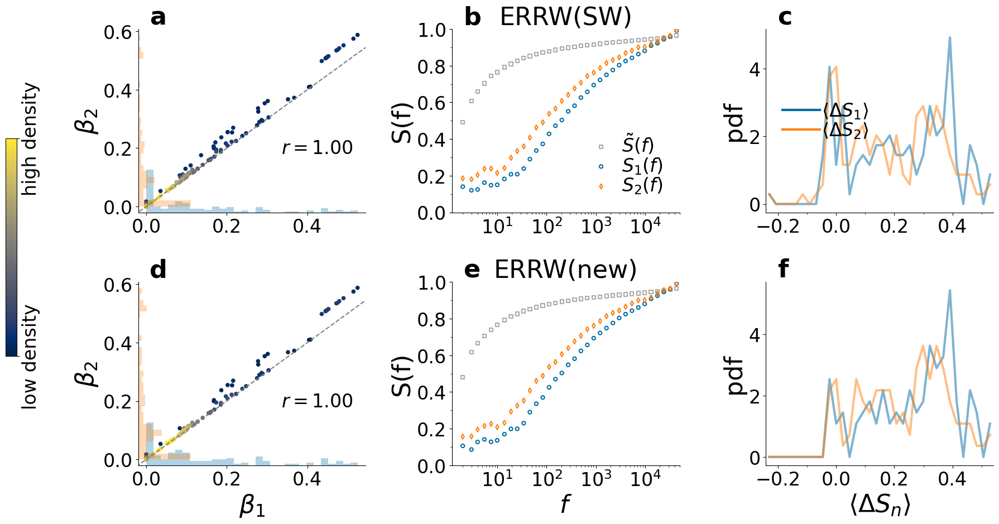

In [25]:
fig = fig_3(
    model_data_with_entropy, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_a = None,
    max_x_a = None,
    min_y_a = None,
    max_y_a = None,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_b = None,
    max_x_b = None,
#                                         min_x_c = -0.1,
#                                         max_x_c = 0.3,
)


fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations.pdf"),format='pdf')

### Distinguish ERRW parameters

In [83]:
def get_data_ERRW(
    p=None,dw=None,min_dw = None, max_dw = None, do_fig = True, 
    use_mean_indices = False,
    consider_temporal_order_in_tuples = True,
    label_title_fig = None,
):
    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0
    
    if consider_temporal_order_in_tuples:
        light_folder = f"./data/ERRW/SW/analysis/light_results/"
        entropies_folder = f"./data/ERRW/SW/analysis/entropies_results/"
    else:
        light_folder = f"./data/ERRW/SW/analysis_tuples_without_order/light_results/"
        entropies_folder = f"./data/ERRW/SW/analysis_tuples_without_order/entropies_results/"
    pattern = '*'
    if p is not None:
        pattern += f'p{p:.3f}*'
    if dw is not None:
        pattern += f'dw{dw:.5f}*' # f'dw{dw:.2f}*'
    filepaths = sorted(find_pattern(pattern+'.pkl', light_folder))
    for path in tqdm(filepaths):
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        dw = float(file_name[-file_name[::-1].index('wd_'):file_name.index('_sim')])
        if (min_dw is None or min_dw is not None and dw >= min_dw) and (max_dw is None or max_dw is not None and dw <= max_dw):
            try:
                with open(os.path.join(entropies_folder, f'{file_name}.pkl'), 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(light_folder, f'{file_name}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
    #                 dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    if use_mean_indices:
                        dataset[f'betas{order}'].append(result[f'beta{order}_mean_indices'][-1]) # _mean_indices # _loglogregr_indices_geom
                    else:
                        dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1]) # _mean_indices # _loglogregr_indices_geom
                        dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    print('FOUND ',count, len(dataset[f'betas']),sep = "\t")
    if count > 0 and do_fig == True:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(label_title_fig)#(fr'ERRW SW ($p={str(p)},dw={str(dw)}$)')
        fig.add_subplot(ax)
    
    return dataset

In [84]:
ERRW_model_data_with_entropy = {}

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

FOUND 	50	50


  0%|          | 0/30 [00:00<?, ?it/s]

FOUND 	30	30


  0%|          | 0/30 [00:00<?, ?it/s]

FOUND 	30	30


  0%|          | 0/50 [00:00<?, ?it/s]

FOUND 	50	50


  0%|          | 0/30 [00:00<?, ?it/s]

FOUND 	30	30


  0%|          | 0/30 [00:00<?, ?it/s]

FOUND 	30	30


  0%|          | 0/50 [00:00<?, ?it/s]

FOUND 	50	50


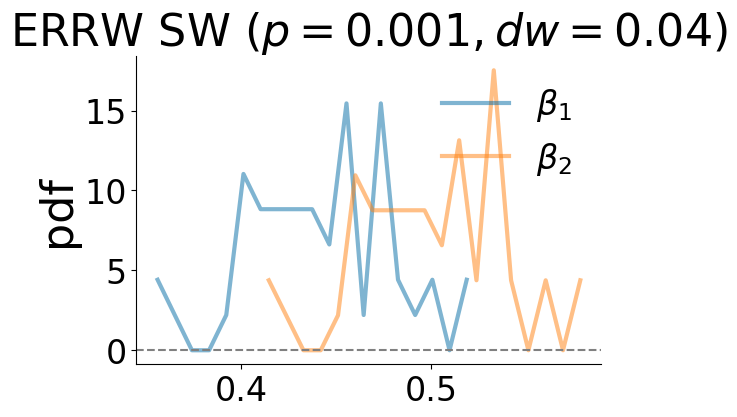

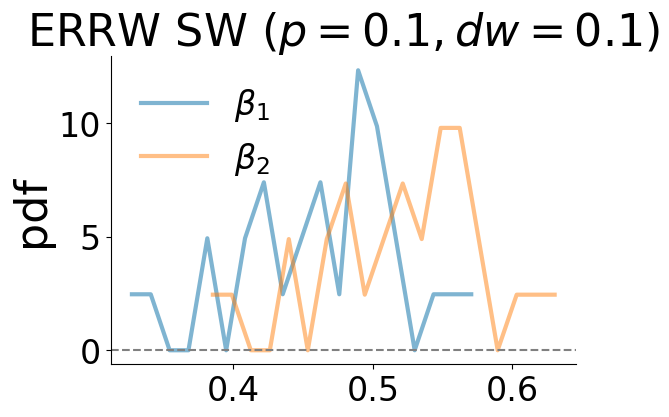

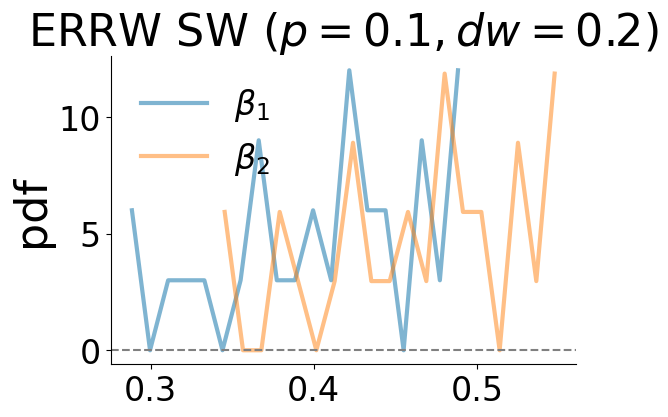

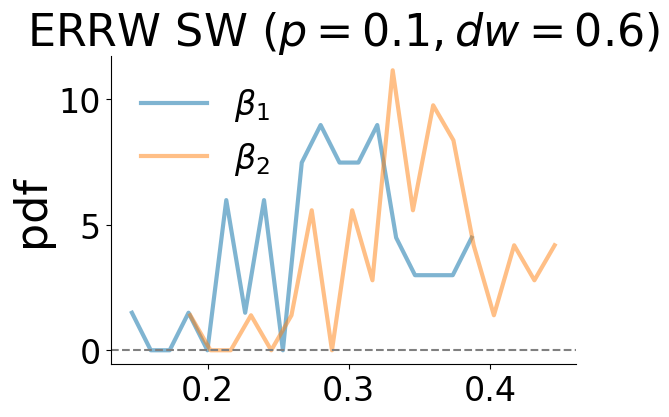

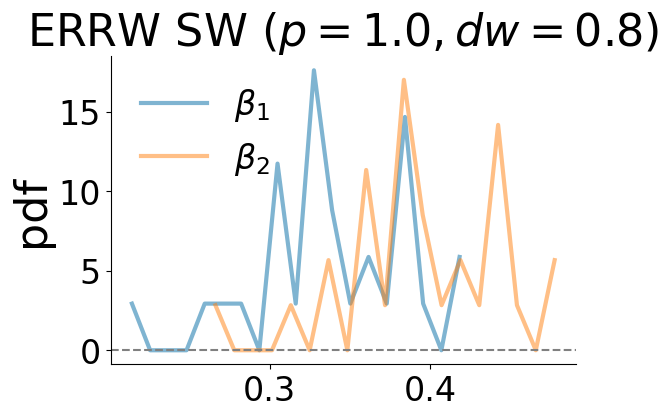

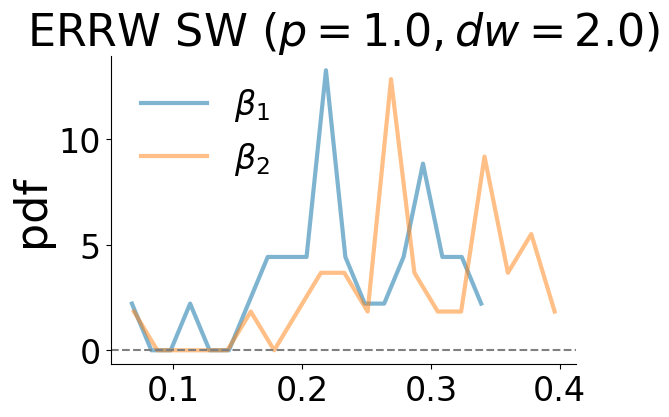

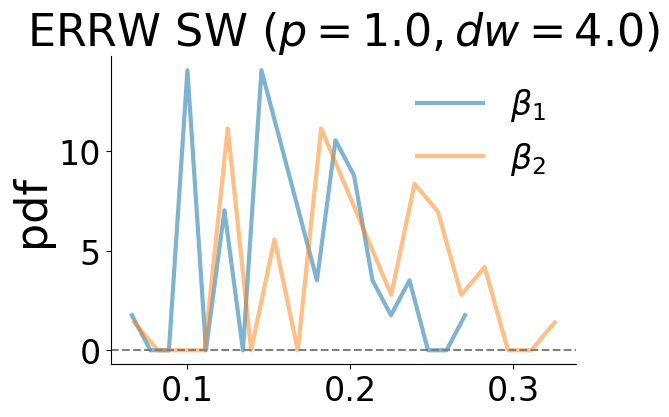

In [78]:
for p, dw in tqdm([(0.001, 0.04),(0.100, 0.10),(0.100, 0.20),(0.100, 0.60),(1.000, 0.80),(1.000, 2.00),(1.000, 4.00)]):
    ERRW_model_data_with_entropy[fr"$p={str(p)},dw={str(dw)}$"] = get_data_ERRW(p,dw,do_fig = True)

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/250 [00:00<?, ?it/s]

FOUND 	125	125


  0%|          | 0/250 [00:00<?, ?it/s]

FOUND 	125	125


  0%|          | 0/250 [00:00<?, ?it/s]

FOUND 	125	125


  0%|          | 0/250 [00:00<?, ?it/s]

FOUND 	125	125


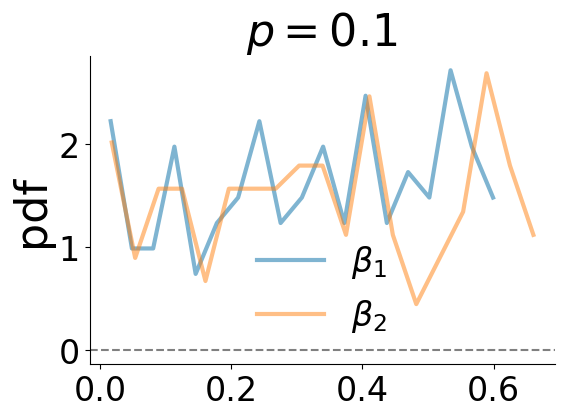

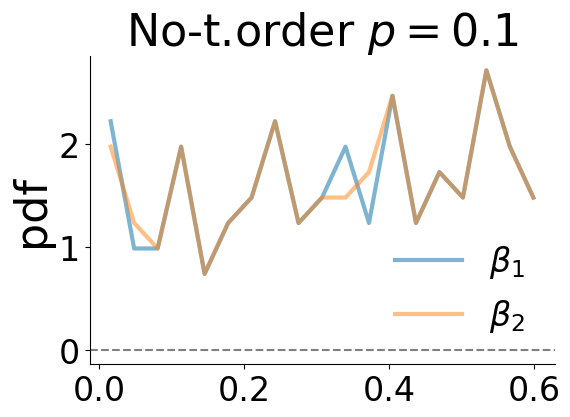

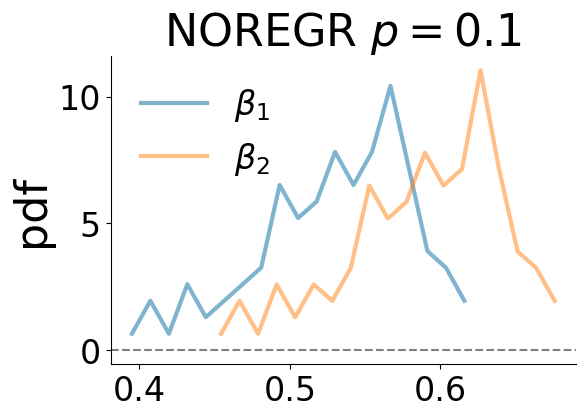

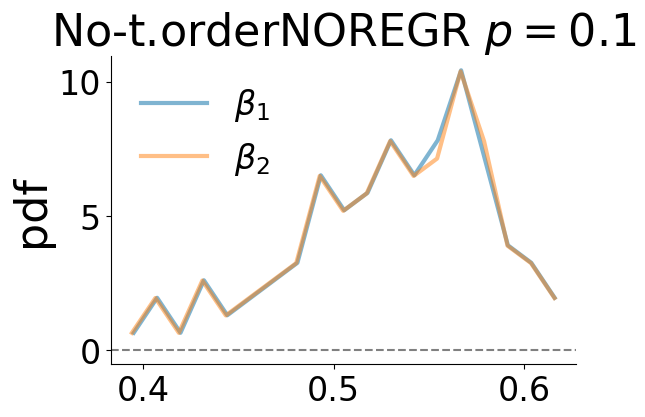

In [85]:
for p in tqdm([0.100]):
    label = fr"$p={str(p)}$"
    ERRW_model_data_with_entropy[label] = get_data_ERRW(
        p,dw=None,min_dw = None, max_dw = 0.1, do_fig = True,
        use_mean_indices = False,
        label_title_fig = label,
        consider_temporal_order_in_tuples = True,
    )
    label = fr"No-t.order $p={str(p)}$"
    ERRW_model_data_with_entropy[label] = get_data_ERRW(
        p,dw=None,min_dw = None, max_dw = 0.1, do_fig = True,
        use_mean_indices = False,
        label_title_fig = label,
        consider_temporal_order_in_tuples = False,
    )
    label = fr"NOREGR $p={str(p)}$"
    ERRW_model_data_with_entropy[label] = get_data_ERRW(
        p,dw=None,min_dw = None, max_dw = 0.1, do_fig = True,
        use_mean_indices = True,
        label_title_fig = label,
        consider_temporal_order_in_tuples = True,
    )
    label = fr"No-t.orderNOREGR $p={str(p)}$"
    ERRW_model_data_with_entropy[label] = get_data_ERRW(
        p,dw=None,min_dw = None, max_dw = 0.1, do_fig = True,
        use_mean_indices = True,
        label_title_fig = label,
        consider_temporal_order_in_tuples = False,
    )

$p=0.1$
p-value pearson between None and $\beta_2$ 3.523576334336094e-129
No-t.order $p=0.1$
p-value pearson between None and $\beta_2$ 6.150900023318943e-293
NOREGR $p=0.1$
p-value pearson between None and $\beta_2$ 1.9659089813535734e-275
No-t.orderNOREGR $p=0.1$
p-value pearson between $\beta_1$ and $\beta_2$ 0.0


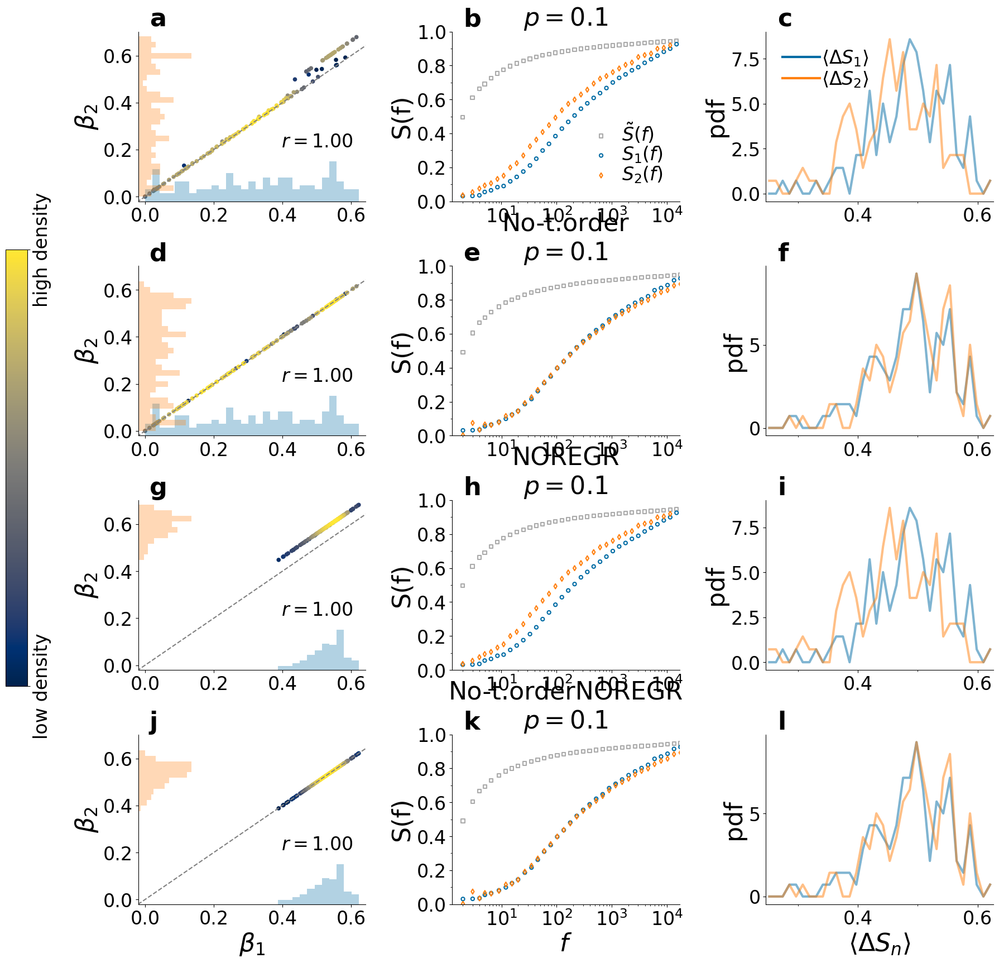

In [86]:
fig = fig_3(
    ERRW_model_data_with_entropy, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_x_a = None,
    max_x_a = None,
    min_y_a = None,
    max_y_a = None,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_b = None,
    max_x_b = None,
#                                         min_x_c = -0.1,
#                                         max_x_c = 0.3,
)


fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_low_res.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations.pdf"),format='pdf')

## Functions new

In [224]:
def fig_3_new(data, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
          min_beta = None,
          max_beta = None,
          min_beta_higher = None,
          max_beta_higher = None,
          use_same_x_y_max_lim = True,
          do_dashed_line = True,
        x_correlation_text = 0.63, 
        y_correlation_text = .32,
          num_bins = 35,
          min_x_b = None,
          max_x_b = None,
          min_x_c = None,
          max_x_c = None,
          normalize = True
         ):
    nrows = num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
#     outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.35) # 0.25
    outer = gridspec.GridSpec(nrows=1, ncols=2, width_ratios = [1]+[10], wspace=0.1) # 0.25
    wspace = 0.38
    hspace = 0.38
    ncols = 3
    
    # get highest f to unify first row
    if use_same_x_y_max_lim == True:
        max_x_b = 1
        min_x_c = 100000
        max_x_c = -100000
        for dataset_label, dataset_dict in data.items():
            x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in dataset_dict[f"mean_entropies"].items() for value in values]
            max_x_b = max(max_x_b, max(x))
            x = dataset_dict[f"weighted_diff_entropies"]
            min_x_c = min(min_x_c, min(x))
            max_x_c = max(max_x_c, max(x))
            x = dataset_dict[f"weighted_diff_entropies_pairs"]
            min_x_c = min(min_x_c, min(x))
            max_x_c = max(max_x_c, max(x))
    
    
    inner = gridspec.GridSpecFromSubplotSpec(nrows, ncols,
                        subplot_spec=outer[-1],wspace=wspace,hspace=hspace)
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        row = i
        print(dataset_label)
        ax = plt.Subplot(fig, inner[i*ncols])
        i_order = 1
        n_order = 2
        order = str(n_order)
        x = np.array(dataset_dict['betas'])
        y = np.array(dataset_dict[f'betas{order}'])
        y = (y-x)
        if normalize==True:
            y /= 1-x
        fig_1_subplot_b_d(x, y, 
                          ax = ax, 
                          marker_size = 20, alpha_scatter = alpha_scatter,
                          alpha_histogram = alpha_histogram, 
                          color_x = color_x, color_y = color_y, 
                          max_hist = max_hist, 
                          number_to_write = i*ncols, 
                          write_number = True, #i==0, 
                          do_dashed_line = do_dashed_line,
                          xlabel = r"$\beta_1$" if i == num_datasets - 1 else None, 
                          ylabel = fr"$(\beta_{order} - \beta_{1}) / (1 - \beta_{1})$" if normalize==True else fr"$\beta_{order} - \beta_{1}$", 
                          min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                          x_correlation_text = x_correlation_text, 
                          y_correlation_text = y_correlation_text,
                         )
        fig.add_subplot(ax)
    
        # ENTROPY
    
        column = 1
        ax = plt.Subplot(fig, inner[row*ncols+column])
        fig_2_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = '\n'.join(dataset_label.split(' ')),
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        num_bins = num_bins,
                        xlim_left = min_x_b, xlim_right = max_x_b, 
                        ylim_bottom = 0, ylim_top = 1, 
                        do_legend = row == 0,
                        xlabel = r"$f$" if row == nrows-1 else None, write_number = True,
                        ylabel = r"S(f)", 
                       )
        fig.add_subplot(ax)

        column = 2
        ax = plt.Subplot(fig, inner[row*ncols+column])
        fig_2_subplot_b(dataset_dict,
                          ax = ax, 
                          num_bins = num_bins,
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          do_legend = row == 0,
                          xlabel = r"$\langle \Delta S_n \rangle$" if row == nrows-1 else None, 
                          ylabel = r"pdf", 
                          xlim_left=min_x_c, xlim_right=max_x_c, 
                         )
        fig.add_subplot(ax)
        
        
    ####################### COLORBAR #######################
    
#     inner = gridspec.GridSpecFromSubplotSpec(2, 1,
#                             subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
#     ax_cmap = plt.Subplot(fig, inner[1])
    ax_cmap = plt.Subplot(fig, outer[0])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='vertical')
#     cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    cb.ax.get_yaxis().set_ticks([0,1]) 
    cb.ax.get_yaxis().set_ticklabels(['low density', 'high density'],rotation=90,verticalalignment='center') 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure new

UMT($\eta=1)$
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
UMST($\eta=0.5)$
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 1.7355773574026896e-115
UMST($\eta=0.1)$
p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
ERRW(SW)
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 2.9624982217996452e-36


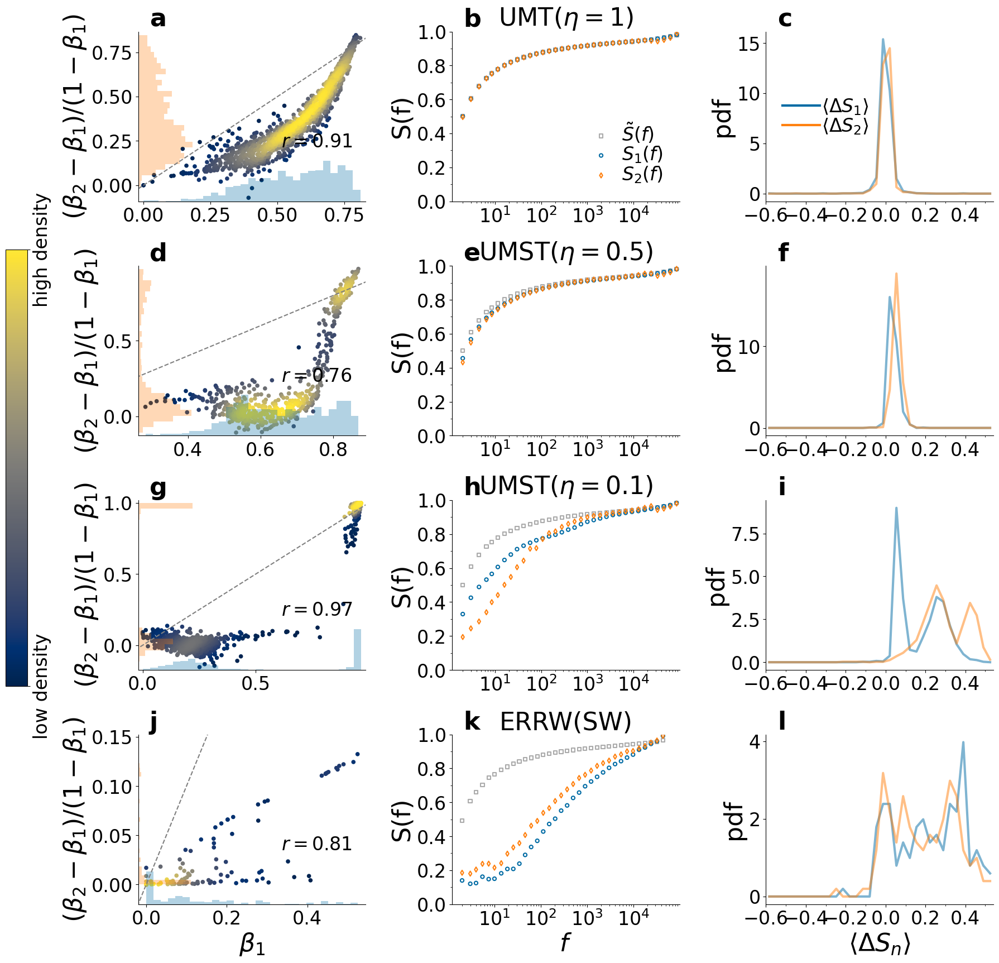

In [220]:
fig = fig_3_new(
    model_data_with_entropy, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_beta = None,
    max_beta = None,
    min_beta_higher = None,
    max_beta_higher = None,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_b = None,
    max_x_b = None,
#                                         min_x_c = -0.1,
#                                         max_x_c = 0.3,
    normalize = True,
)


fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_new_normalized.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_low_res_new_normalized.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_new_normalized.pdf"),format='pdf')

UMT($\eta=1)$
p-value pearson between None and $\beta_2 - \beta_1$ 7.34379901897459e-192
UMST($\eta=0.5)$
p-value pearson between None and $\beta_2 - \beta_1$ 1.7930572700114896e-63
UMST($\eta=0.1)$
p-value pearson between None and $\beta_2 - \beta_1$ 1.815120757986755e-74
ERRW(SW)
p-value pearson between $\beta_1$ and $\beta_2 - \beta_1$ 5.785870811645468e-30


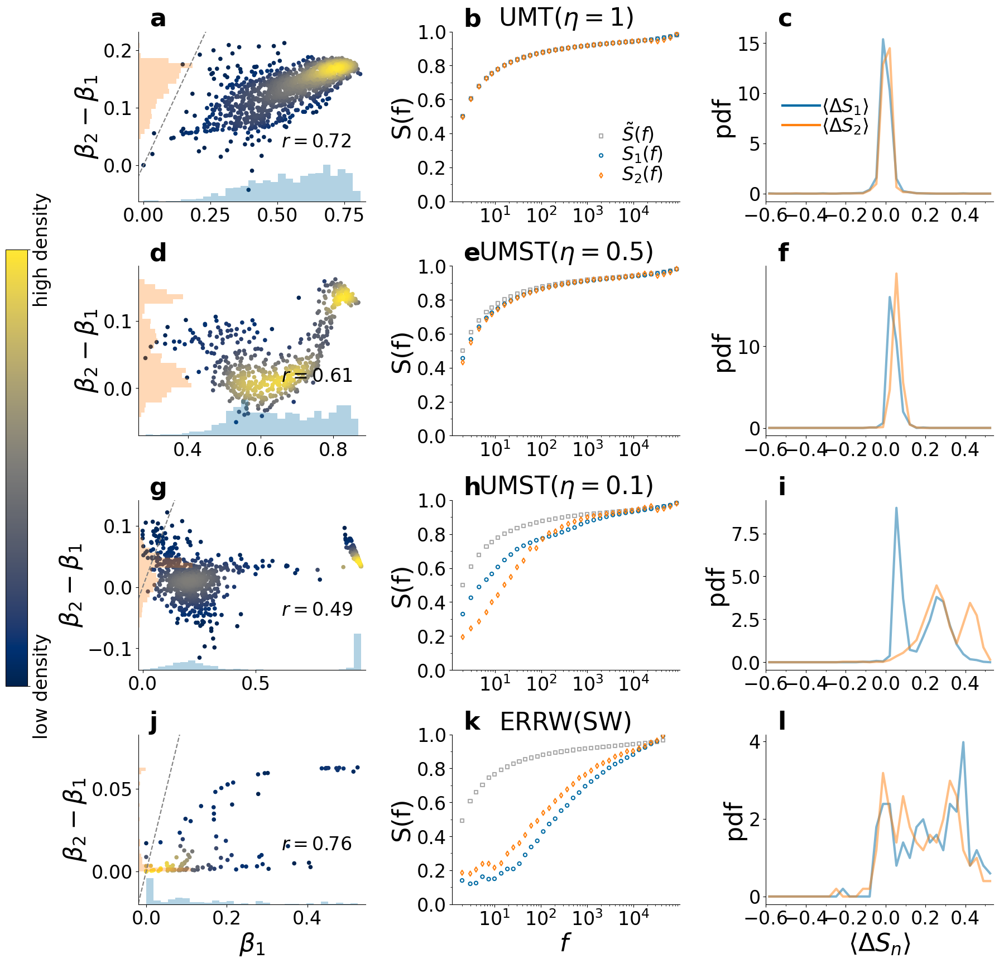

In [225]:
fig = fig_3_new(
    model_data_with_entropy, 
    marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, 
    min_beta = None,
    max_beta = None,
    min_beta_higher = None,
    max_beta_higher = None,
                                        use_same_x_y_max_lim = True,
    do_dashed_line = True,
    x_correlation_text = 0.63, 
    y_correlation_text = .32,
    num_bins = 35,
    min_x_b = None,
    max_x_b = None,
#                                         min_x_c = -0.1,
#                                         max_x_c = 0.3,
    normalize = False,
)


fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_new_not_normalized.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_low_res_new_not_normalized.pdf"),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig3_model_simulations_new_not_normalized.pdf"),format='pdf')

# OLD Figure: Higher order exponents in MODEL simulations

## Load data simulations

### Short simulations

In [422]:
Tmax = int(1e5)
use_scratch = False
results_simulations = {}
print('Simulations found:')
for eta in [1,0.1]:#,0.01,0.001,0]:
    for rho in [1,2,3,4,5,10,20]:
        for nu in range(1,21):# min(21,int(rho/eta))):
            try:
                workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                workdir_scratch = f"/data/scratch/ahw701/pairs/UMST/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                if use_scratch == True:
                    with open(f"{workdir_scratch}average_UMT_results.pkl",'rb') as fp:
                        tmp = pickle.load(fp)
                else:
                    if os.path.exists(f"{workdir}average_UMT_light_results.pkl"):
                        with open(f"{workdir}average_UMT_light_results.pkl",'rb') as fp:
                            tmp = pickle.load(fp)
                    else:
                        with open(f"{workdir}average_UMT_light_results_old.pkl",'rb') as fp:
                            tmp = pickle.load(fp)
                if eta not in results_simulations:
                    results_simulations[eta] = {}
                if rho not in results_simulations[eta]:
                    results_simulations[eta][rho] = {}
                results_simulations[eta][rho][nu] = tmp.copy()
                print('eta',eta, 'rho',rho, 'nu',nu, 'num_sim:', len(results_simulations[eta][rho][nu]['beta_loglogregr_indices_geom_list_finals']))
            except:
                pass

Simulations found:
eta 1 rho 20 nu 1 num_sim: 100
eta 1 rho 20 nu 2 num_sim: 100
eta 1 rho 20 nu 3 num_sim: 100
eta 1 rho 20 nu 4 num_sim: 100
eta 1 rho 20 nu 5 num_sim: 100
eta 1 rho 20 nu 6 num_sim: 100
eta 1 rho 20 nu 7 num_sim: 100
eta 1 rho 20 nu 8 num_sim: 100
eta 1 rho 20 nu 9 num_sim: 100
eta 1 rho 20 nu 10 num_sim: 100
eta 1 rho 20 nu 11 num_sim: 100
eta 1 rho 20 nu 12 num_sim: 100
eta 1 rho 20 nu 13 num_sim: 100
eta 1 rho 20 nu 14 num_sim: 100
eta 1 rho 20 nu 15 num_sim: 100
eta 1 rho 20 nu 16 num_sim: 100
eta 1 rho 20 nu 17 num_sim: 100
eta 1 rho 20 nu 18 num_sim: 100
eta 1 rho 20 nu 19 num_sim: 100
eta 1 rho 20 nu 20 num_sim: 100
eta 0.1 rho 4 nu 1 num_sim: 100
eta 0.1 rho 4 nu 2 num_sim: 100
eta 0.1 rho 4 nu 3 num_sim: 100
eta 0.1 rho 4 nu 4 num_sim: 100
eta 0.1 rho 4 nu 5 num_sim: 100
eta 0.1 rho 4 nu 6 num_sim: 100
eta 0.1 rho 4 nu 7 num_sim: 100
eta 0.1 rho 4 nu 8 num_sim: 100
eta 0.1 rho 4 nu 9 num_sim: 100
eta 0.1 rho 4 nu 10 num_sim: 100
eta 0.1 rho 4 nu 11 num_sim: 

### Long simulations

In [88]:
Tmax = int(1e7)
use_scratch = False
results_simulations_long = {}
print('Simulations found:')
for eta in [1,0.1]:#,0.01,0.001,0]:
    for rho in [1,2,3,4,5,10,20]:
        for nu in range(1,21):# min(21,int(rho/eta))):
            try:
                workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                workdir_scratch = f"/data/scratch/ahw701/pairs/UMST/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
                if rho == 20 and eta == 1:
                    for run in range(100):
                        try:
                            os.remove(f"{workdir}UMT_run_{run}.pkl")
                        except:
                            pass
                if use_scratch == True:
                    with open(f"{workdir_scratch}average_UMT_results.pkl",'rb') as fp:
                        tmp = pickle.load(fp)
                else:
                    with open(f"{workdir}average_UMT_light_results.pkl",'rb') as fp:
                        tmp = pickle.load(fp)
                if eta not in results_simulations_long:
                    results_simulations_long[eta] = {}
                if rho not in results_simulations_long[eta]:
                    results_simulations_long[eta][rho] = {}
                results_simulations_long[eta][rho][nu] = tmp.copy()
                if tmp['ts'][-1] == Tmax - 1 or tmp['D_indices'][0] > 1:
                    for _ in ['ts', 'ts_geom', 'indices','indices_geom']:
                        tmp[_] = [1] + list(np.array(tmp[_])+1)
                    for _ in ['D_indices', 'D2_indices', 'D3_indices','D4_indices']:
                        tmp[_] = np.array([1] + list(np.array(tmp[_])+1))
                    
                    for _ in ['ts', 'ts_geom', 'indices','indices_geom']:
                        tmp[_] = [1] + list(np.array(tmp[_])+1)
                    
                print('eta',eta, 'rho',rho, 'nu',nu, 'num_sim:', len(results_simulations_long[eta][rho][nu]['beta_loglogregr_indices_geom_list_finals']))
            except:
                pass

Simulations found:
eta 1 rho 4 nu 1 num_sim: 100
eta 1 rho 4 nu 2 num_sim: 100
eta 1 rho 4 nu 3 num_sim: 100
eta 1 rho 20 nu 1 num_sim: 100
eta 1 rho 20 nu 2 num_sim: 100
eta 1 rho 20 nu 3 num_sim: 100
eta 1 rho 20 nu 4 num_sim: 100
eta 1 rho 20 nu 5 num_sim: 100
eta 1 rho 20 nu 6 num_sim: 100
eta 1 rho 20 nu 7 num_sim: 100
eta 1 rho 20 nu 8 num_sim: 100
eta 1 rho 20 nu 9 num_sim: 100
eta 1 rho 20 nu 10 num_sim: 100
eta 1 rho 20 nu 11 num_sim: 100
eta 1 rho 20 nu 12 num_sim: 100
eta 1 rho 20 nu 13 num_sim: 100
eta 1 rho 20 nu 14 num_sim: 100
eta 1 rho 20 nu 15 num_sim: 100
eta 1 rho 20 nu 16 num_sim: 87
eta 1 rho 20 nu 17 num_sim: 59
eta 1 rho 20 nu 18 num_sim: 29
eta 1 rho 20 nu 19 num_sim: 13
eta 0.1 rho 4 nu 1 num_sim: 100
eta 0.1 rho 4 nu 2 num_sim: 100
eta 0.1 rho 4 nu 3 num_sim: 100
eta 0.1 rho 4 nu 4 num_sim: 100
eta 0.1 rho 4 nu 5 num_sim: 100
eta 0.1 rho 4 nu 6 num_sim: 100
eta 0.1 rho 4 nu 7 num_sim: 99
eta 0.1 rho 4 nu 8 num_sim: 91
eta 0.1 rho 4 nu 9 num_sim: 80
eta 0.1 rho

## Functions

In [170]:
def fig_2_subplot_a(average_result, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = 1, 
                    ylim_bottom = 1, ylim_top = 1, 
                    ylabel = None, xlabel = None, 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    labels = []
    for i,order in enumerate(['', '2', '3', '4']):
        ax.plot(average_result["ts"][i:]-i, average_result[f"D{order}_indices"][i:], color = CB_color_cycle[i])
#         ax.plot([1]+list(average_result["ts"]-i+1), [1]+list(average_result[f"D{order}_indices"]), color = CB_color_cycle[i])
#         ax.plot(average_result["ts"],average_result["ts"]**average_result[f"beta{order}"][-1] * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
        if f"intercept{order}_loglogregr_indices_geom" in average_result:
            intercept = average_result[f"intercept{order}_loglogregr_indices_geom"][-1]
        else:
            intercept = 1
        ax.plot(average_result["ts"][i:]-i, intercept * (average_result["ts"][i:]-i)**average_result[f"beta{order}_loglogregr_indices_geom"][-1], # * (average_result[f"D{order}_indices"][-1]/average_result["ts"][-1]**average_result[f"beta{order}"][-1]), 
                color = CB_color_cycle[i], ls = "--", alpha=alpha)
        if order == '':
            labels.append(r"$D_1(t)\sim t^{%.2f}$"%(average_result["beta_loglogregr_indices_geom"][-1]))
        else:
            labels.append(r"$D_{%s}(t)\sim t^{%.2f}$"%(order, average_result[f"beta{order}_loglogregr_indices_geom"][-1]))
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel, fontweight='bold')
    ax.set_ylabel(ylabel, fontweight='bold')
    ax.loglog()
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    ax.yaxis.set_major_locator(locmaj)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Legend
    leg1 = ax.legend([(color,"--",True) for color in CB_color_cycle[:2]], labels[:2] , 
                     handler_map={tuple: continuous_and_dashed_line_handle()},
                     handletextpad=0.1, bbox_to_anchor=(-0.06,1.1), loc="upper left", labelspacing = 0, handlelength = 1.5
    ) 

    leg2 = ax.legend([(color,"--",True) for color in CB_color_cycle[2:4]], labels[2:] , 
                     handler_map={tuple: continuous_and_dashed_line_handle()},
                     handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0, handlelength = 1.5
    )
    ax.add_artist(leg1)
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [171]:
# parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
# eta, rho, nu = parameters_a_by_row['UMT']
# average_result = results_simulations[eta][rho][nu]
# for i,order in enumerate(['', '2', '3', '4']):
#     print(average_result[f"D{order}_indices"][0],average_result[f"D{order}_indices"][i])
#     plt.plot(average_result["ts"][i:]-i, average_result[f"D{order}_indices"][i:])
# plt.loglog()

In [172]:
def fig_2(results_simulations, 
          parameters_a_by_row, # {'UMT':(eta, rho, nu)}
#           parameters_b_d_by_row, # [(eta, rho)] # this is not needed, since it takes eta and rho from a, and looks for all possible values of nu
          marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = 0,
          max_beta = 1,
          min_beta_higher = 0,
          max_beta_higher = 1,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(parameters_a_by_row)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for i, dataset_label in enumerate(parameters_a_by_row.keys()):
            eta, rho, nu = parameters_a_by_row[dataset_label]
            max_t = max(max_t, results_simulations[eta][rho][nu]["ts"][-1]+1)
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, results_simulations[eta][rho][nu][f"D{order}_indices"][-1]+1)
                
    for i, dataset_label in enumerate(parameters_a_by_row.keys()):
        eta, rho, nu = parameters_a_by_row[dataset_label]
        dataset_dict = {}
        dataset_dict['average_results'] = results_simulations[eta][rho][nu]
        dataset_dict['betas'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas2'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta2_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas3'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta3_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas4'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta4_loglogregr_indices_geom_list_finals"]])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b = r"$\beta_1$"
            xlabel_c = r"$\beta_1$"
            xlabel_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
        ax = plt.Subplot(fig, inner[0])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1])
        fig_2_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = dataset_label, xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate([2,3,4], start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i_order])
            fig_1_subplot_b_d(dataset_dict['betas'], dataset_dict[f'betas{order}'], 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = fr"$\beta_{order}$", xlabel = xlabel_b, 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure (Tmax = 10^5)

In [173]:
for eta,rho in [(1,20), (.1,4)]:
    print(eta, rho, results_simulations[eta][rho].keys(), sep = '\t')

1	20	dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20])
0.1	4	dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20])


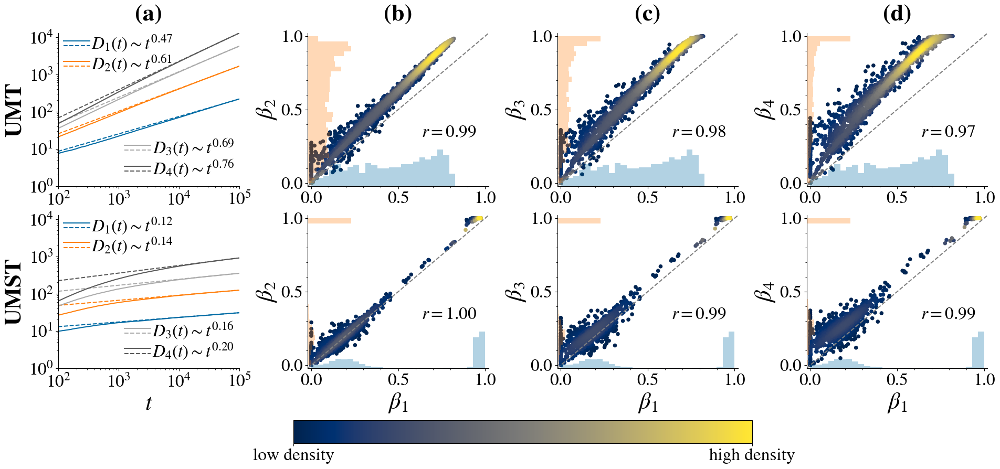

In [423]:
parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
Tmax = int(1e5)
fig = fig_2(
    results_simulations, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
    min_beta = min_beta,
    max_beta = max_beta,
    min_beta_higher = min_beta_higher,
    max_beta_higher = max_beta_higher,
    use_same_x_y_max_lim = True,
)


fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d.pdf"%(Tmax)),format='pdf')

## Functions new

In [211]:
def fig_2_new(results_simulations, 
          parameters_a_by_row, # {'UMT':(eta, rho, nu)}
#           parameters_b_d_by_row, # [(eta, rho)] # this is not needed, since it takes eta and rho from a, and looks for all possible values of nu
          marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = 0,
          max_beta = 1,
          min_beta_higher = 0,
          max_beta_higher = 1,
          use_same_x_y_max_lim = True,
              normalize = True,
         ):
    num_datasets = len(parameters_a_by_row)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        max_t = 1
        max_D = 1
        for i, dataset_label in enumerate(parameters_a_by_row.keys()):
            eta, rho, nu = parameters_a_by_row[dataset_label]
            max_t = max(max_t, results_simulations[eta][rho][nu]["ts"][-1]+1)
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, results_simulations[eta][rho][nu][f"D{order}_indices"][-1]+1)
                
    for i, dataset_label in enumerate(parameters_a_by_row.keys()):
        eta, rho, nu = parameters_a_by_row[dataset_label]
        dataset_dict = {}
        dataset_dict['average_results'] = results_simulations[eta][rho][nu]
        dataset_dict['betas'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas2'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta2_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas3'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta3_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas4'] = np.array([_ for tmp_nu in results_simulations[eta][rho].values() for _ in tmp_nu["beta4_loglogregr_indices_geom_list_finals"]])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]+1
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
        
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$t$"
            xlabel_b = r"$\beta_1$"
            xlabel_c = r"$\beta_1$"
            xlabel_d = r"$\beta_1$"
        else:
            xlabel_a = xlabel_b = xlabel_c = xlabel_d = None
        ax = plt.Subplot(fig, inner[0])
        if use_same_x_y_max_lim == False:
            max_t = dataset_dict['average_results']["ts"][-1]
            max_D = 1
            for order in ['', '2', '3', '4']:
                max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1])
        fig_2_subplot_a(dataset_dict['average_results'], 
                        ax = ax, 
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = xlim_left_a, xlim_right = max_t, 
                        ylim_bottom = ylim_bottom_a, ylim_top = max_D, 
                        ylabel = dataset_label, xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        for i_order,n_order in enumerate([2,3,4], start=1):
            order = str(n_order)
            ax = plt.Subplot(fig, inner[i_order])
            x = np.array(dataset_dict[f'betas'])
            y = np.array(dataset_dict[f'betas{order}'])
            y = (y-x)
            if normalize==True:
                y /= 1-x
            fig_1_subplot_b_d(x, y, 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              do_dashed_line = do_dashed_line,
                              write_number = i==0, 
                              x_correlation_text = x_correlation_text, 
                              y_correlation_text = y_correlation_text,
                              xlabel = xlabel_b, 
                              ylabel = fr"$(\beta_{order} - \beta_{1}) / (1 - \beta_{1})$" if normalize==True else fr"$beta_{order} - \beta_{1}$", 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure new

p-value pearson between None and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between None and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_3 - \beta_1) / (1 - \beta_1)$ 0.0
p-value pearson between $\beta_1$ and $(\beta_4 - \beta_1) / (1 - \beta_1)$ 0.0


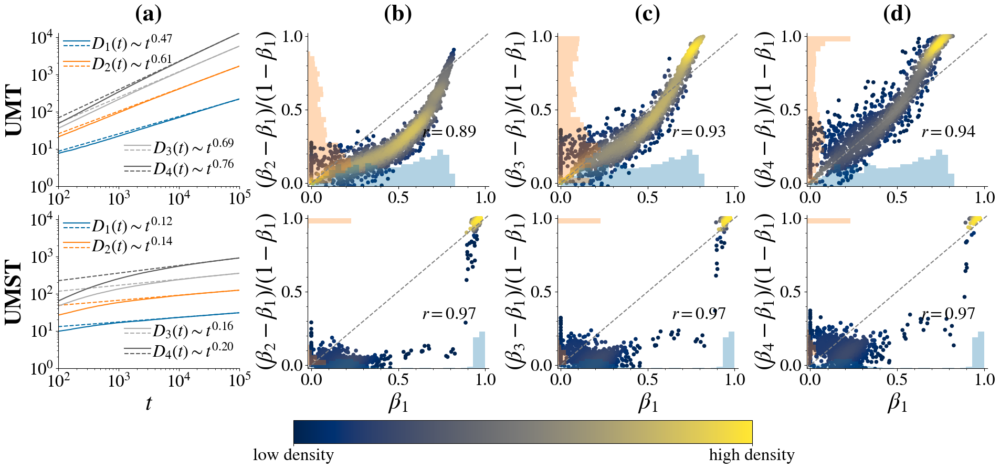

In [949]:
parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
Tmax = int(1e5)
fig = fig_2_new(
    results_simulations, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
    min_beta = min_beta,
    max_beta = max_beta,
    min_beta_higher = min_beta_higher,
    max_beta_higher = max_beta_higher,
    use_same_x_y_max_lim = True,
)


fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_new.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_low_res_new.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig2_Heaps_simulations_Tmax_%d_new.pdf"%(Tmax)),format='pdf')

## Figure SI (Tmax = 10^7)

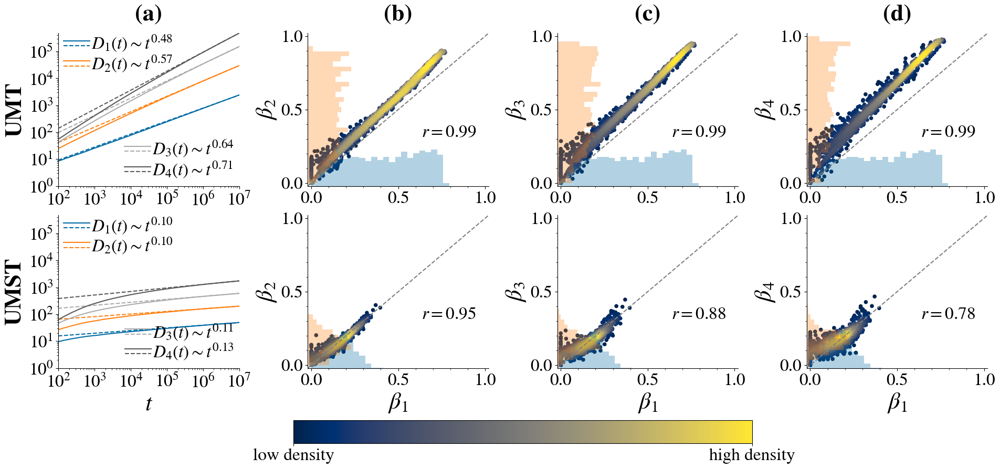

In [175]:
parameters_a_by_row = {'UMT' : (1,20,10), 'UMST':(.1, 4,4)}
Tmax = int(1e7)
fig = fig_2(
    results_simulations_long, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0.3, 
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
    min_beta = min_beta,
    max_beta = max_beta,
    min_beta_higher = min_beta_higher,
    max_beta_higher = max_beta_higher,
    use_same_x_y_max_lim = True,
)


fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d.pdf"%(Tmax)),format='pdf')

## Figure SI: Comparison with $\nu/\rho$

### Functions

In [94]:
def fig_comparison_simulation_expected_beta(results_simulations, 
          parameters_by_row, # {'UMT':(eta, rho)}
          marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, 
          y_correlation_text = .32, 
          color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, xlim_left_a = 1, ylim_bottom_a = 1,
          min_beta = 0,
          max_beta = 1,
          min_beta_higher = 0,
          max_beta_higher = 1,
         ):
    num_datasets = len(parameters_a_by_row)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    for i, dataset_label in enumerate(parameters_a_by_row.keys()):
        eta, rho = parameters_by_row[dataset_label]
        dataset_dict = {}
        dataset_dict['expected_betas'] = np.array([eta*nu/rho for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas2'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta2_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas3'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta3_loglogregr_indices_geom_list_finals"]])
        dataset_dict['betas4'] = np.array([_ for nu,tmp_nu in results_simulations[eta][rho].items() for _ in tmp_nu["beta4_loglogregr_indices_geom_list_finals"]])
        
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel = r"$\eta\nu/\rho$"
        else:
            xlabel = None
        
        for i_order, order in enumerate(['', '2', '3', '4']):
            n_order = i_order + 1
            ylabel = fr"$\beta_{n_order}$"
            ax = plt.Subplot(fig, inner[i_order])
            fig_1_subplot_b_d(dataset_dict['expected_betas'], dataset_dict[f'betas{order}'], 
                              ax = ax, 
                              marker_size = 20, alpha_scatter = alpha_scatter,
                              alpha_histogram = alpha_histogram, 
                              color_x = color_x, color_y = color_y, 
                              max_hist = max_hist, number_to_write = i*ncols+i_order,
                              write_number = i == 0, y_correlation_text = y_correlation_text,
                              ylabel = ylabel, xlabel = xlabel, 
                              min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                             )
            if i_order == 0:
                ax.text(-0.33, 0.5, f"{dataset_label}", transform=ax.transAxes,fontweight='bold', horizontalalignment='right', verticalalignment='center', rotation = 90)
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels(['low density', 'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

### Figure (Tmax = 10^5)

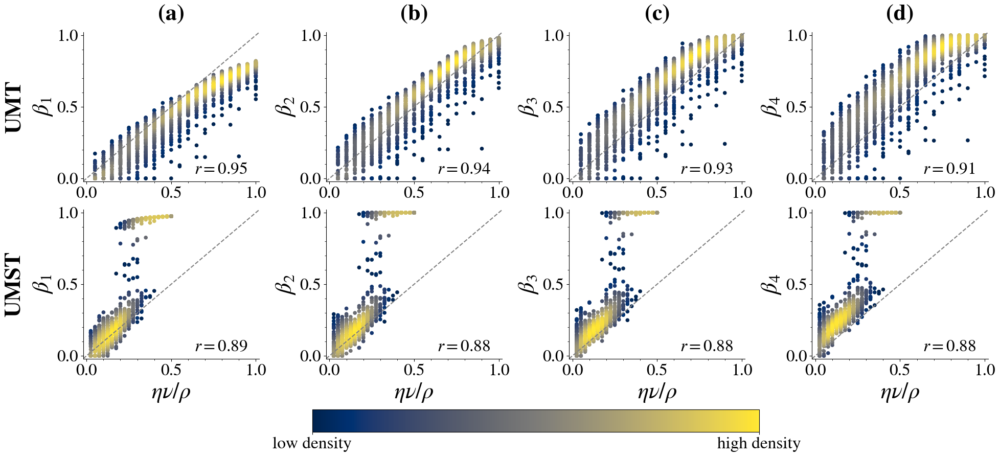

In [95]:
parameters_a_by_row = {'UMT' : (1,20), 'UMST':(.1, 4)}
Tmax = int(1e5)
fig = fig_comparison_simulation_expected_beta(
    results_simulations, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0, 
    y_correlation_text = .05,
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
#     min_beta = -0.02,
#     max_beta = 1.02,
#     min_beta_higher = -0.02,
#     max_beta_higher = 1.02,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
)


fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.pdf"%(Tmax)),format='pdf')

### Figure (Tmax = 10^7)

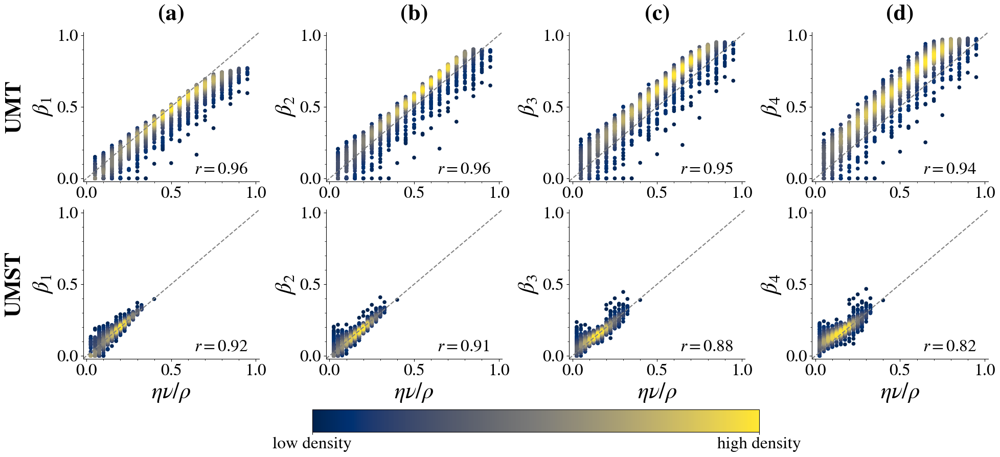

In [96]:
parameters_a_by_row = {'UMT' : (1,20), 'UMST':(.1, 4)}
Tmax = int(1e7)
fig = fig_comparison_simulation_expected_beta(
    results_simulations_long, 
    parameters_a_by_row,
    marker_size = 20, 
    alpha_scatter = 1, 
    alpha_histogram = 0, 
    y_correlation_text = .05,
    color_x = CB_color_cycle[0], 
    color_y = CB_color_cycle[1], 
    max_hist = 0.25, 
    xlim_left_a = 1e2, 
    ylim_bottom_a = 1e0,
#     min_beta = -0.02,
#     max_beta = 1.02,
#     min_beta_higher = -0.02,
#     max_beta_higher = 1.02,
    min_beta = 0,
    max_beta = 1,
    min_beta_higher = 0,
    max_beta_higher = 1,
)


fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.png"%(Tmax)))
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected_low_res.pdf"%(Tmax)),format='pdf',dpi=100)
fig.savefig(os.path.join(figures_folder, f"FigSI_Heaps_simulations_Tmax_%d_vs_expected.pdf"%(Tmax)),format='pdf')

## Table SI: Number of simulations not finished

### UMT

In [97]:
eta = 1
rho = 20
eta_list = []
rho_list = []
nu_list = []
Tmax_list = []
# ok_list = []
launched_list = []
finished_list = []
Tmax_long_list = []
# ok_long_list = []
launched_long_list = []
finished_long_list = []
for nu,tmp_nu in results_simulations[eta][rho].items():
    betas = tmp_nu['beta_loglogregr_indices_geom_list_finals']
    try:
        tmp_nu_long = results_simulations_long[eta][rho][nu]
        betas_long = tmp_nu_long['beta_loglogregr_indices_geom_list_finals']
    except:
        betas_long = []
#     num_ok = len([beta for beta in betas if beta < 0.9])
#     num_ok_long = len([beta for beta in betas_long if beta < 0.9])
    num_launched = 100
    num_launched_long = 100
    eta_list.append(eta)
    rho_list.append(rho)
    nu_list.append(nu)
    Tmax_list.append(r"$10^5$")
#     ok_list.append(num_ok)
    launched_list.append(num_launched)
    finished_list.append(len(betas))
    Tmax_long_list.append(r"$10^7$")
#     ok_long_list.append(num_ok_long)
    launched_long_list.append(num_launched_long)
    finished_long_list.append(len(betas_long))
df = pd.DataFrame(data = {
    r"$\eta$" : eta_list,
    r"$\rho$" : rho_list,
    r"$\nu$" : nu_list,
    r"$T$" : Tmax_list,
#     r"Ok" : ok_list,
    r"Launched" : launched_list,
    r"Finished" : finished_list,
    r" $T$" : Tmax_long_list,
#     r" Ok" : ok_long_list,
    r" Launched" : launched_list,
    r" Finished" : finished_long_list,
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.2f", escape=False))

\begin{tabular}{ccccccccc}
\toprule
 $\eta$ &  $\rho$ &  $\nu$ &    $T$ &  Launched &  Finished &    $T$ &   Launched &   Finished \\
\midrule
      1 &      20 &      1 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      2 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      3 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      4 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      5 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      6 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      7 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      8 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
      1 &      20 &      9 & $10^5$ &       100 &       100 & $10^7$ &   

### UMST

In [98]:
eta = 0.1
rho = 4
eta_list = []
rho_list = []
nu_list = []
Tmax_list = []
# ok_list = []
launched_list = []
finished_list = []
Tmax_long_list = []
# ok_long_list = []
launched_long_list = []
finished_long_list = []
for nu,tmp_nu in results_simulations[eta][rho].items():
    betas = tmp_nu['beta_loglogregr_indices_geom_list_finals']
    try:
        tmp_nu_long = results_simulations_long[eta][rho][nu]
        betas_long = tmp_nu_long['beta_loglogregr_indices_geom_list_finals']
    except:
        betas_long = []
#     num_ok = len([beta for beta in betas if beta < 0.9])
#     num_ok_long = len([beta for beta in betas_long if beta < 0.9])
    num_launched = 100
    num_launched_long = 100
    eta_list.append(eta)
    rho_list.append(rho)
    nu_list.append(nu)
    Tmax_list.append(r"$10^5$")
#     ok_list.append(num_ok)
    launched_list.append(num_launched)
    finished_list.append(len(betas))
    Tmax_long_list.append(r"$10^7$")
#     ok_long_list.append(num_ok_long)
    launched_long_list.append(num_launched_long)
    finished_long_list.append(len(betas_long))
df = pd.DataFrame(data = {
    r"$\eta$" : eta_list,
    r"$\rho$" : rho_list,
    r"$\nu$" : nu_list,
    r"$T$" : Tmax_list,
#     r"Ok" : ok_list,
    r"Launched" : launched_list,
    r"Finished" : finished_list,
    r" $T$" : Tmax_long_list,
#     r" Ok" : ok_long_list,
    r" Launched" : launched_list,
    r" Finished" : finished_long_list,
})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.1f", escape=False))

\begin{tabular}{ccccccccc}
\toprule
 $\eta$ &  $\rho$ &  $\nu$ &    $T$ &  Launched &  Finished &    $T$ &   Launched &   Finished \\
\midrule
    0.1 &       4 &      1 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      2 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      3 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      4 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      5 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      6 & $10^5$ &       100 &       100 & $10^7$ &        100 &        100 \\
    0.1 &       4 &      7 & $10^5$ &       100 &       100 & $10^7$ &        100 &         99 \\
    0.1 &       4 &      8 & $10^5$ &       100 &       100 & $10^7$ &        100 &         91 \\
    0.1 &       4 &      9 & $10^5$ &       100 &       100 & $10^7$ &   

### Together

In [99]:
max_count = 0
for label,eta in {'UMT':1, 'UMST':.1}.items():
    count = 0
    for rho in results_simulations[eta]:
        for nu,tmp_nu in results_simulations[eta][rho].items():
            count += 1
    print(eta, count)
    max_count = max(max_count, count)

1 20
0.1 20


In [100]:
data = {}
for label,eta in {'UMT':1, 'UMST':.1}.items():
    data[label] = {}
    data[label][r'$\eta$'] = []
    data[label][r'$\rho$'] = []
    data[label][r'$\nu$'] = []
    data[label][r'Reached $t=10^5$'] = []
    data[label][r'Reached $t=10^7$'] = []
    for rho,tmp_rho in results_simulations[eta].items():
        for nu,tmp_nu in tmp_rho.items():
            betas = tmp_nu['beta_loglogregr_indices_geom_list_finals']
            try:
                tmp_nu_long = results_simulations_long[eta][rho][nu]
                betas_long = tmp_nu_long['beta_loglogregr_indices_geom_list_finals']
            except:
                betas_long = []
            data[label][r'$\eta$'].append(eta)
            data[label][r'$\rho$'].append(rho)
            data[label][r'$\nu$'].append(nu)
            data[label][r'Reached $t=10^5$'].append(len(betas))
            data[label][r'Reached $t=10^7$'].append(len(betas_long))
#     df = pd.DataFrame(data = data[label])
# df = pd.DataFrame(data = {f"{label}_{key}":value for label,_ in data.items() for key,value in _.items()})
df = pd.DataFrame(data = {" "*i+key:value for i,(label,_) in enumerate(data.items()) for key,value in _.items()})
print(df.to_latex(index=False, column_format='c'*len(df.columns), float_format="%.1f", escape=False))

\begin{tabular}{cccccccccc}
\toprule
 $\eta$ &  $\rho$ &  $\nu$ &  Reached $t=10^5$ &  Reached $t=10^7$ &   $\eta$ &   $\rho$ &   $\nu$ &   Reached $t=10^5$ &   Reached $t=10^7$ \\
\midrule
      1 &      20 &      1 &               100 &               100 &      0.1 &        4 &       1 &                100 &                100 \\
      1 &      20 &      2 &               100 &               100 &      0.1 &        4 &       2 &                100 &                100 \\
      1 &      20 &      3 &               100 &               100 &      0.1 &        4 &       3 &                100 &                100 \\
      1 &      20 &      4 &               100 &               100 &      0.1 &        4 &       4 &                100 &                100 \\
      1 &      20 &      5 &               100 &               100 &      0.1 &        4 &       5 &                100 &                100 \\
      1 &      20 &      6 &               100 &               100 &      0.1 &        4 &

# OLD Figure3: $\beta_1$ vs $t$

## Functions

In [101]:
def fig_3_subplot(results_simulations,
                    parameters_to_plot,  # [(eta, rho, nu)] 
                    order,
                    beginning_index = 100, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1e3, xlim_right = 1e7, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = None, xlabel = None, 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    
    yticks = [0, 1]
    for i, (eta,rho,nu) in enumerate(parameters_to_plot):
        ax.plot(results_simulations[eta][rho][nu]["ts_geom"][beginning_index:], results_simulations[eta][rho][nu][f"average_beta{order}_loglogregr_indices_geom"][beginning_index:], color=CB_color_cycle[i])
        expected_beta = float(eta)*float(nu)/rho
        ax.axhline(expected_beta, ls='--', color=CB_color_cycle[i])
        if expected_beta not in yticks:
            yticks.append(expected_beta)

        
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel, fontweight='bold')
    ax.set_ylabel(ylabel, fontweight='bold')
    ax.set_xscale("log")
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    
    # y ticks
    ax.set_yticks(yticks)
    
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [102]:
def fig_3_subplot(results_simulations,
                    parameters_to_plot,  # [(eta, rho, nu)] 
                    order,
                    beginning_index = 100, 
                    ax = None, marker_size = 20, alpha = 1, 
                    number_to_write = 0, 
                    xlim_left = 1e3, xlim_right = 1e7, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = None, xlabel = None, 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
    
    yticks = [0, 1]
    for i, (eta,rho,nu) in enumerate(parameters_to_plot):
        ax.plot(results_simulations[eta][rho][nu]["ts_geom"][beginning_index:], results_simulations[eta][rho][nu][f"beta{order}_loglogregr_indices_geom"][beginning_index:], color=CB_color_cycle[i])
        expected_beta = float(eta)*float(nu)/rho
        ax.axhline(expected_beta, ls='--', color=CB_color_cycle[i])
        if expected_beta not in yticks:
            yticks.append(expected_beta)

        
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_xlabel(xlabel, fontweight='bold')
    ax.set_ylabel(ylabel, fontweight='bold')
    ax.set_xscale("log")
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    
    # y ticks
    ax.set_yticks(yticks)
    
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [105]:
def fig_3(results_simulations, 
          parameters_to_plot, # [(eta, rho, nu)] 
          marker_size = 20, alpha = 1, 
          beginning_index = 100, 
          min_beta = 0,
          max_beta = 1,
         ):
    fig, axes = plt.subplots(1,4,figsize=(width_fig,width_fig*2/3*1/3), gridspec_kw={'wspace':0.38})
    
    for i_order, order in enumerate(['', '2', '3', '4']):
        n_order = i_order + 1
        ax = axes[i_order]
        ax = fig_3_subplot(results_simulations,
                    parameters_to_plot, 
                    order,
                    beginning_index = beginning_index, 
                    ax = ax, alpha = 1, 
                    number_to_write = i_order, 
                    xlim_left = 1e3, xlim_right = 1e7, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = fr"$\beta_{n_order}(t)$", xlabel = r"$t$", 
                    write_number = True)

    labels = []
    for i, (eta,rho,nu) in enumerate(parameters_to_plot):
        labels.append(r"$\rho=%d$"%rho+", "+r"$\nu=%d$"%nu+", "+r"$\eta=%s$"%str(eta))
    leg = ax.legend(
        [(color,"--",True) for color in CB_color_cycle[:4]], labels, 
                         handler_map={tuple: continuous_and_dashed_line_handle()},
        handletextpad=0.1, bbox_to_anchor=(0.5, -0.05), loc='upper center', bbox_transform=fig.transFigure, ncol=len(list(range(len(parameters_to_plot),20,len(parameters_to_plot))))+1)
    
    return fig

## Figure

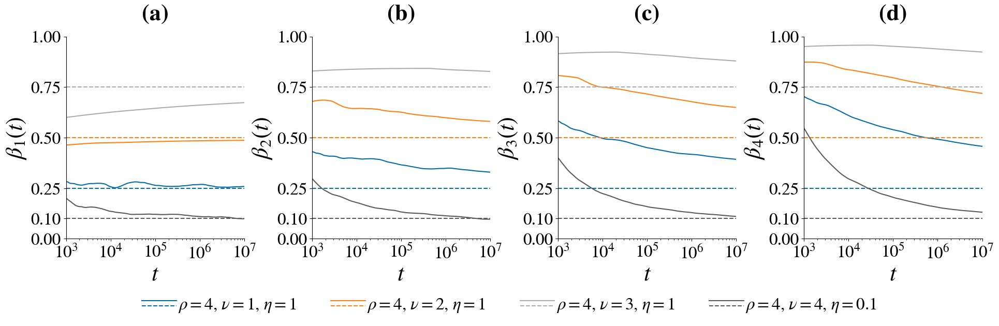

In [106]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(1, 4, 1), (1, 4, 2), (1, 4, 3),(.1, 4, 4),]
fig = fig_3(
    results_simulations_long, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    min_beta = 0,
    max_beta = 1,
)
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4.pdf"))

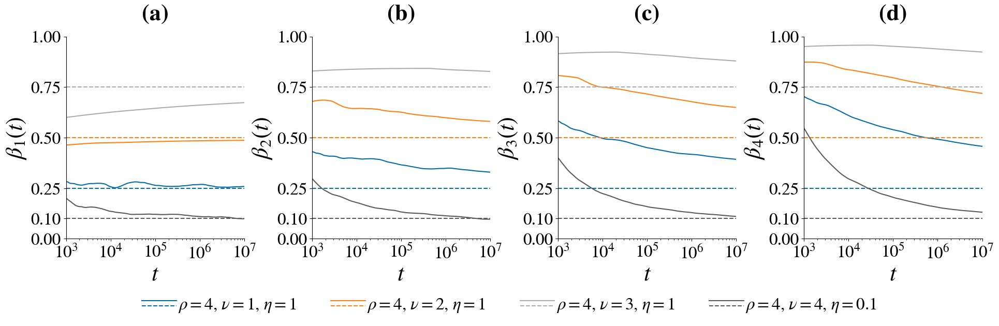

In [107]:
# parameters_to_plot = [(.1, 4, 4), (1, 20, 5), (1, 20, 10), (1, 20, 15)]
parameters_to_plot = [(1, 4, 1), (1, 4, 2), (1, 4, 3),(.1, 4, 4),]
fig = fig_3(
    results_simulations_long, 
    parameters_to_plot, # [(eta, rho, nu)] 
    marker_size = 20, alpha = 1, 
    beginning_index = 100, 
    min_beta = 0,
    max_beta = 1,
)
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4_fit_of_average.png"))
fig.savefig(os.path.join(figures_folder, f"Fig3_beta_changing_UMT_UMST_rho_4_fit_of_average.pdf"))

# OLD Figure4 OLD: Entropy vs $\beta_1$

## Load data with entropy

In [ ]:
with gzip.open('./data/essential_data_with_entropy_for_figures.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

## Preare data with entropy

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

In [434]:
# Load one random individual result (not light) from each dataset
with open(f'./data/random_individual_lastfm.pkl', 'rb') as fp:
    random_individual_lastfm = joblib.load(fp)
with open(f'./data/random_individual_gutenberg.pkl', 'rb') as fp:
    random_individual_gutenberg = joblib.load(fp)
with open(f'./data/random_individual_journals.pkl', 'rb') as fp:
    random_individual_journals = joblib.load(fp)

In [435]:
data_with_entropy = data.copy()
data_with_entropy['Last.fm']['random_individual'] = random_individual_lastfm
data_with_entropy['Project Gutenberg']['random_individual'] = random_individual_gutenberg
data_with_entropy['Semantic Scholar']['random_individual'] = random_individual_journals

In [436]:
data['Last.fm']['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for result in results_light_individual_lastfm.values()])
data['Project Gutenberg']['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for result in results_light_individual_gutenberg.values()])
data['Semantic Scholar']['weighted_diff_entropies'] = np.array([result["weighted_diff_entropies"] for field, field_results in results_light_individual_journals_fieldsOfStudy.items() for result in field_results.values()])

In [437]:
# add data about model
use_long_simulations = False
if use_long_simulations:
    tmp_results_simulations = results_simulations_long
else:
    tmp_results_simulations = results_simulations
eta_rho_to_use = [(1, 20)]
nu_to_use = np.arange(1,21)
data_with_entropy['UMT'] = {}
for order in ['', '2', '3', '4']:
    data_with_entropy['UMT'][f'betas{order}'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"beta{order}_loglogregr_indices_geom_list_finals"]])
data_with_entropy['UMT'][f'weighted_diff_entropies'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"weighted_diff_entropies_list"]])

In [439]:
eta = 1
rho = 20
nu = 10
run = 1
Tmax = int(1e5)
with open(f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/UMT_run_{run}.pkl",'rb') as fp:
     data_with_entropy['UMT']['random_individual'] = pickle.load(fp)

In [440]:
# add data about model
use_long_simulations = False
if use_long_simulations:
    tmp_results_simulations = results_simulations_long
else:
    tmp_results_simulations = results_simulations
eta_rho_to_use = [(.1, 4)]
nu_to_use = np.arange(1,21)
data_with_entropy['UMST'] = {}
for order in ['', '2', '3', '4']:
    data_with_entropy['UMST'][f'betas{order}'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"beta{order}_loglogregr_indices_geom_list_finals"]])
data_with_entropy['UMST'][f'weighted_diff_entropies'] = np.array([_ for eta,rho in eta_rho_to_use for nu in nu_to_use if nu in tmp_results_simulations[eta][rho] for _ in tmp_results_simulations[eta][rho][nu][f"weighted_diff_entropies_list"]])

In [441]:
eta = .1
rho = 4
nu = 10
run = 1
Tmax = int(1e5)
with open(f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/UMT_run_{run}.pkl",'rb') as fp:
     data_with_entropy['UMST']['random_individual'] = pickle.load(fp)

### Get data for (a)

#### Last.fm

In [442]:
with gzip.open("./data/ocelma-dataset/lastfm-dataset-1K/users_list_min_1000.pkl.gz", "rb") as fp:
    users_list = joblib.load(fp)

In [443]:
# data_with_entropy['Last.fm']['mean_entropies'] = {}
# data_with_entropy['Last.fm']['mean_entropies_glob'] = {}
# count = 0
# for i,userid in enumerate(tqdm(users_list)):
#     try:
#         save_all_file_path = f"./data/ocelma-dataset/lastfm-dataset-1K/individual_results/{userid}.pkl"
#         with open(save_all_file_path, 'rb') as fp:
#             user_result = pickle.load(fp)
#         data_with_entropy['Last.fm']['mean_entropies'][userid] = user_result['mean_entropies']
#         data_with_entropy['Last.fm']['mean_entropies_glob'][userid] = user_result['mean_entropies_glob']
#         count += 1
#     except:
#         pass
# print(f"Found {count} users out of {len(users_list)}")

In [444]:
data_with_entropy['Last.fm']['mean_entropies'] = {}
data_with_entropy['Last.fm']['mean_entropies_glob'] = {}
count = 0
for i,userid in enumerate(tqdm(users_list)):
    try:
        save_all_file_path = f"./data/ocelma-dataset/lastfm-dataset-1K/individual_results/{userid}.pkl"
        with open(save_all_file_path, 'rb') as fp:
            user_result = pickle.load(fp)
        for freq,value in user_result['mean_entropies'].items():
            try:
                data_with_entropy['Last.fm']['mean_entropies'][freq].append(value)
            except KeyError:
                data_with_entropy['Last.fm']['mean_entropies'][freq] = [value]
        for freq,value in user_result['mean_entropies_glob'].items():
            try:
                data_with_entropy['Last.fm']['mean_entropies_glob'][freq].append(value)
            except KeyError:
                data_with_entropy['Last.fm']['mean_entropies_glob'][freq] = [value]
        count += 1
    except:
        pass
print(f"Found {count} users out of {len(users_list)}")

  0%|          | 0/890 [00:00<?, ?it/s]

Found 890 users out of 890


#### Gutenberg

In [445]:
paths = glob.glob("./data/gutenberg/analysis/individual_results/*.pkl")
paths[:10]

['./data/gutenberg/analysis/individual_results/PG57676.pkl',
 './data/gutenberg/analysis/individual_results/PG62224.pkl',
 './data/gutenberg/analysis/individual_results/PG37412.pkl',
 './data/gutenberg/analysis/individual_results/PG57663.pkl',
 './data/gutenberg/analysis/individual_results/PG64397.pkl',
 './data/gutenberg/analysis/individual_results/PG42170.pkl',
 './data/gutenberg/analysis/individual_results/PG67188.pkl',
 './data/gutenberg/analysis/individual_results/PG49742.pkl',
 './data/gutenberg/analysis/individual_results/PG55584.pkl',
 './data/gutenberg/analysis/individual_results/PG42969.pkl']

In [446]:
data_with_entropy['Project Gutenberg']['mean_entropies'] = {}
data_with_entropy['Project Gutenberg']['mean_entropies_glob'] = {}
count = 0
for path in tqdm(paths):
#     ID = path.split('/')[-1].split(".pkl")[0]
    try:
        with open(path, 'rb') as fp:
            result = pickle.load(fp)
        for freq,value in result['mean_entropies'].items():
            try:
                data_with_entropy['Project Gutenberg']['mean_entropies'][freq].append(value)
            except KeyError:
                data_with_entropy['Project Gutenberg']['mean_entropies'][freq] = [value]
        for freq,value in result['mean_entropies_glob'].items():
            try:
                data_with_entropy['Project Gutenberg']['mean_entropies_glob'][freq].append(value)
            except KeyError:
                data_with_entropy['Project Gutenberg']['mean_entropies_glob'][freq] = [value]
        count += 1
    except:
        pass
print(f"Found {count} users out of {len(users_list)}")

  0%|          | 0/1492 [00:00<?, ?it/s]

Found 1492 users out of 890


#### Semantic Scholar

In [447]:
field = 'Art'
paths = glob.glob(f"data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/{field}/*.pkl")
paths[:10]

['data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/419.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/158.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/121.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/445.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/390.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/769.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/732.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/33.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/471.pkl',
 'data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/Art/795.pkl']

In [448]:
data_with_entropy['Semantic Scholar']['mean_entropies'] = {}
data_with_entropy['Semantic Scholar']['mean_entropies_glob'] = {}
count = 0
for path in tqdm(paths):
#     ID = path.split('/')[-1].split(".pkl")[0]
    try:
        with open(path, 'rb') as fp:
            result = pickle.load(fp)
        for freq,value in result['mean_entropies'].items():
            try:
                data_with_entropy['Semantic Scholar']['mean_entropies'][freq].append(value)
            except KeyError:
                data_with_entropy['Semantic Scholar']['mean_entropies'][freq] = [value]
        for freq,value in result['mean_entropies_glob'].items():
            try:
                data_with_entropy['Semantic Scholar']['mean_entropies_glob'][freq].append(value)
            except KeyError:
                data_with_entropy['Semantic Scholar']['mean_entropies_glob'][freq] = [value]
        count += 1
    except:
        pass
print(f"Found {count} users out of {len(paths)}")

  0%|          | 0/1000 [00:00<?, ?it/s]

Found 1000 users out of 890


#### UMT

In [452]:
Tmax = int(1e5)
data_with_entropy['UMT']['mean_entropies'] = {}
data_with_entropy['UMT']['mean_entropies_glob'] = {}
count = 0
for eta in [1]:
    for rho in [20]:
        for nu in tqdm(range(21)):
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            data_with_entropy['UMT']['mean_entropies'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMT']['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            data_with_entropy['UMT']['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMT']['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
print(f"Found {count} simulations")

  0%|          | 0/21 [00:00<?, ?it/s]

Found 1000 simulations


#### UMST

In [449]:
# Tmax = int(1e5)
# use_scratch = False
# for eta in [1]:#,0.01,0.001,0]:
#     for rho in [20]:
#         for nu in tqdm(range(1,11)):# min(21,int(rho/eta))):
#             workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
# #             print(glob.glob(workdir+"*"))
#             for run in range(100):
#                 try:
#                     os.rename(f"{workdir}UMT_light_run_{run}.pkl", f"{workdir}UMT_light_RUN_{run}_old.pkl", )
#                 except:
#                     pass
#             try:
#                 os.rename(f"{workdir}average_UMT_light_results.pkl", f"{workdir}average_UMT_light_results_old.pkl", )
#             except:
#                 pass

In [451]:
Tmax = int(1e5)
data_with_entropy['UMST']['mean_entropies'] = {}
data_with_entropy['UMST']['mean_entropies_glob'] = {}
count = 0
for eta in [.1]:
    for rho in [4]:
        for nu in tqdm(range(21)):
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            data_with_entropy['UMST']['mean_entropies'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMST']['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            data_with_entropy['UMST']['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            data_with_entropy['UMST']['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
print(f"Found {count} simulations")

  0%|          | 0/21 [00:00<?, ?it/s]

Found 1012 simulations


### Dump data

In [453]:
with gzip.open('./data/essential_data_with_entropy_for_figures.pkl.gz', "wb") as fp:
    joblib.dump(data_with_entropy, fp)
print('Dumped')

Dumped


## Functions

In [473]:
def fig_4_subplot_a_old(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
#        # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them
    ax.scatter(
        [freq  for freq,value in result["mean_entropies"].items()],
        [np.mean(value)  for freq,value in result["mean_entropies"].items()],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    ax.scatter(
        [freq for freq,value in result["mean_entropies_glob"].items()],
        [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them binned
#     x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
#     x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [668]:
def fig_4_subplot_a_old2(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
    x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [656]:
def fig_4_subplot_a(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    num_bins = 50,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    cycler = ax._get_lines.prop_cycler # to get the cycle of colors to use
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
#         max_x = max(x)
#         min_x = min(x)
#         num_bins = num_bins
#         x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#         x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
    #     y_bins = y_bins_sum / y_bins_count
        if i_order == 1:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            marker='d', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label='pairs', alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
        else:
#         if i_order == 0:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label='singletons', alpha=alpha, s=marker_size) # r"$\mathcal{Q}_{%d}$"%n_order
        
#             x = [freq  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
#             max_x = max(x)
#             min_x = min(x)
#             x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#             x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
            y = [value  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
            y_bins_count = np.zeros(len(x_bins_centers))
            y_bins_sum = np.zeros(len(x_bins_centers))
            for index,freq in enumerate(x):
                value = y[index]
                for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                    if freq < x_bins_lim_right:
                        break
                y_bins_sum[index_bin] += value
                y_bins_count[index_bin] += 1
            y_bins = np.zeros(len(x_bins_centers))
            for index,y_sum in enumerate(y_bins_sum):
                y_count = y_bins_count[index]
                if y_count > 0:
                    y_bins[index] = y_sum / y_count
        #     y_bins = y_bins_sum / y_bins_count
            ax.scatter(
                [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
                [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
                marker='s', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=2, label="random", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [455]:
def scatter_with_third_variable(x, y, z, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [456]:
def fig_4_subplot_b_d(x, y, z, ax = None, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, x_correlation_text = .1, y_correlation_text = .8, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, number_to_write = 0, write_number = False, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = min(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = min(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_third_variable(x, y, z, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
#     plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_fig_1_subplot_b_d(x, y, number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [457]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = None,
          max_y = None,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
        for i_order,order in enumerate(['2', '3', '4'], start=1):
            ax = plt.Subplot(fig, inner[i_order])
            fig_4_subplot_b_d(dataset_dict[f'betas{order}'], dataset_dict['weighted_diff_entropies'], dataset_dict[f'betas'], 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
                              min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [519]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = None,
          max_y = None,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
        for i_order,order in enumerate([''], start=1):
            ax = plt.Subplot(fig, inner[i_order])
            fig_4_subplot_b_d(dataset_dict[f'betas{order}'], dataset_dict['weighted_diff_entropies'], dataset_dict[f'betas'], 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_order, 
                              write_number = i==0, 
                              ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
                              min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
    cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure

p-value pearson between None and $\langle\Delta S \rangle$ 4.099423569830891e-06
p-value pearson between None and $\langle\Delta S \rangle$ 1.1071019303359732e-129
p-value pearson between None and $\langle\Delta S \rangle$ 2.5444345126675577e-249
p-value pearson between None and $\langle\Delta S \rangle$ 0.2283735308639822
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 5.6400797834081e-156


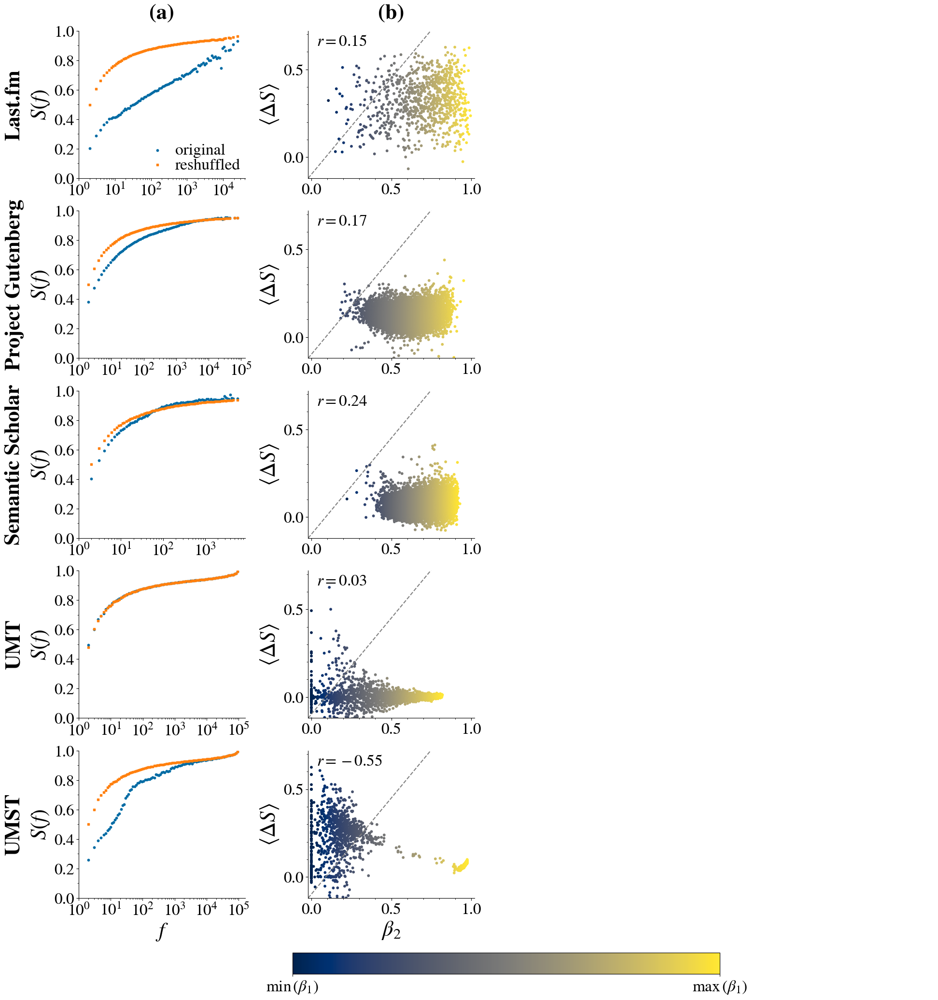

In [520]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

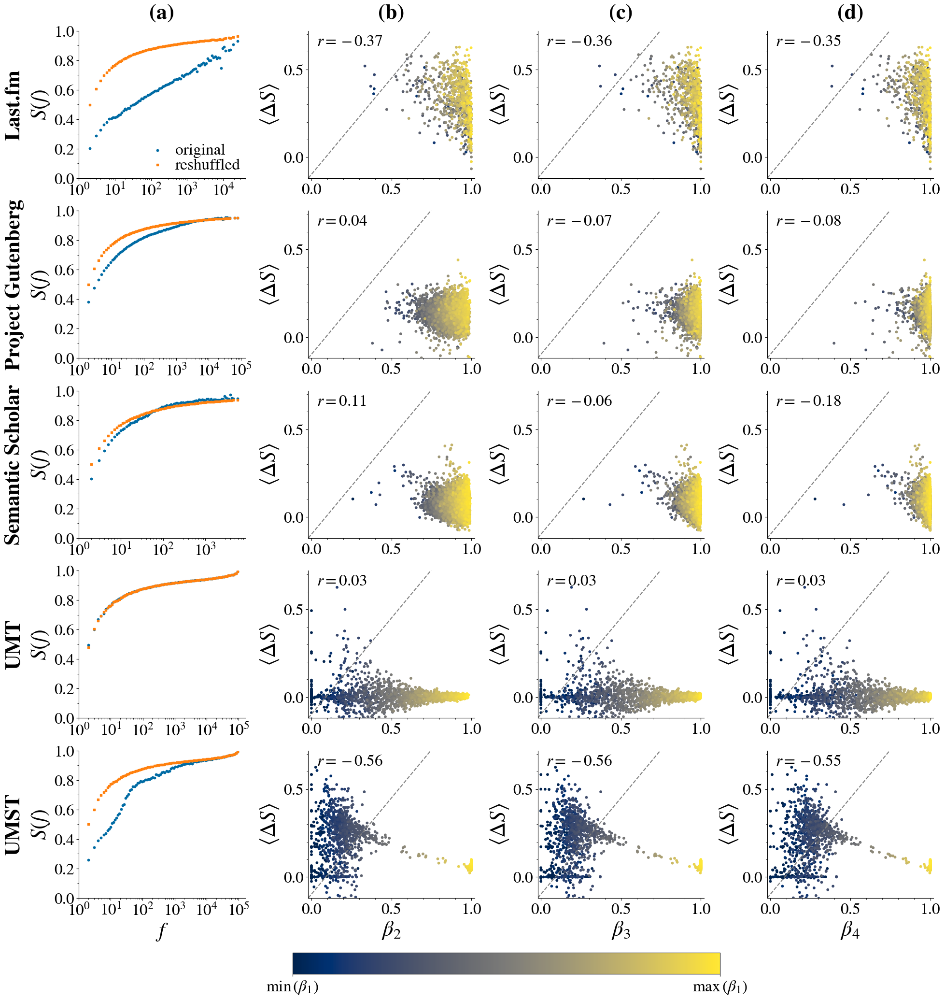

In [458]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

### Other tries

<AxesSubplot:ylabel='$S(f)$'>

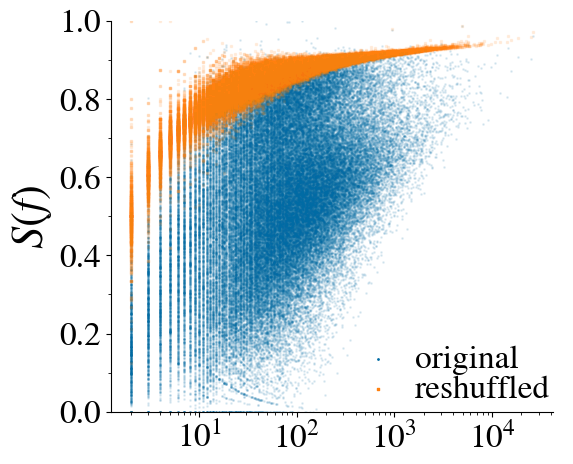

In [302]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Last.fm'], 
                    ax = ax, marker_size = 1, alpha = 0.1, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = None, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = None, 
                    write_number = False)

<AxesSubplot:ylabel='$S(f)$'>

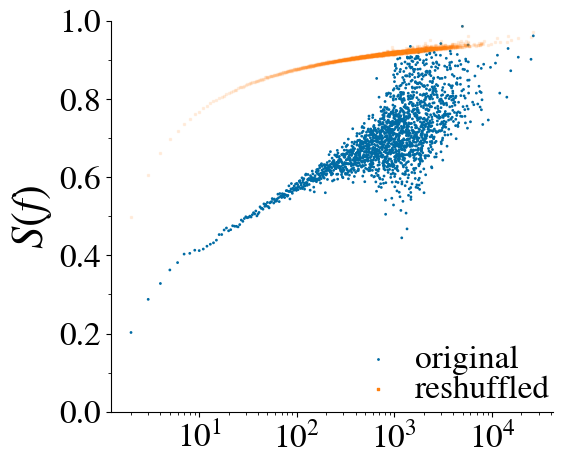

In [314]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Last.fm'], 
                    ax = ax, marker_size = 1, alpha = .1, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = None, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = None, 
                    write_number = False)

<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

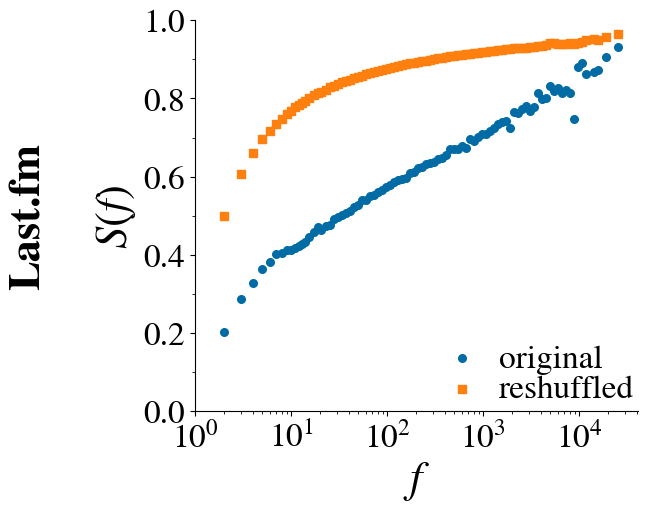

In [386]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Last.fm'], 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Last.fm', 
                    number_to_write = 0, 
                    write_number = False)

<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

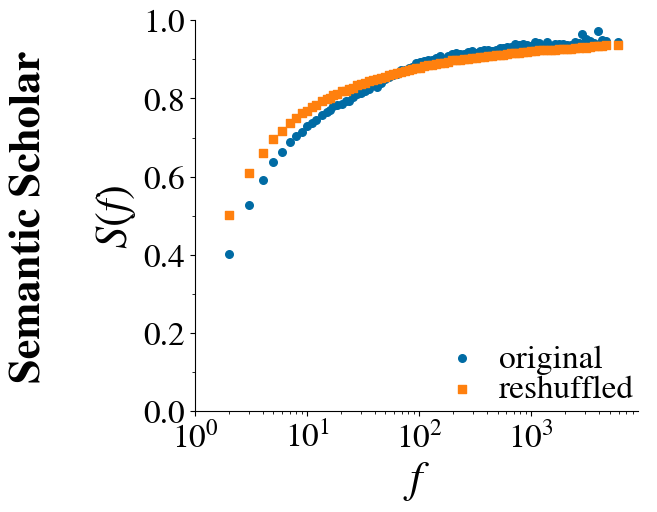

In [460]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(data_with_entropy['Semantic Scholar'], 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Semantic Scholar', 
                    number_to_write = 0, 
                    write_number = False)

#### Semantic Scholar

In [475]:
field = 'Art'
paths = glob.glob(f"data/semanticscholar/analysis/2022-01-01/journals_fieldsOfStudy/{field}/*.pkl")

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
count = 0
for path in tqdm(paths[500:1000]):
#     ID = path.split('/')[-1].split(".pkl")[0]
    try:
        with open(path, 'rb') as fp:
            result = pickle.load(fp)
        for freq,value in result['mean_entropies'].items():
            try:
                dataset['mean_entropies'][freq].append(value)
            except KeyError:
                dataset['mean_entropies'][freq] = [value]
        for freq,value in result['mean_entropies_glob'].items():
            try:
                dataset['mean_entropies_glob'][freq].append(value)
            except KeyError:
                dataset['mean_entropies_glob'][freq] = [value]
    except:
        pass


  0%|          | 0/500 [00:00<?, ?it/s]

<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

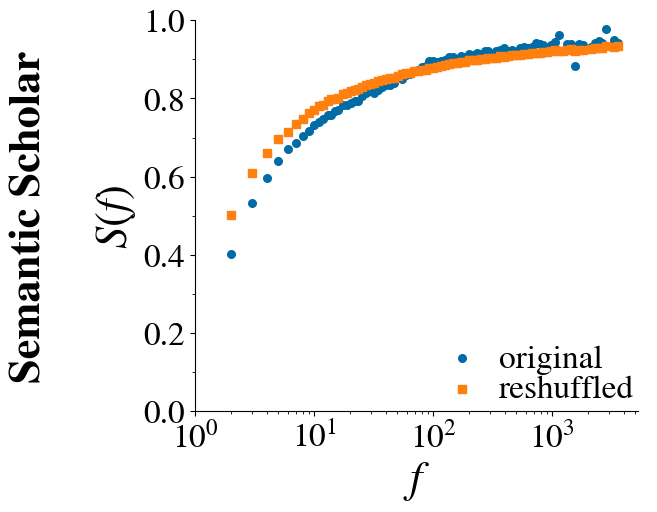

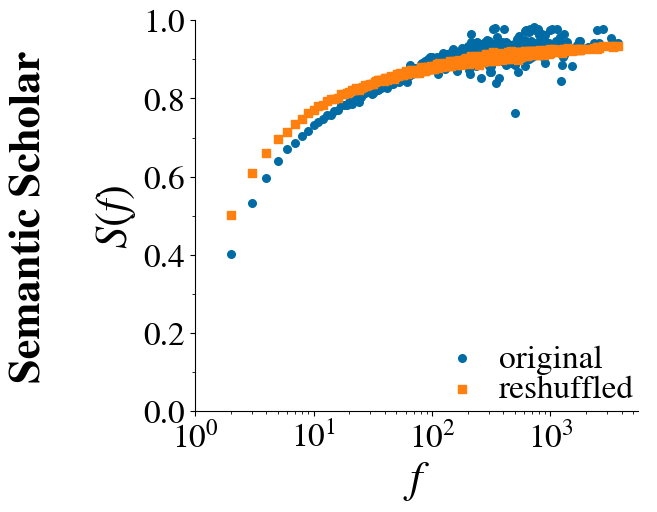

In [476]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Semantic Scholar', 
                    number_to_write = 0, 
                    write_number = False)
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a_old(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'Semantic Scholar', 
                    number_to_write = 0, 
                    write_number = False)

#### UMST

In [477]:
Tmax = int(1e5)
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
count = 0
for eta in [.1]:
    for rho in [4]:
        for nu in tqdm(range(10,11)):
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            dataset['mean_entropies'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            dataset['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
print(f"Found {count} simulations")

  0%|          | 0/1 [00:00<?, ?it/s]

Found 100 simulations


<AxesSubplot:xlabel='$f$', ylabel='$S(f)$'>

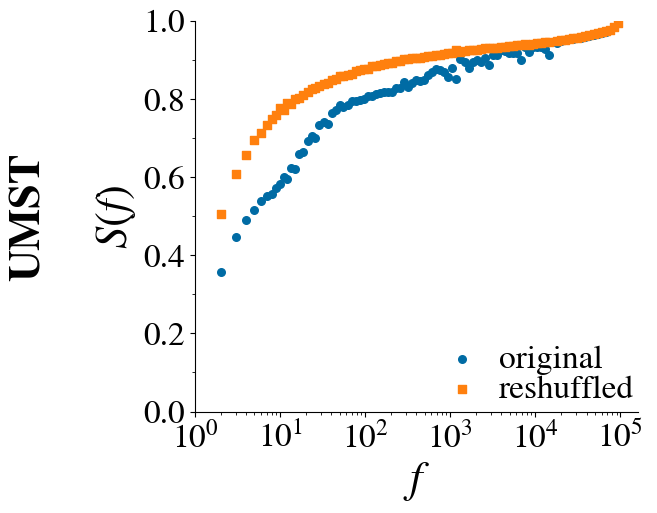

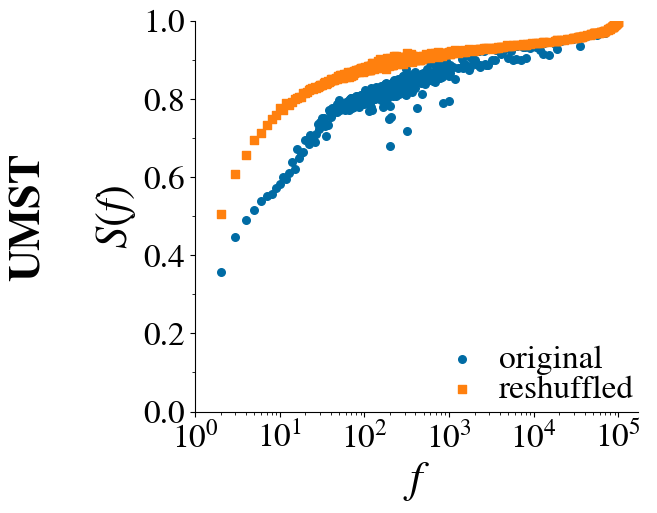

In [478]:
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'UMST', 
                    number_to_write = 0, 
                    write_number = False)
fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
fig_4_subplot_a_old(dataset, 
                    ax = ax, marker_size = 30, alpha = 1, 
                    dataset_label = 'UMST', 
                    number_to_write = 0, 
                    write_number = False)

  0%|          | 0/10 [00:00<?, ?it/s]

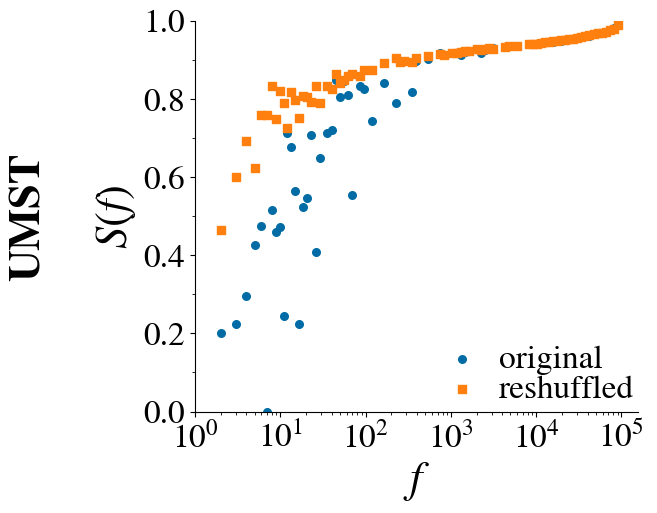

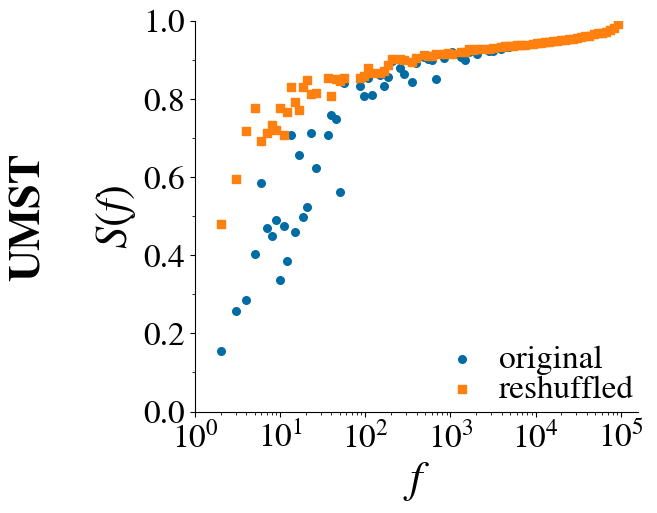

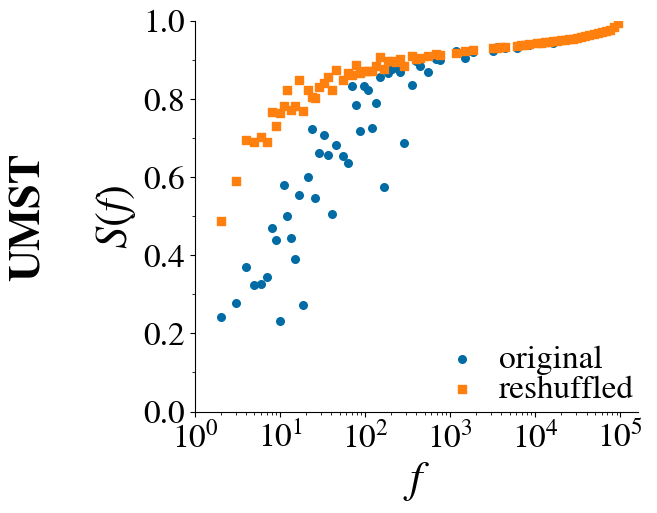

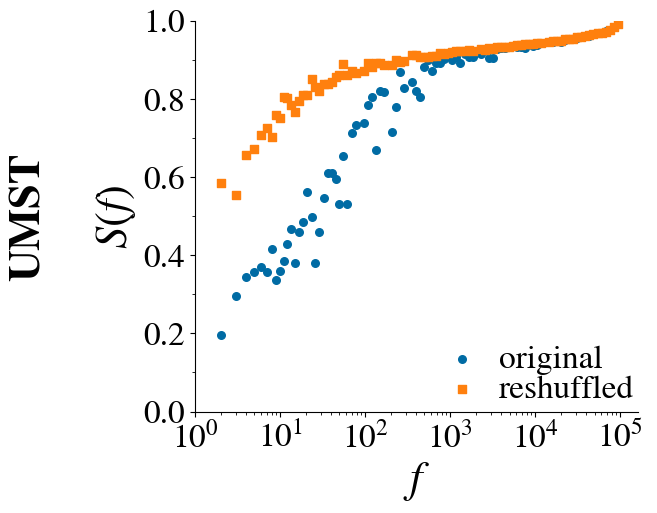

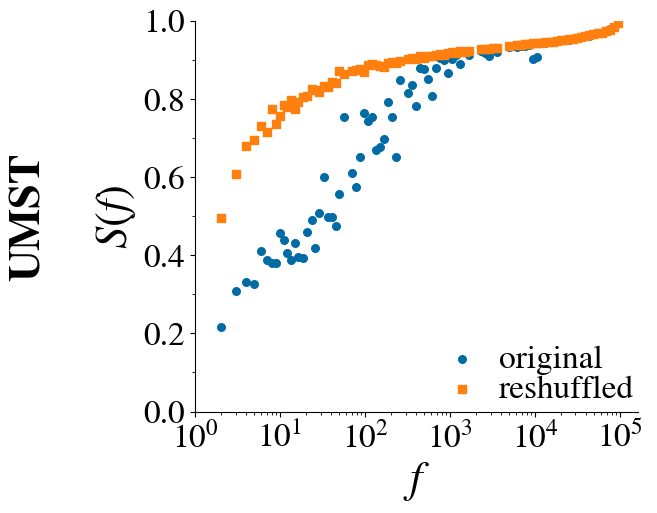

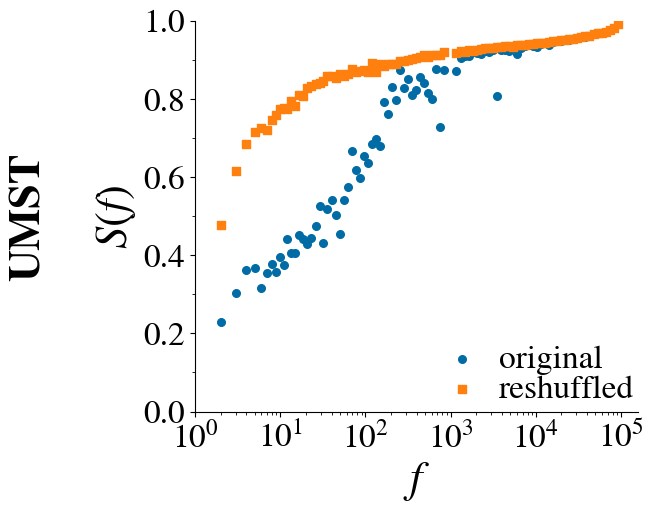

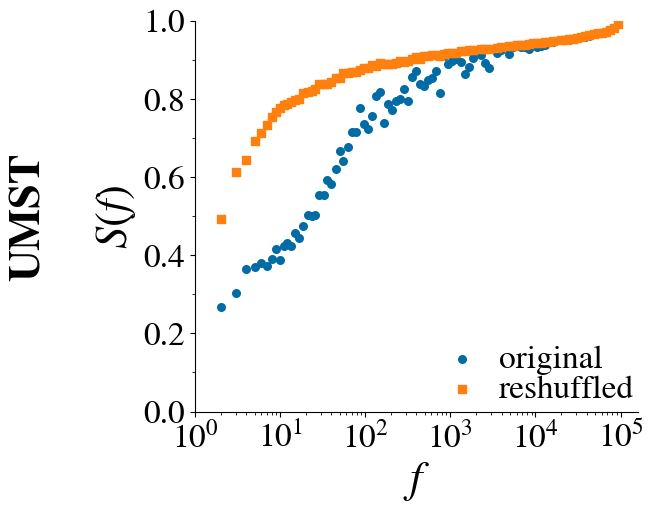

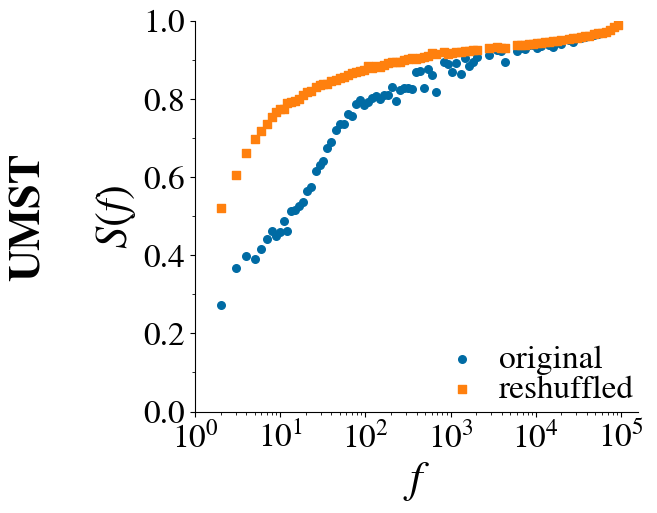

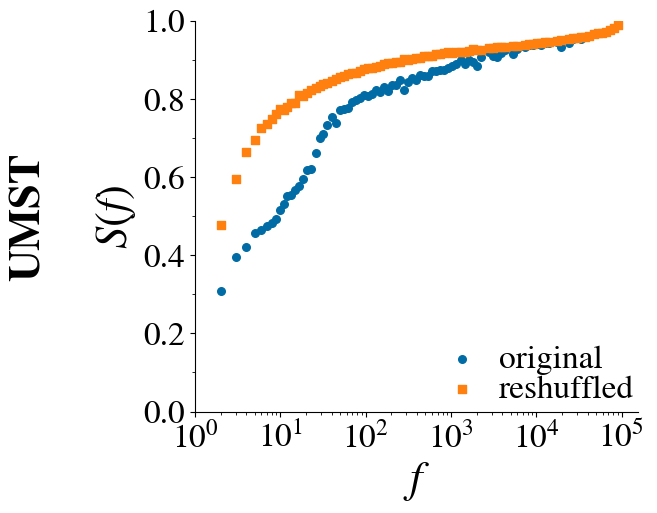

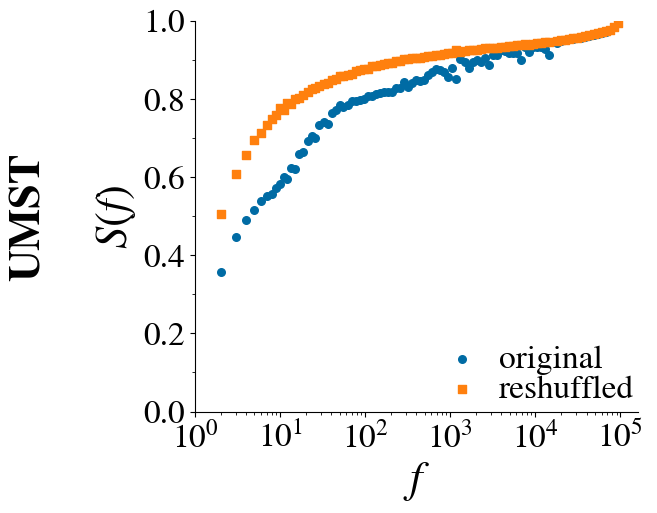

In [480]:
Tmax = int(1e5)
for eta in [.1]:
    for rho in [4]:
        for nu in tqdm(range(1,11)):
            dataset['mean_entropies'] = {}
            dataset['mean_entropies_glob'] = {}
            count = 0
            workdir = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
            for run in range(100):
                try:
                    with open(f"{workdir}UMT_run_{run}.pkl", 'rb') as fp:
                        result = pickle.load(fp)
                    for freq,value in result['mean_entropies'].items():
                        try:
                            dataset['mean_entropies'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies'][freq] = [value]
                    for freq,value in result['mean_entropies_glob'].items():
                        try:
                            dataset['mean_entropies_glob'][freq].append(value)
                        except KeyError:
                            dataset['mean_entropies_glob'][freq] = [value]
                    count += 1
                except:
                    pass
            
            fig,ax = plt.subplots(figsize=(width_fig/4,width_fig*2/3*1/3))
            fig_4_subplot_a(dataset, 
                                ax = ax, marker_size = 30, alpha = 1, 
                                dataset_label = 'UMST', 
                                number_to_write = 0, 
                                write_number = False)

# OLD Figure4: Entropy vs $\beta_1$

## Load data with entropy

In [ ]:
with gzip.open('./data/essential_entropy_data_for_figure4.pkl.gz', "rb") as fp:
    data_with_entropy = joblib.load(fp)

## Create data with entropy

Use this section only on the first run. Otherwise, just load the prepared data on the previous section

In [802]:
data_with_entropy = {}
data_with_entropy['Last.fm'] = {}
data_with_entropy['Project Gutenberg'] = {}
data_with_entropy['Semantic Scholar'] = {}
data_with_entropy['UMST'] = {}

### Last.fm

In [803]:
data_folder = "./data/ocelma-dataset/lastfm-dataset-1K/"
analysis_folder = data_folder

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
    try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
            result = joblib.load(fp)
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
    except:
        pass
print(count)
data_with_entropy['Last.fm'] = dataset.copy()

  0%|          | 0/890 [00:00<?, ?it/s]

890


### Gutenberg

In [804]:
data_folder = './data/gutenberg/data_processed/'
analysis_folder = './data/gutenberg/analysis/'

dataset = {}

paths = glob.glob(os.path.join(analysis_folder, 'individual_results_entropy','*.pkl'))

dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0
for path in tqdm(paths):
#     try:
        file_name = path[-path[::-1].index('/'):path.index('.pkl')]
        with open(path, 'rb') as fp:
            entropy_result = joblib.load(fp)
#         with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'rb') as fp:
#             result = joblib.load(fp)
        result = results_light_individual_gutenberg[file_name]
        for i_order,order in enumerate(['', '_pairs']):
            n_order = i_order + 1
            for freq,value in entropy_result[f'mean_entropies{order}'].items():
                try:
                    dataset[f'mean_entropies{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies{order}'][freq] = [value]
            for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                try:
                    dataset[f'mean_entropies_glob{order}'][freq].append(value)
                except KeyError:
                    dataset[f'mean_entropies_glob{order}'][freq] = [value]
        dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
        dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
        # Add also information on beta
        for n_order, order in enumerate(['','2','3','4'], start=1):
            dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
            dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
        # Add correct entropy difference to light result
        result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
        result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
        with open(os.path.join(analysis_folder, 'individual_results_light',f'{file_name}_light.pkl'), 'wb') as fp:
            pickle.dump(result,fp)
        count += 1
#     except:
#         pass
print(count)
data_with_entropy['Project Gutenberg'] = dataset.copy()

  0%|          | 0/19637 [00:00<?, ?it/s]

19637


### Semantic Scholar

In [862]:
corpus_version = '2022-01-01'
data_folder = os.path.join('./data/semanticscholar/data/', corpus_version) # where you save the data
analysis_folder = os.path.join('./data/semanticscholar/analysis/', corpus_version)
with open(os.path.join(data_folder,'all_fieldsOfStudy.tsv'), 'r', newline='\n') as fp:
    tsv_output = csv.reader(fp, delimiter='\n')
    all_fieldsOfStudy = [] 
    for _ in tsv_output:
        all_fieldsOfStudy.append(_[0])

dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_journals = 1000
for fieldOfStudy in tqdm(all_fieldsOfStudy):
    paths = sorted(find_pattern('*.pkl', os.path.join(analysis_folder, 'journals_fieldsOfStudy_entropy',fieldOfStudy)))
    if len(paths) != num_journals:
        print(f'Error! Found {len(paths)} journals for {fieldOfStudy} instead of {num_journals}')
#         break

    for path in tqdm(paths):
        try:
            file_name = path[-path[::-1].index('/'):path.index('.pkl')]
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            try:
                os.rename(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}.pkl'), os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'))
            except:
                pass
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy,f'{file_name}_light.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
            result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
            result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
            with open(os.path.join(analysis_folder, 'journals_fieldsOfStudy_light', fieldOfStudy, f'{file_name}_light.pkl'), 'wb') as fp:
                pickle.dump(result,fp)
            count += 1
        except:
            pass
print(count)
data_with_entropy['Semantic Scholar'] = dataset.copy()

  0%|          | 0/19 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

19000


### UMST

In [863]:
Tmax = int(1e5)
eta = .1
rho = 4
starting_nu = 1
ending_nu = 20


dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass
print(count)
data_with_entropy['UMST'] = dataset.copy()

  0%|          | 0/20 [00:00<?, ?it/s]

2000


  0%|          | 0/20 [00:00<?, ?it/s]

100


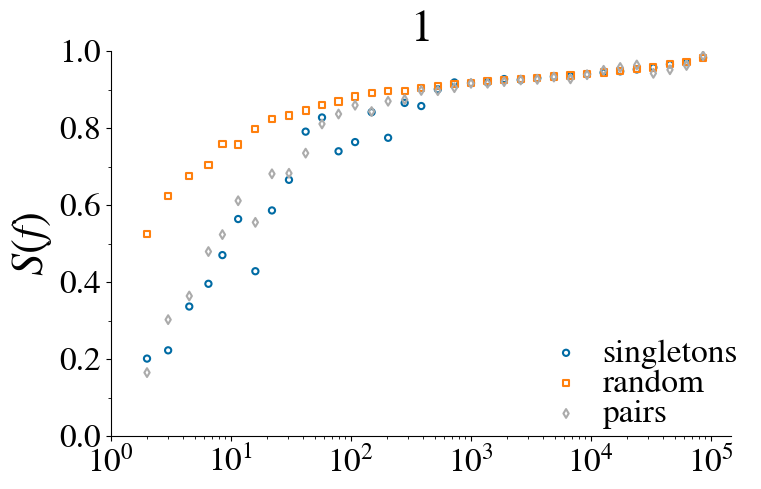

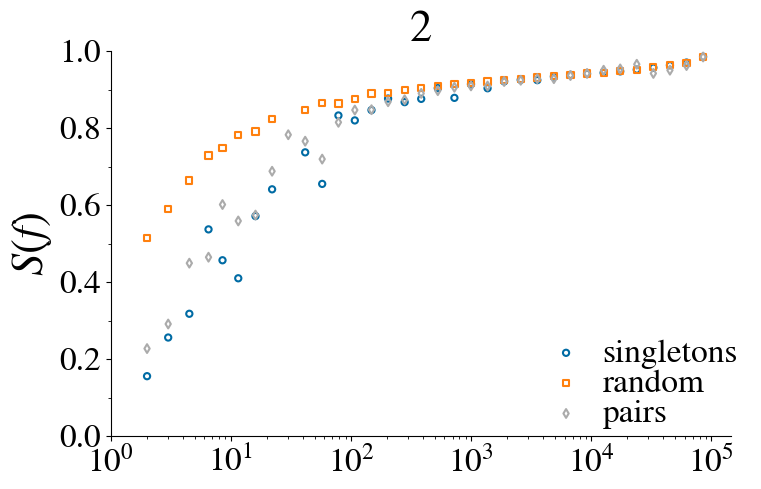

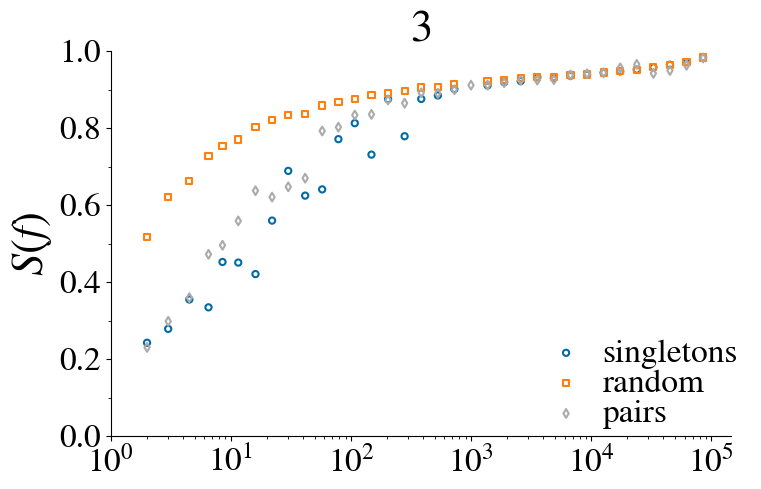

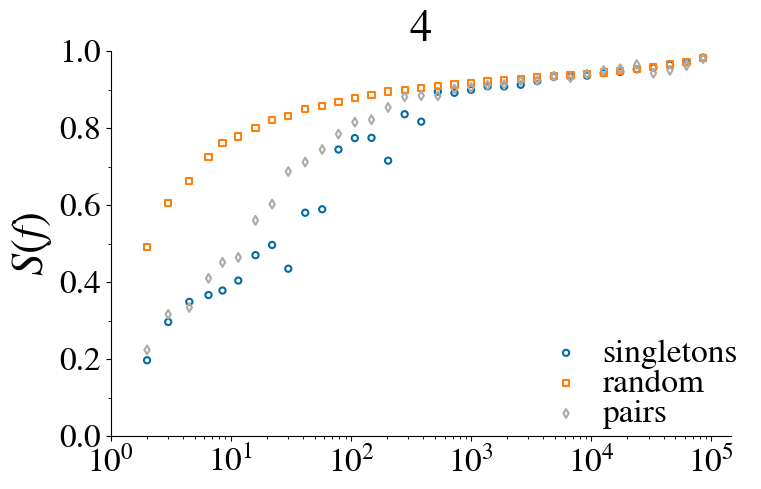

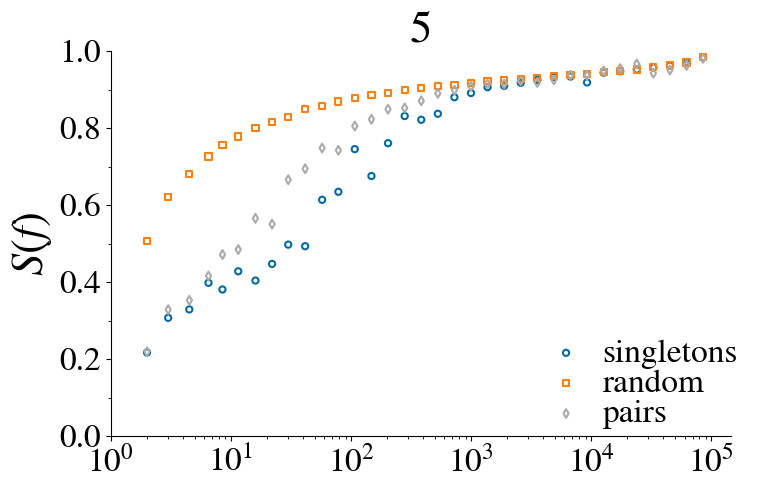

...

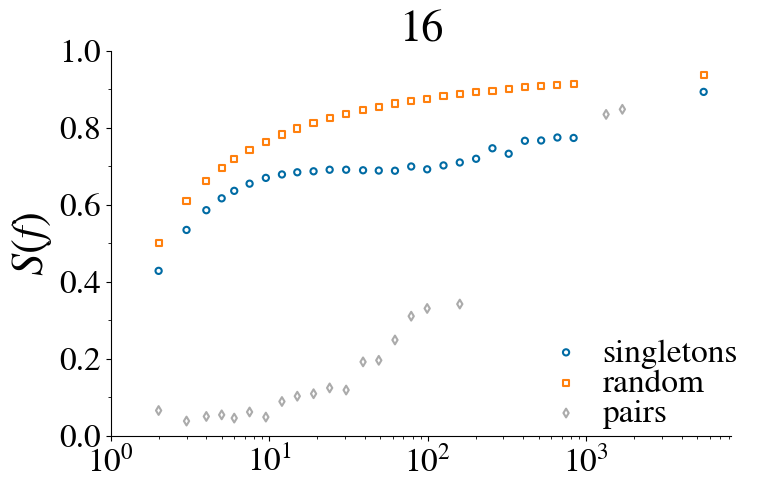

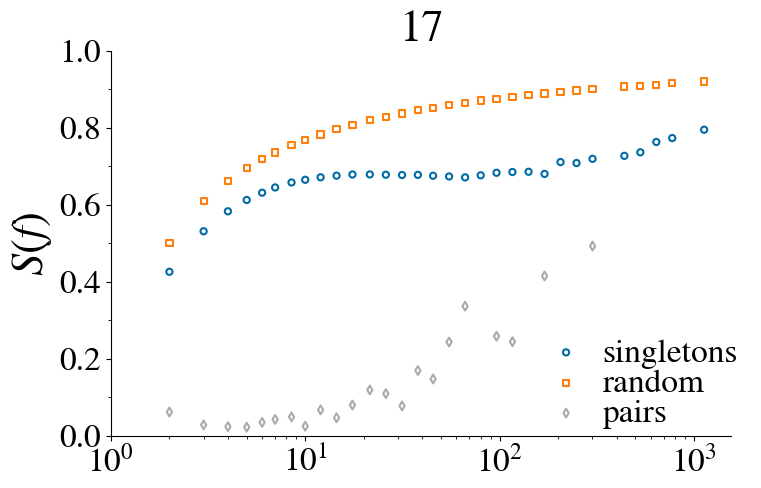

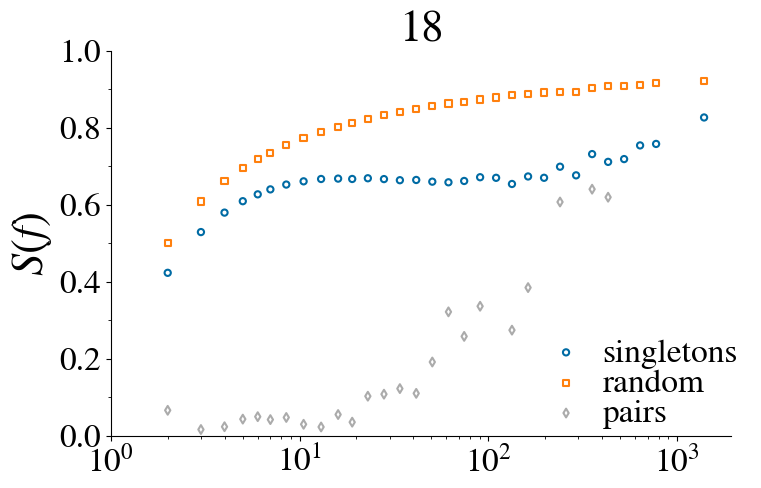

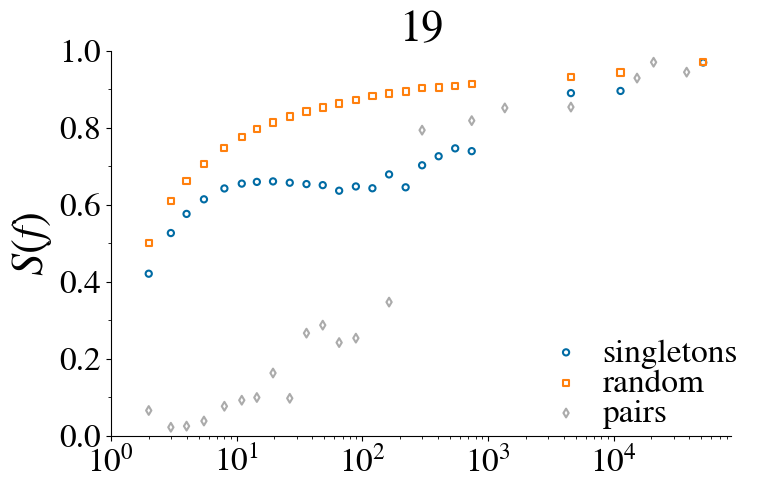

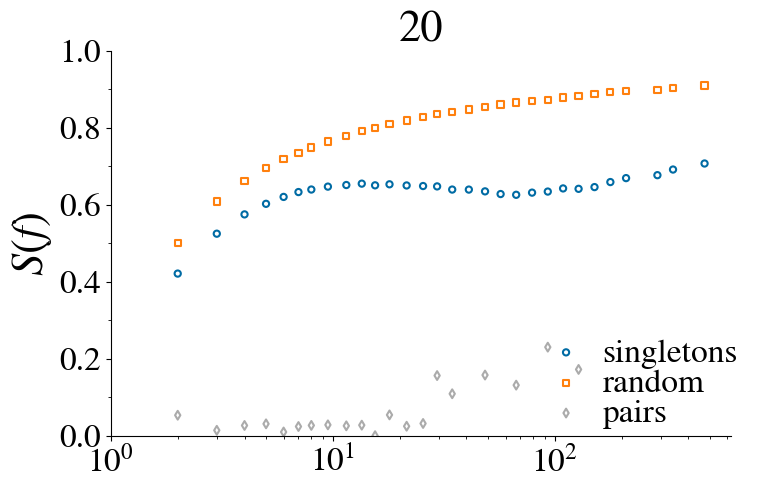

In [857]:
Tmax = int(1e5)
eta = .1
rho = 4
starting_nu = 1
ending_nu = 20



num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    fig,ax = plt.subplots(figsize=(8,5))
    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            with open(path, 'rb') as fp:
                entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass
    fig_4_subplot_a(dataset, 
                        ax = ax, dataset_label = None,
                        marker_size = 20, alpha = 1, 
                        number_to_write = 0, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = None, write_number = False,
                       )
    ax.set_title(nu)
print(count)
# data_with_entropy['UMST'] = dataset.copy()

### LOAD ERRW

In [1015]:
ERRW_data = {}

In [1016]:
field = "astro"
dw = 330
with open(f"./data/ERRW/web_of_science/{field}_abs2_net_dw{dw}_seqs.p", "rb") as fp:
    ERRW_data[(field, dw)] = pickle.load(fp, encoding='latin1')

In [1017]:
field = "mat"
dw = 20
with open(f"./data/ERRW/web_of_science/{field}_abs2_net_dw{dw}_seqs.p", "rb") as fp:
    ERRW_data[(field, dw)] = pickle.load(fp, encoding='latin1')

In [1021]:
[len(value) for value in ERRW_data.values()]

[30, 35]

In [1028]:
ERRW_betas = {key:[np.log10(len(set(_)))/np.log10(len(_)) for _ in value] for key,value in ERRW_data.items()}

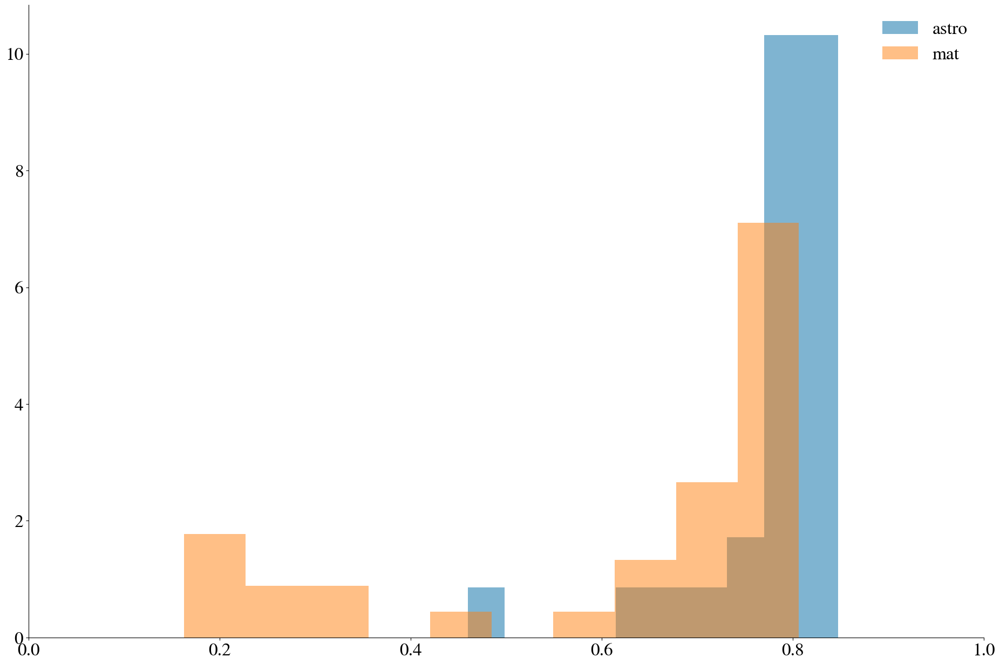

In [1031]:
for key,betas in ERRW_betas.items():
    plt.hist(betas,density=True,label = key, alpha=0.5)
    plt.xlim(0,1)
    plt.legend()

### Tries on UMST diff eta

In [872]:
UMST_data_with_entropy = {}

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0.1	10	199


  0%|          | 0/20 [00:00<?, ?it/s]

0.2	10	196


  0%|          | 0/20 [00:00<?, ?it/s]

0.30000000000000004	10	189


  0%|          | 0/20 [00:00<?, ?it/s]

0.4	10	191


  0%|          | 0/20 [00:00<?, ?it/s]

0.5	10	195


  0%|          | 0/20 [00:00<?, ?it/s]

0.6	10	193


  0%|          | 0/20 [00:00<?, ?it/s]

0.7000000000000001	10	194


  0%|          | 0/20 [00:00<?, ?it/s]

0.8	10	187


  0%|          | 0/20 [00:00<?, ?it/s]

0.9	10	189


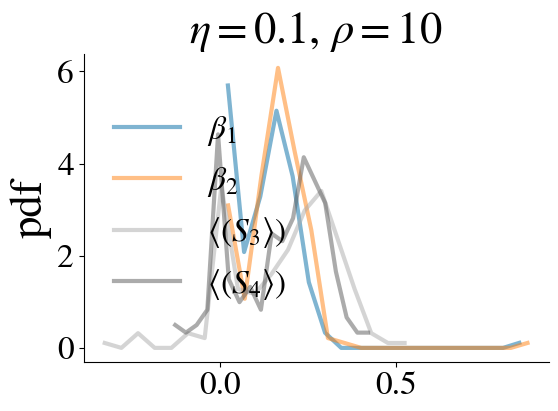

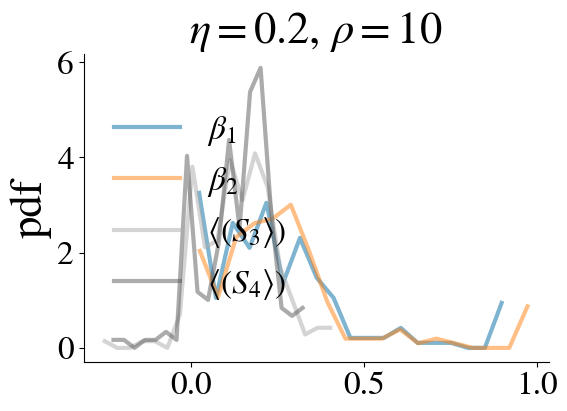

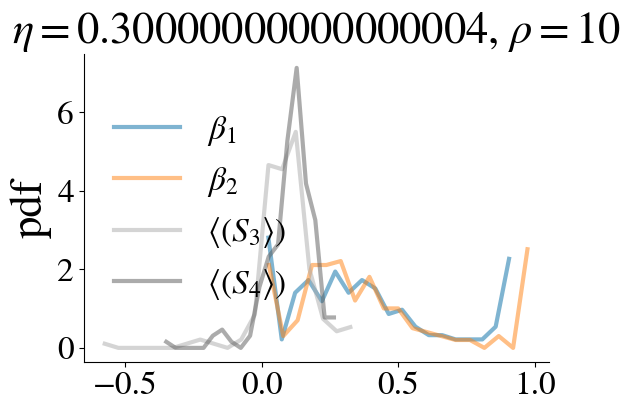

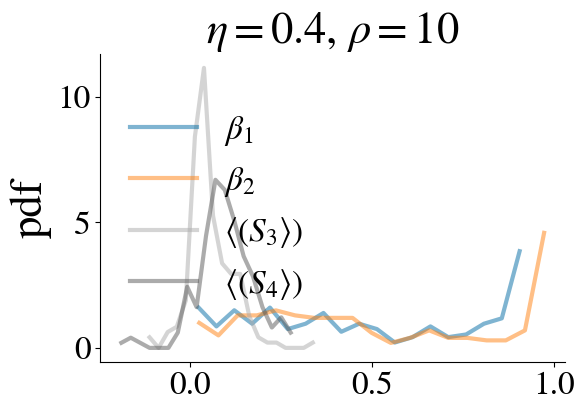

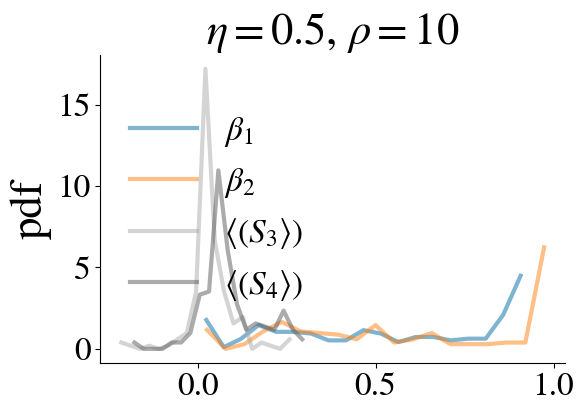

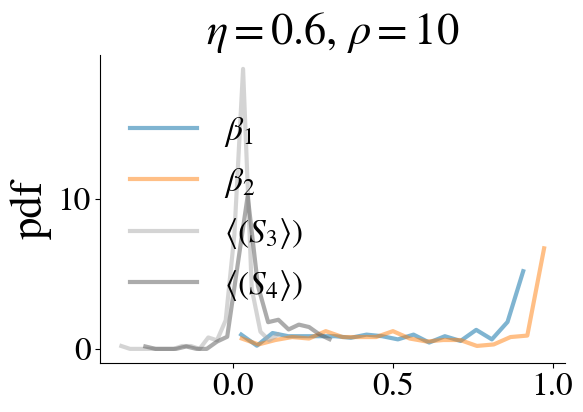

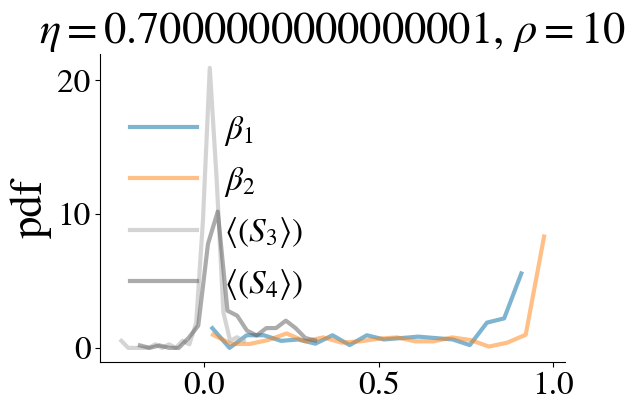

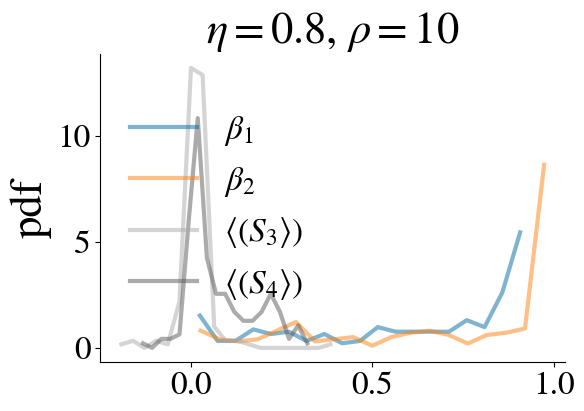

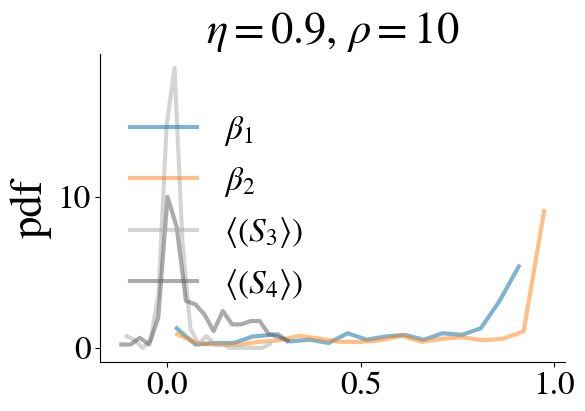

In [884]:
Tmax = int(1e5)
for eta in tqdm(np.arange(0.1,1,step=.1)):
    rho = 10
    starting_nu = 1
    ending_nu = 20


    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    
    if count > 0:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2', 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, '--', color='gray')
        ax.legend(loc='center left')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)


    print(eta, rho,count, sep = "\t")
    UMST_data_with_entropy[(eta, rho)] = dataset.copy()

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0.1	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.2	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.30000000000000004	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.4	10	200


  0%|          | 0/20 [00:00<?, ?it/s]

0.5	10	200


  0%|          | 0/16 [00:00<?, ?it/s]

0.6	10	160


  0%|          | 0/14 [00:00<?, ?it/s]

0.7000000000000001	10	140


  0%|          | 0/12 [00:00<?, ?it/s]

0.8	10	120


  0%|          | 0/11 [00:00<?, ?it/s]

0.9	10	110


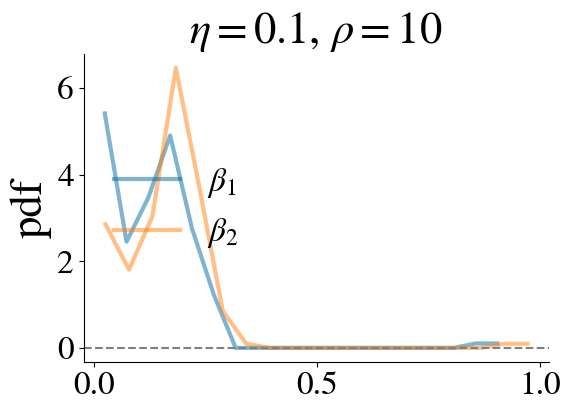

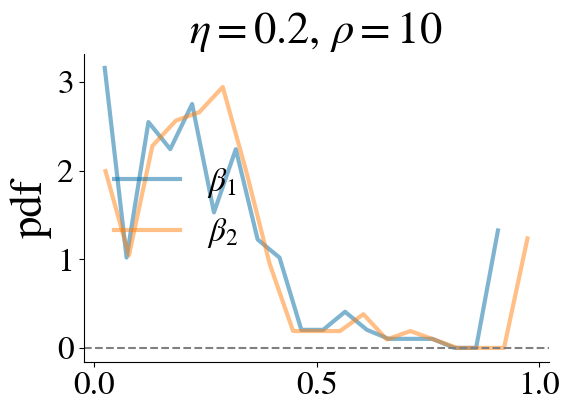

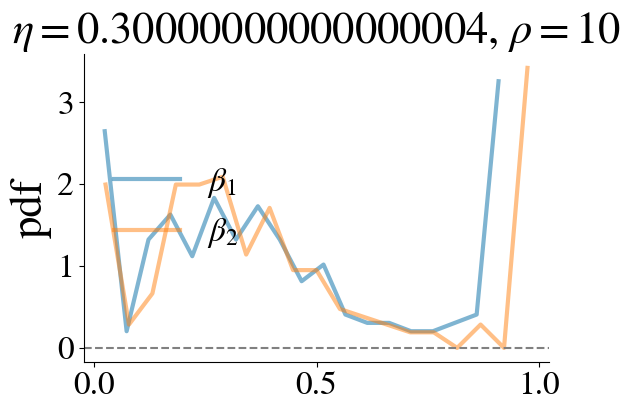

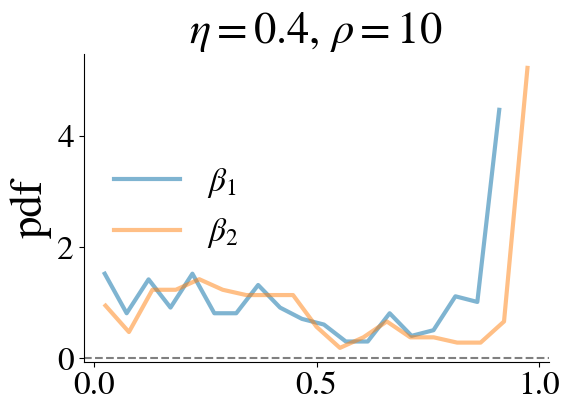

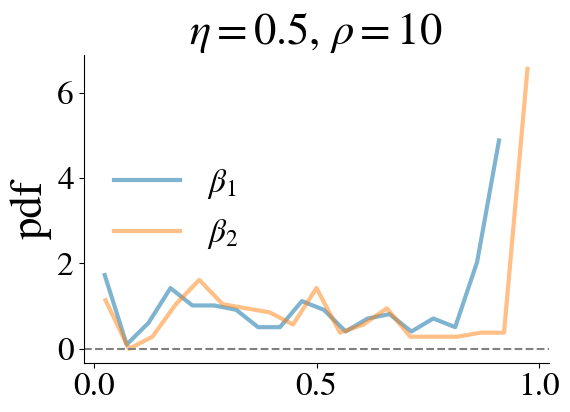

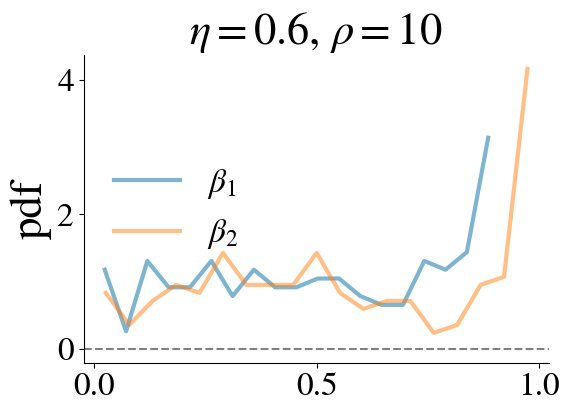

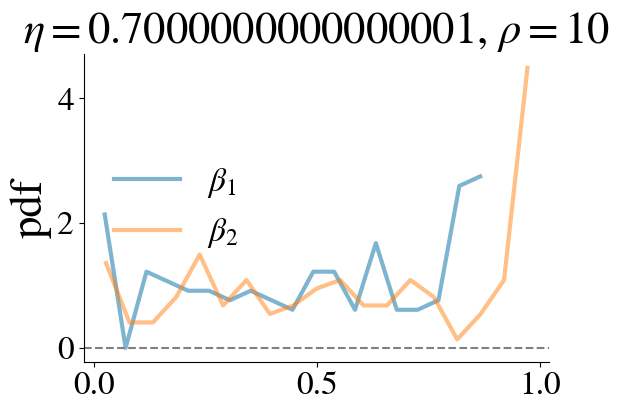

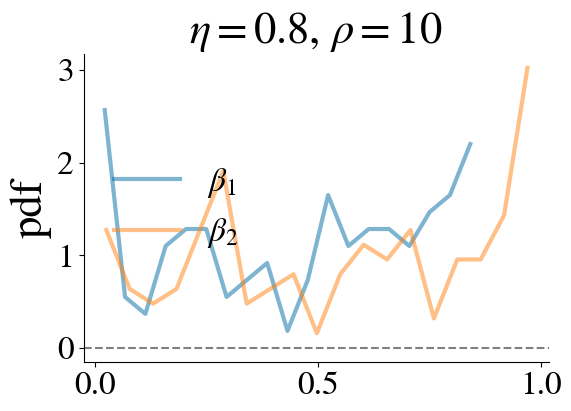

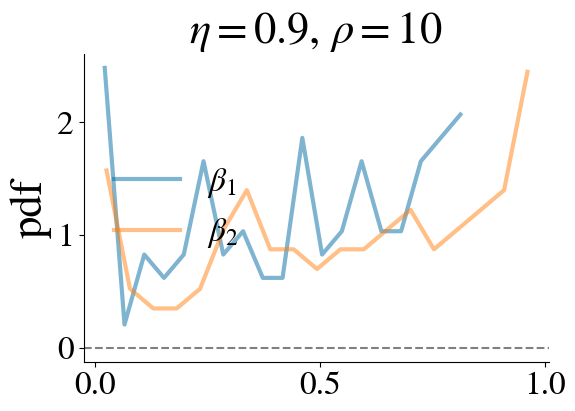

In [887]:
Tmax = int(1e5)
for eta in tqdm(np.arange(0.1,1,step=.1)):
    rho = 10
    starting_nu = 1
    ending_nu = min(20, int(rho/eta))


    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    
    if count > 0:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='center left')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)


    print(eta, rho,count, sep = "\t")
    UMST_data_with_entropy[(eta, rho)] = dataset.copy()

#### Try specific

In [958]:
marker_size = 20
alpha_scatter = 1

##### eta 0.5 rho 20

  0%|          | 0/7 [00:00<?, ?it/s]

0.5	20	700


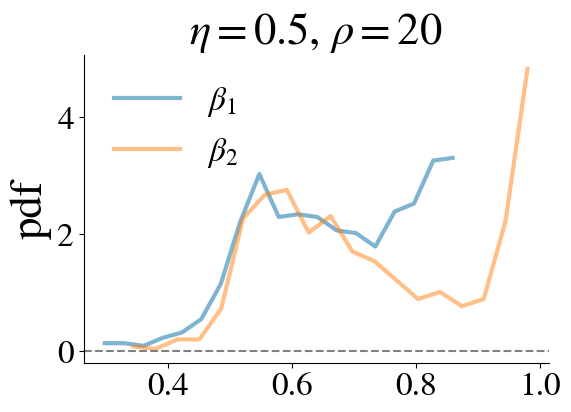

In [994]:
Tmax = int(1e5)
eta = 0.5
rho = 20
starting_nu = 20
ending_nu = 26 #min(20, int(rho/eta))


dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            except:
                path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass

if count > 0:
    fig,ax = plt.subplots(figsize=(6,4))
    num_bins = 20
    for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
        data_to_hist = dataset[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
    ax.axhline(0, ls='--', color='gray')
    ax.legend(loc='best')
    ax.set_ylabel('pdf')
    ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
    fig.add_subplot(ax)


print(eta, rho,count, sep = "\t")
UMST_data_with_entropy[(eta, rho)] = dataset.copy()

p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 3.193685770203051e-86
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 6.9806196563161895e-15
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 9.005430196404126e-76
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 2.9318616993782767e-157


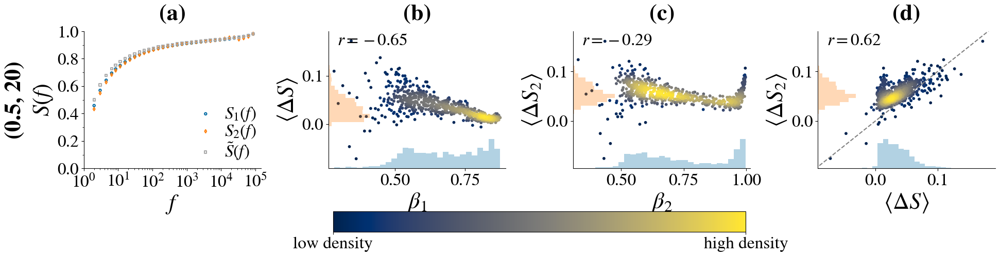

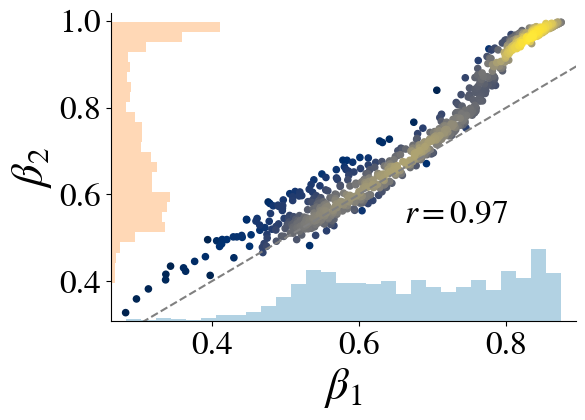

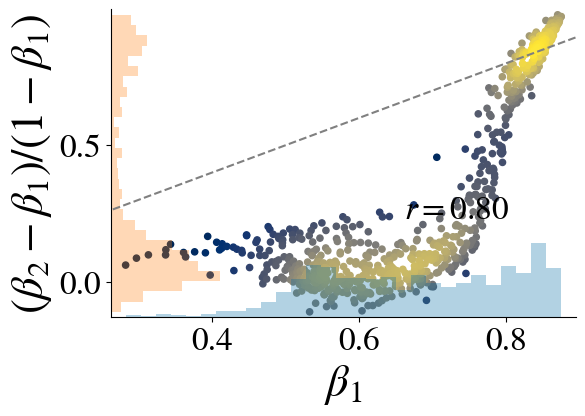

In [995]:
eta = 0.5
rho = 20
dataset_dict = UMST_data_with_entropy[(eta,rho)]
fig = fig_4({(eta,rho):dataset_dict}, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )


fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'])
y = np.array(dataset_dict[f'betas{2}'])
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$\beta_{2}$", xlabel = fr"$\beta_{1}$", 
#                   min_x=0, max_x=1, min_y=0, max_y=1,
                 )
fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'])
y = np.array(dataset_dict[f'betas{2}'])
y = (y-x)/(1-x)
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$(\beta_{2} - \beta_{1}) / (1 - \beta_{1})$", xlabel = fr"$\beta_{1}$", 
#                   min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                 )

##### eta 0.25 rho 10

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

0.25	10	2000


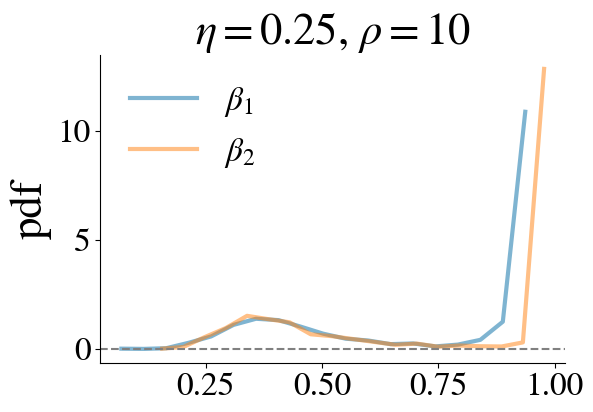

In [956]:
Tmax = int(1e5)
eta = 0.25
rho = 10
starting_nu = 11
ending_nu = 30 #min(20, int(rho/eta))


dataset = {}
dataset['mean_entropies'] = {}
dataset['mean_entropies_glob'] = {}
dataset['mean_entropies_pairs'] = {}
dataset['mean_entropies_glob_pairs'] = {}
dataset['weighted_diff_entropies'] = []
dataset['weighted_diff_entropies_pairs'] = []
for n_order, order in enumerate(['','2','3','4'], start=1):
    dataset[f'betas{order}'] = []
    dataset[f'intercepts{order}'] = []
count = 0

num_runs = 100
for nu in tqdm(range(starting_nu, ending_nu+1)):
    data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
    analysis_folder = data_folder
    for run in range(num_runs):
        path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
        try:
            try:
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            except:
                path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                with open(path, 'rb') as fp:
                    entropy_result = joblib.load(fp)
            with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                result = joblib.load(fp)
            for i_order,order in enumerate(['', '_pairs']):
                n_order = i_order + 1
                for freq,value in entropy_result[f'mean_entropies{order}'].items():
                    try:
                        dataset[f'mean_entropies{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies{order}'][freq] = [value]
                for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                    try:
                        dataset[f'mean_entropies_glob{order}'][freq].append(value)
                    except KeyError:
                        dataset[f'mean_entropies_glob{order}'][freq] = [value]
            dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
            dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
            # Add also information on beta
            for n_order, order in enumerate(['','2','3','4'], start=1):
                dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
            # Add correct entropy difference to light result
#             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
#             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
#             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
#                 pickle.dump(result,fp)
            count += 1
        except:
            pass

if count > 0:
    fig,ax = plt.subplots(figsize=(6,4))
    num_bins = 20
    for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
        data_to_hist = dataset[key]
        hist,bin_edges = np.histogram(data_to_hist, 
                np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                density=True)
        bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
        p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
    ax.axhline(0, ls='--', color='gray')
    ax.legend(loc='best')
    ax.set_ylabel('pdf')
    ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
    fig.add_subplot(ax)


print(eta, rho,count, sep = "\t")
UMST_data_with_entropy[(eta, rho)] = dataset.copy()

p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 2.1569768867462946e-36
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 9.060272080652131e-30
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 1.2502086413776855e-97
p-value pearson between $\beta_1$ and $\beta_2$ 5.96584e-319
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 5.971675948896435e-77


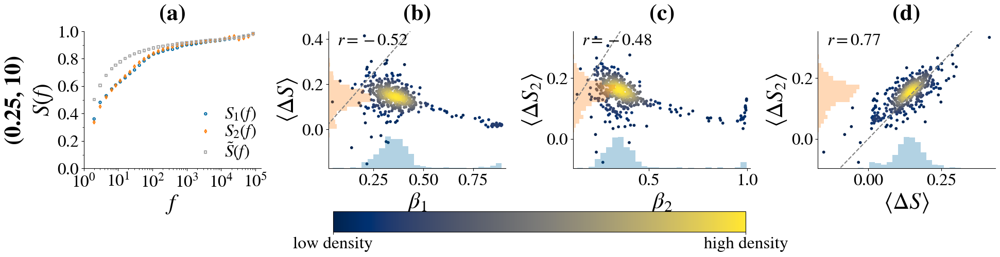

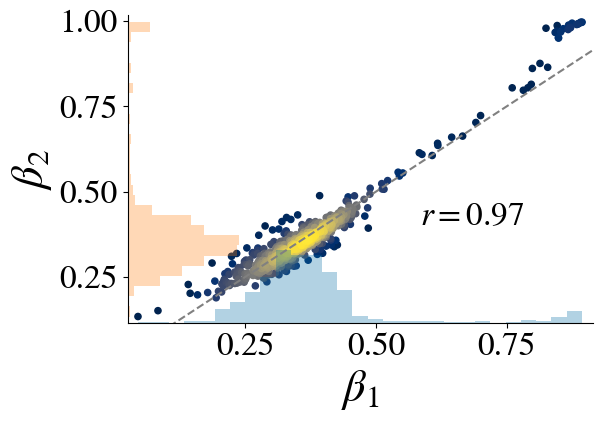

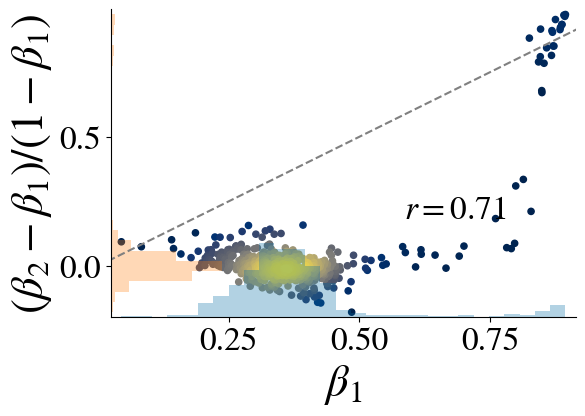

In [996]:
eta = 0.25
rho = 10
dataset_dict = UMST_data_with_entropy[(eta,rho)]
fig = fig_4({(eta,rho):dataset_dict}, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )


fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$\beta_{2}$", xlabel = fr"$\beta_{1}$", 
#                   min_x=0, max_x=1, min_y=0, max_y=1,
                 )
fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
y = (y-x)/(1-x)
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$(\beta_{2} - \beta_{1}) / (1 - \beta_{1})$", xlabel = fr"$\beta_{1}$", 
#                   min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                 )

##### eta 0.1 rho 4

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

0.1	4	1100


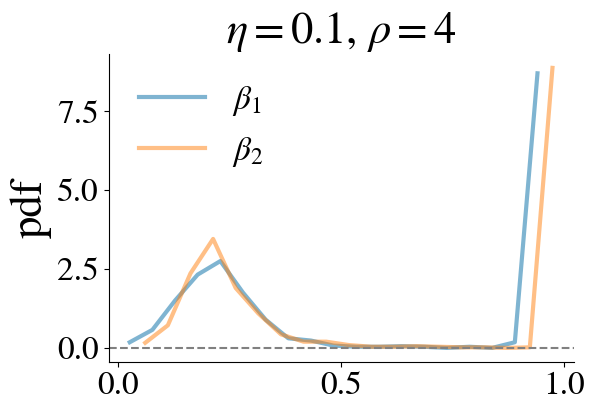

In [968]:
Tmax = int(1e5)
for i,eta in enumerate(tqdm(np.arange(0.1,0.11,step=.1))):
    rho = 4
    starting_nu = 4
    ending_nu = 15 #min(20, int(rho/eta))


    dataset = {}
    dataset['mean_entropies'] = {}
    dataset['mean_entropies_glob'] = {}
    dataset['mean_entropies_pairs'] = {}
    dataset['mean_entropies_glob_pairs'] = {}
    dataset['weighted_diff_entropies'] = []
    dataset['weighted_diff_entropies_pairs'] = []
    for n_order, order in enumerate(['','2','3','4'], start=1):
        dataset[f'betas{order}'] = []
        dataset[f'intercepts{order}'] = []
    count = 0

    num_runs = 100
    for nu in tqdm(range(starting_nu, ending_nu+1)):
        data_folder = f"./data/simulations/rho_{rho:.5f}/nu_{nu}/Tmax_{Tmax}/eta_{eta:.5f}/"
        analysis_folder = data_folder
        for run in range(num_runs):
            path = os.path.join(analysis_folder,f'UMT_entropy_run_{run}.pkl')
            try:
                try:
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                except:
                    path = os.path.join(analysis_folder,f'UMT_entropies_run_{run}.pkl')
                    with open(path, 'rb') as fp:
                        entropy_result = joblib.load(fp)
                with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'rb') as fp:
                    result = joblib.load(fp)
                for i_order,order in enumerate(['', '_pairs']):
                    n_order = i_order + 1
                    for freq,value in entropy_result[f'mean_entropies{order}'].items():
                        try:
                            dataset[f'mean_entropies{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies{order}'][freq] = [value]
                    for freq,value in entropy_result[f'mean_entropies_glob{order}'].items():
                        try:
                            dataset[f'mean_entropies_glob{order}'][freq].append(value)
                        except KeyError:
                            dataset[f'mean_entropies_glob{order}'][freq] = [value]
                dataset['weighted_diff_entropies'].append(entropy_result['weighted_diff_entropies'])
                dataset['weighted_diff_entropies_pairs'].append(entropy_result['weighted_diff_entropies_pairs'])
                # Add also information on beta
                for n_order, order in enumerate(['','2','3','4'], start=1):
                    dataset[f'betas{order}'].append(result[f'beta{order}_loglogregr_indices_geom'][-1])
                    dataset[f'intercepts{order}'].append(result[f'intercept{order}_loglogregr_indices_geom'][-1])
                # Add correct entropy difference to light result
    #             result['weighted_diff_entropies'] = entropy_result['weighted_diff_entropies']
    #             result['weighted_diff_entropies_pairs'] = entropy_result['weighted_diff_entropies_pairs']
    #             with open(os.path.join(analysis_folder,f'UMT_light_run_{run}.pkl'), 'wb') as fp:
    #                 pickle.dump(result,fp)
                count += 1
            except:
                pass
    
    if count > 0:
        fig,ax = plt.subplots(figsize=(6,4))
        num_bins = 20
        for order,key in enumerate(['betas', 'betas2']):#, 'weighted_diff_entropies', 'weighted_diff_entropies_pairs']):
            data_to_hist = dataset[key]
            hist,bin_edges = np.histogram(data_to_hist, 
                    np.linspace(np.min(data_to_hist), np.max(data_to_hist), num_bins), 
                    density=True)
            bin_centers = (bin_edges[1:]+bin_edges[:-1])/2
            p = ax.plot(bin_centers, hist, alpha=0.5,lw=3, label = r"$\beta_%d$"%(order+1) if order<2 else r"$\langle( S_%d \rangle)$"%(order+1))
        ax.axhline(0, ls='--', color='gray')
        ax.legend(loc='best')
        ax.set_ylabel('pdf')
        ax.set_title(r'$\eta = %s$, $\rho = %s$'%(str(eta), str(rho)))
        fig.add_subplot(ax)


    print(eta, rho,count, sep = "\t")
    UMST_data_with_entropy[(eta, rho)] = dataset.copy()

p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 0.0
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 1.0703085232010275e-160
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 4.1051698267259884e-58
p-value pearson between $\beta_1$ and $\beta_2$ 0.0
p-value pearson between $\beta_1$ and $(\beta_2 - \beta_1) / (1 - \beta_1)$ 0.0


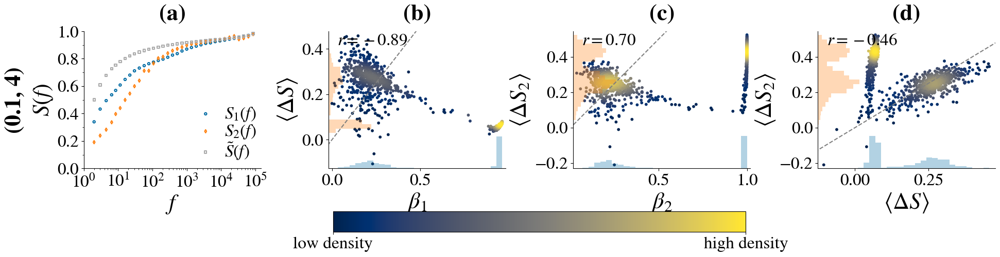

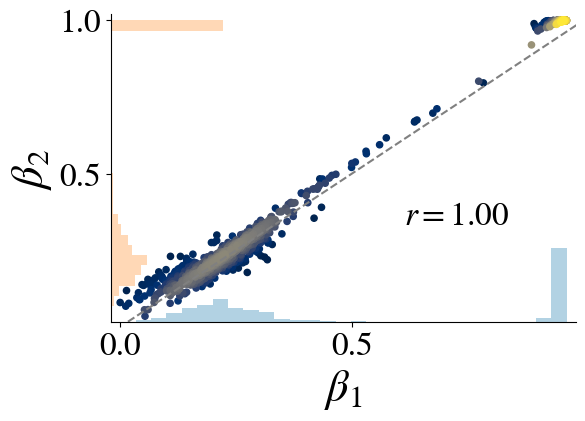

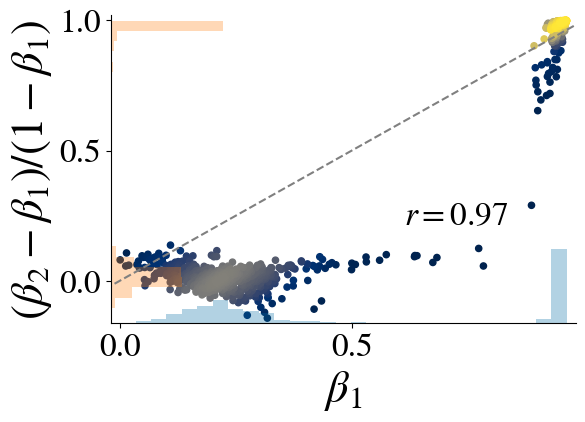

In [997]:
eta = 0.1
rho = 4
dataset_dict = UMST_data_with_entropy[(eta,rho)]
fig = fig_4({(eta,rho):dataset_dict}, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )


fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$\beta_{2}$", xlabel = fr"$\beta_{1}$", 
#                   min_x=0, max_x=1, min_y=0, max_y=1,
                 )
fig,ax=plt.subplots(figsize=(6,4))
x = np.array(dataset_dict[f'betas'][:1000])
y = np.array(dataset_dict[f'betas{2}'][:1000])
y = (y-x)/(1-x)
fig_1_subplot_b_d(x, y, 
                  ax = ax, 
                  marker_size = marker_size, alpha_scatter = alpha_scatter,
                  ylabel = fr"$(\beta_{2} - \beta_{1}) / (1 - \beta_{1})$", xlabel = fr"$\beta_{1}$", 
#                   min_x=min_beta, max_x=max_beta, min_y=min_beta_higher, max_y=max_beta_higher,
                 )

### Dump data

In [864]:
with gzip.open('./data/essential_entropy_data_for_figure4.pkl.gz', "wb") as fp:
    joblib.dump(data_with_entropy, fp)
print('Dumped')

Dumped


## Functions

In [473]:
def fig_4_subplot_a_old(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
#        # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them
    ax.scatter(
        [freq  for freq,value in result["mean_entropies"].items()],
        [np.mean(value)  for freq,value in result["mean_entropies"].items()],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    ax.scatter(
        [freq for freq,value in result["mean_entropies_glob"].items()],
        [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them binned
#     x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
#     x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     max_x = max(x)
#     min_x = min(x)
#     num_bins = 100
#     x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#     x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
#     y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
#     y_bins_count = np.zeros(len(x_bins_centers))
#     y_bins_sum = np.zeros(len(x_bins_centers))
#     for index,freq in enumerate(x):
#         value = y[index]
#         for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
#             if freq < x_bins_lim_right:
#                 break
#         y_bins_sum[index_bin] += value
#         y_bins_count[index_bin] += 1
#     y_bins = np.zeros(len(x_bins_centers))
#     for index,y_sum in enumerate(y_bins_sum):
#         y_count = y_bins_count[index]
#         if y_count > 0:
#             y_bins[index] = y_sum / y_count
# #     y_bins = y_bins_sum / y_bins_count
#     ax.scatter(
#         [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
#         [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [668]:
def fig_4_subplot_a_old2(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq  for freq,values in result["mean_entropies"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        rasterized = True, label=r"original", alpha=alpha, s=marker_size)
    
    x = [freq  for freq,values in result["mean_entropies_glob"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = 100
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    y = [value  for freq,values in result["mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
        ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.08, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [1003]:
def fig_4_subplot_a(result, 
                    ax = None, marker_size = 20, alpha = 0.5, 
                    dataset_label = None, 
                    number_to_write = 0, 
                    num_bins = 35,
                    xlim_left = 1, xlim_right = None, 
                    ylim_bottom = 0, ylim_top = 1, 
                    ylabel = r"$S(f)$", xlabel = r"$f$", 
                    write_number = False):
    if ax == None:
        fig, ax = plt.subplots()
       # orig 
#     ax.scatter(list(result["mean_entropies"].keys()),list(result["mean_entropies"].values()), rasterized = True, label=r"original", alpha=alpha)
#     ax.scatter(list(result["mean_entropies_glob"].keys()),list(result["mean_entropies_glob"].values()), marker='s', rasterized = True, label=r"reshuffled", alpha=alpha)
    # with all of them
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies"].items() for freq,value in tmp_dict.items()], 
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()],
#         [value for tmp_i, tmp_dict in result["mean_entropies_glob"].items() for freq,value in tmp_dict.items()], 
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
#     # with average of them
#     ax.scatter(
#         [freq  for freq,value in result["mean_entropies"].items()],
#         [np.mean(value)  for freq,value in result["mean_entropies"].items()],
#         rasterized = True, label=r"original", alpha=alpha, s=marker_size)
#     ax.scatter(
#         [freq for freq,value in result["mean_entropies_glob"].items()],
#         [np.mean(value) for freq,value in result["mean_entropies_glob"].items()],
#         marker='s', rasterized = True, label=r"reshuffled", alpha=alpha, s=marker_size)
    # with average of them binned
    x = [freq for i_order,order in enumerate(['', '_pairs']) for freq,values in result[f"mean_entropies{order}"].items() for value in values]
    max_x = max(x)
    min_x = min(x)
    num_bins = num_bins
    x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
    x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2

    cycler = ax._get_lines.prop_cycler # to get the cycle of colors to use
    
    for i_order,order in enumerate(['', '_pairs']):
        n_order = i_order + 1  
        x = [freq  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
#         max_x = max(x)
#         min_x = min(x)
#         num_bins = num_bins
#         x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#         x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
        y = [value  for freq,values in result[f"mean_entropies{order}"].items() for value in values]
        y_bins_count = np.zeros(len(x_bins_centers))
        y_bins_sum = np.zeros(len(x_bins_centers))
        for index,freq in enumerate(x):
            value = y[index]
            for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
                if freq < x_bins_lim_right:
                    break
            y_bins_sum[index_bin] += value
            y_bins_count[index_bin] += 1
        y_bins = np.zeros(len(x_bins_centers))
        for index,y_sum in enumerate(y_bins_sum):
            y_count = y_bins_count[index]
            if y_count > 0:
                y_bins[index] = y_sum / y_count
    #     y_bins = y_bins_sum / y_bins_count
        if i_order == 1:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            marker='d', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=1.5, label=r'$S_2(f)$', alpha=alpha, s=marker_size) # r"$\mathcal{S}_{%d}$"%n_order
        else:
#         if i_order == 0:
            ax.scatter(
            [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
            [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
            rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
                linewidth=1.5, label=r'$S_1(f)$', alpha=alpha, s=marker_size) # r"$\mathcal{Q}_{%d}$"%n_order
        
#             x = [freq  for freq,values in result[f"mean_entropies_glob{order}"].items() for value in values]
#             max_x = max(x)
#             min_x = min(x)
#             x_bins_lim = np.array([min_x-0.5] + list(np.array(np.unique(np.geomspace(min_x, max_x, num = num_bins, dtype=int)),dtype=float) + 0.5))
#             x_bins_centers = (x_bins_lim[1:] + x_bins_lim[:-1]) / 2
    x = [freq  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y = [value  for freq,values in result[f"mean_entropies_glob"].items() for value in values]
    y_bins_count = np.zeros(len(x_bins_centers))
    y_bins_sum = np.zeros(len(x_bins_centers))
    for index,freq in enumerate(x):
        value = y[index]
        for index_bin, x_bins_lim_right in enumerate(x_bins_lim[1:]):
            if freq < x_bins_lim_right:
                break
        y_bins_sum[index_bin] += value
        y_bins_count[index_bin] += 1
    y_bins = np.zeros(len(x_bins_centers))
    for index,y_sum in enumerate(y_bins_sum):
        y_count = y_bins_count[index]
        if y_count > 0:
            y_bins[index] = y_sum / y_count
#     y_bins = y_bins_sum / y_bins_count
    ax.scatter(
        [_ for i_,_ in enumerate(x_bins_centers) if y_bins_count[i_] > 0], 
        [_ for i_,_ in enumerate(y_bins) if y_bins_count[i_] > 0],
        marker='s', rasterized = True, facecolors='none', edgecolor=next(cycler)['color'], 
        linewidth=1.5, label=r"$\tilde{S}(f)$", alpha=alpha, s=marker_size, )

    ax.set_xscale("log")
    ax.set_xlim(left = xlim_left, right = xlim_right)
    ax.set_ylim(bottom = ylim_bottom, top = ylim_top)
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    if number_to_write == 0:
        leg = ax.legend(handletextpad=0.1, bbox_to_anchor=(1.06,-0.06), loc="lower right", labelspacing = 0) # , bbox_to_anchor=(0.0,1.06), loc="upper left") # labelspacing = 0, 
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if dataset_label != None:
#         ax.text(-0.33,0.5, dataset_label, rotation=90,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 
        ax.set_title(dataset_label,verticalalignment='center',horizontalalignment='right',fontweight='bold', transform=ax.transAxes) 

    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=20) 
    ax.xaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    # Impose yticks
    locmaj = matplotlib.ticker.LinearLocator(numticks=6) 
    ax.yaxis.set_major_locator(locmaj)
    locmin = matplotlib.ticker.LinearLocator(numticks=11)
    ax.yaxis.set_minor_locator(locmin)
    ax.yaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    if write_number == True:
        ax.text(0.5, 1.05, f"{letters[number_to_write]}", transform=ax.transAxes,fontweight='bold', horizontalalignment='center')
    return ax

In [1004]:
def scatter_with_third_variable(x, y, z, ax = None, alpha = 1, marker_size = 20, label_scatter = None):
    if ax == None:
        fig, ax = plt.subplots()
    x = np.array(x)
    y = np.array(y)
    z = np.array(z)
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    ax.scatter(x, y, c=z, s=marker_size, alpha = alpha, label = label_scatter, rasterized=True)

In [912]:
def fig_4_subplot_b_d(x, y, z, ax = None, marker_size = 20, alpha_scatter = 1, alpha_histogram = 0.3, x_correlation_text = .1, y_correlation_text = .8, color_x = CB_color_cycle[0], color_y = CB_color_cycle[1], max_hist = 0.25, number_to_write = 0, write_number = False, ylabel = None, xlabel = None, min_x = None, max_x = None, min_y = None, max_y = None):
    if min_x == None:
        min_x = min(x)
    if max_x == None:
        max_x = min(x)
    if min_y == None:
        min_y = min(y)
    if max_y == None:
        max_y = min(y)
    if ax == None:
        fig, ax = plt.subplots()
    scatter_with_third_variable(x, y, z, ax = ax, alpha = alpha_scatter, marker_size = marker_size)
#     plot_distribution_histograms_on_axes(x, y, ax = ax, color_x = color_x, color_y = color_y, alpha = alpha_histogram, max_hist = max_hist, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)
    last_modifications_fig_1_subplot_b_d(x, y, number_to_write = number_to_write, write_number = write_number, x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text, ax = ax, ylabel = ylabel, xlabel = xlabel, min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y)


In [953]:
def fig_4_old(data, marker_size = 20, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = None,
#           max_y = None,
          
            min_x = -0.15,
            max_x = 1,
            min_y = -0.15,
            max_y = 1,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*num_datasets/3))
    outer = gridspec.GridSpec(nrows=num_datasets+1, ncols=1,height_ratios = [10]*num_datasets+[3],hspace=0.25)
    wspace = 0.38
    ncols = 4
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
                
    for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[i],width_ratios=[1,1,1,1],wspace=wspace)
        if i == num_datasets - 1:
            xlabel_a = r"$f$"
            xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        else:
            xlabel_a = None
            xlabel_b_d = {i_order: None for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[0])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = i*ncols, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = i==0,
                       )
        fig.add_subplot(ax)
        
#         for i_order,order in enumerate(['2', '3', '4'], start=1):
#         n_order_beta = 1
#         order_beta = str(n_order_beta) if n_order_beta in [2,3,4] else ''
        for i_panel,(x_key, y_key) in enumerate([(f'betas{""}', 'weighted_diff_entropies'), (f'betas{"2"}', 'weighted_diff_entropies_pairs'), ('weighted_diff_entropies', 'weighted_diff_entropies_pairs'), ], start=1):
            labels = []
            for key in [x_key, y_key]:
                if 'betas' in key:
                    n_order_beta = i_panel
                    labels.append(fr"$\beta_{n_order_beta}$")
                elif key == 'weighted_diff_entropies':
                    labels.append(r"$\langle\Delta S \rangle$")
                elif key == 'weighted_diff_entropies_pairs':
                    labels.append(r"$\langle\Delta S_2 \rangle$")
                else:
                    labels.append(None)
            if i != num_datasets - 1:
                labels[0] = None
            ax = plt.Subplot(fig, inner[i_panel])
            fig_1_subplot_b_d(dataset_dict[x_key], dataset_dict[y_key], #dataset_dict[f'betas'], 
                              ax = ax, 
                              marker_size = marker_size, alpha_scatter = alpha_scatter,
                              x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                              number_to_write = i*ncols+i_panel, 
                              write_number = i==0, 
                              xlabel = labels[0], 
                              ylabel = labels[1], 
#                               ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
#                               min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                              min_x=None, max_x=None, min_y=None, max_y=None,
                             )
            fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    cb.ax.get_xaxis().set_ticklabels([r'low density', r'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

In [1005]:
def fig_4(data, marker_size = 20, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = None,
#           max_y = None,
            min_x = -0.15,
            max_x = 1,
            min_y = -0.15,
            max_y = 1,
          x_correlation_text = .1, 
          y_correlation_text = .8,
          use_same_x_y_max_lim = True,
         ):
    num_datasets = len(data)
    ncols = 3 # 4
    nrows = 2 # num_datasets
    fig = plt.figure(figsize=(width_fig,width_fig*2/3*nrows/3))
    # this outer includes the colorbar
    outer = gridspec.GridSpec(nrows=nrows+1, ncols=1,height_ratios = [10]*nrows+[3],hspace=0.25)
    wspace = 0.38
    
    # get highest t and D to unify panel a
    if use_same_x_y_max_lim == True:
        min_x = 1
        max_x = -1
        min_y = 1
        max_y = -1
#         for i, (dataset_label, dataset_dict) in enumerate(data.items()):
        for dataset_label, dataset_dict in data.items():
            for i_order,order in enumerate(['2', '3', '4'], start=1):
                min_x = min(min_x, min(dataset_dict[f'betas{order}']))
                max_x = max(max_x, max(dataset_dict[f'betas{order}']))
            min_y = min(min_y, min(dataset_dict[f'weighted_diff_entropies']))
            max_y = max(max_y, max(dataset_dict[f'weighted_diff_entropies']))
    
    
    row = 0
    inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[row],width_ratios=[1]*ncols,wspace=wspace)
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
        xlabel_a = r"$f$"
        xlabel_b_d = {i_order: fr"$\beta_{order}$" for i_order,order in enumerate(['2', '3', '4'], start=1)}
        ax = plt.Subplot(fig, inner[column])
#         if use_same_x_y_max_lim == False:
#             max_t = dataset_dict['average_results']["ts"][-1]+1
#             max_D = 1
#             for order in ['', '2', '3', '4']:
#                 max_D = max(max_D, dataset_dict['average_results'][f"D{order}_indices"][-1]+1)
#         fig_4_subplot_a(dataset_dict['random_individual'], 
        fig_4_subplot_a(dataset_dict, 
                        ax = ax, dataset_label = dataset_label,
                        marker_size = marker_size, alpha = alpha_scatter, 
                        number_to_write = row*ncols+column, 
                        xlim_left = 1, xlim_right = None, 
                        ylim_bottom = 0, ylim_top = 1, 
                        ylabel = r"$S(f)$", xlabel = xlabel_a, write_number = True,
                       )
        fig.add_subplot(ax)
        
#         for i_order,order in enumerate(['2', '3', '4'], start=1):
#         n_order_beta = 1
#         order_beta = str(n_order_beta) if n_order_beta in [2,3,4] else ''
    row = 1
    inner = gridspec.GridSpecFromSubplotSpec(1, ncols,
                            subplot_spec=outer[row],width_ratios=[1]*ncols,wspace=wspace)
    for column, (dataset_label, dataset_dict) in enumerate(data.items()):
#         for i_panel,(x_key, y_key) in enumerate([(f'betas{""}', 'weighted_diff_entropies'), (f'betas{"2"}', 'weighted_diff_entropies_pairs'), ('weighted_diff_entropies', 'weighted_diff_entropies_pairs'), ], start=1):
        (x_key, y_key) = ('weighted_diff_entropies', 'weighted_diff_entropies_pairs')
        labels = []
        for key in [x_key, y_key]:
            if 'betas' in key:
                n_order_beta = i_panel
                labels.append(fr"$\beta_{n_order_beta}$")
            elif key == 'weighted_diff_entropies':
                labels.append(r"$\langle\Delta S \rangle$")
            elif key == 'weighted_diff_entropies_pairs':
                labels.append(r"$\langle\Delta S_2 \rangle$")
            else:
                labels.append(None)
        if i != num_datasets - 1:
            labels[0] = None
        ax = plt.Subplot(fig, inner[column])
        fig_1_subplot_b_d(dataset_dict[x_key], dataset_dict[y_key], #dataset_dict[f'betas'], 
                          ax = ax, 
                          marker_size = marker_size, alpha_scatter = alpha_scatter,
                          x_correlation_text = x_correlation_text, y_correlation_text = y_correlation_text,
#                               alpha_histogram = alpha_histogram, 
#                               color_x = color_x, color_y = color_y, 
#                               max_hist = max_hist, 
                          number_to_write = row*ncols+column, 
                          write_number = True, 
                          xlabel = labels[0], 
                          ylabel = labels[1], 
#                               ylabel = r"$\langle\Delta S \rangle$", xlabel = xlabel_b_d[i_order], 
#                               min_x=min_x, max_x=max_x, min_y=min_y, max_y=max_y,
                          min_x=None, max_x=None, min_y=None, max_y=None,
                         )
        fig.add_subplot(ax)
    
    ####################### COLORBAR #######################
    
    inner = gridspec.GridSpecFromSubplotSpec(2, 1,
                            subplot_spec=outer[-1],height_ratios=[1,1],hspace=0)
    ax_cmap = plt.Subplot(fig, inner[1])
    vmin = 0
    vmax = 1
    cb = fig.colorbar(ScalarMappable(norm=Normalize(vmin=vmin,vmax=vmax)), ax=ax_cmap,shrink=0.5,pad=0., fraction=1,orientation='horizontal')
    cb.ax.get_xaxis().set_ticks([0,1]) 
#     cb.ax.get_xaxis().set_ticklabels([r'$\min\,\left(\beta_1\right)$', r'$\max\,\left(\beta_1\right)$']) 
    cb.ax.get_xaxis().set_ticklabels([r'low density', r'high density']) 
    ax_cmap.axis('off')
    fig.add_subplot(ax_cmap)
    
    return fig

## Figure

In [1007]:
data_with_entropy.keys()

dict_keys(['Last.fm', 'Project Gutenberg', 'Semantic Scholar', 'UMST'])

p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0


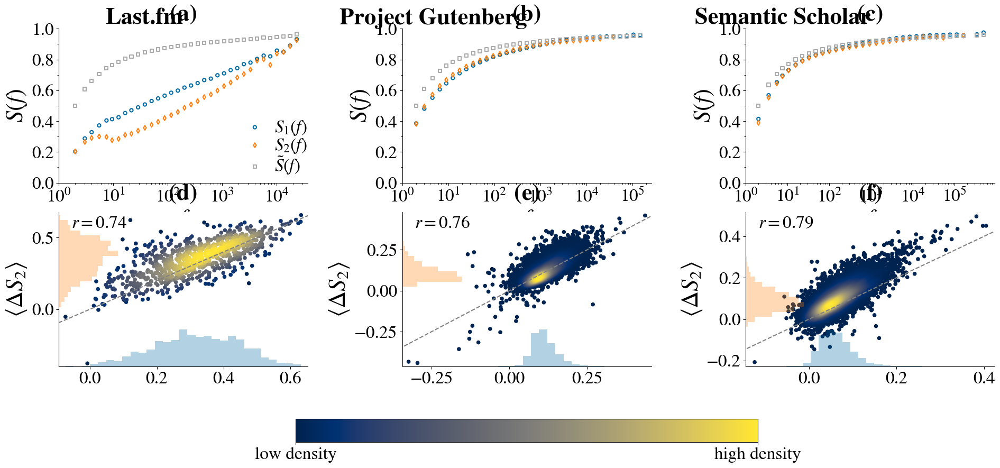

In [1008]:
fig = fig_4({key:data_with_entropy[key] for key in ['Last.fm', 'Project Gutenberg', 'Semantic Scholar']}, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

p-value pearson between None and $\langle\Delta S \rangle$ 2.4556612484583385e-06
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.0797027291466465e-131
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 8.185399436005836e-218
p-value pearson between None and $\langle\Delta S_2 \rangle$ 1.3305214081438763e-301
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_1$ and $\langle\Delta S \rangle$ 2.2839264783179714e-210
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 1.6221697216721574e-23


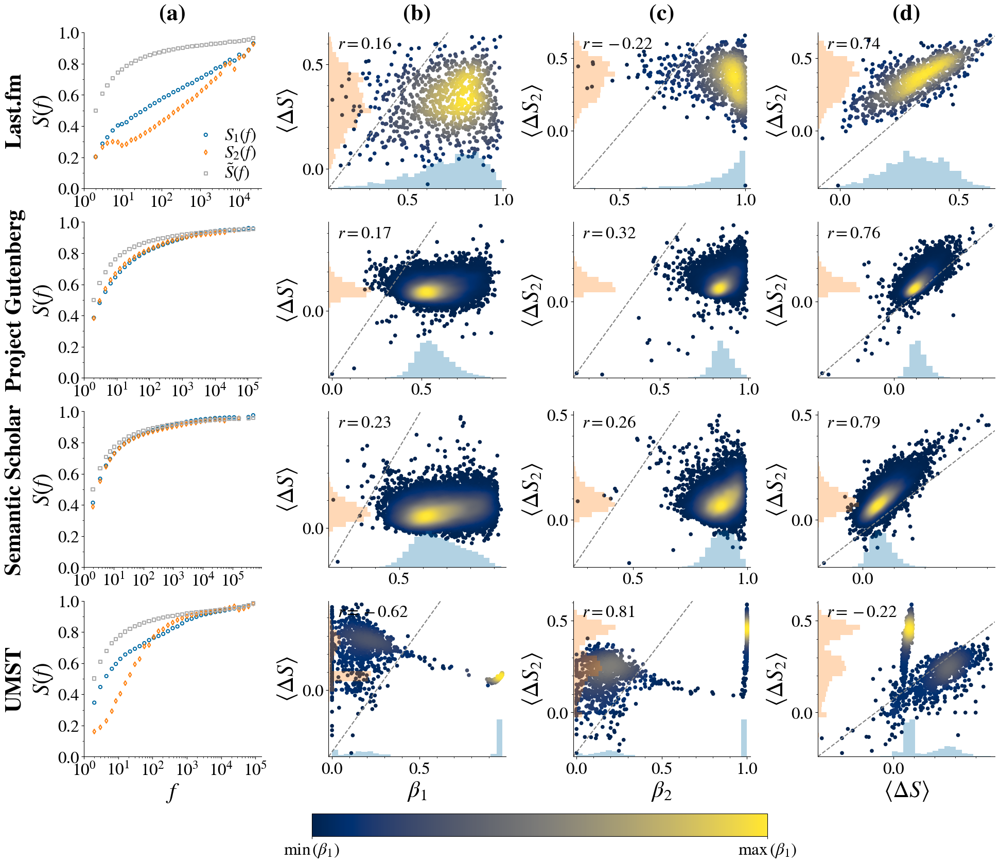

In [947]:
fig = fig_4(data_with_entropy, marker_size = 20, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res_beta_2.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_beta_2.pdf"))

### Figures with UMST until nu = 10

p-value pearson between None and $\langle\Delta S \rangle$ 1.2034278963553053e-30
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.2716750886150943e-07
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 7.528467657611713e-33
p-value pearson between None and $\langle\Delta S_2 \rangle$ 9.692054212000998e-302
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 2.260517578240683e-19
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 5.1269654548279894e-20
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 4.052796802407886e-112


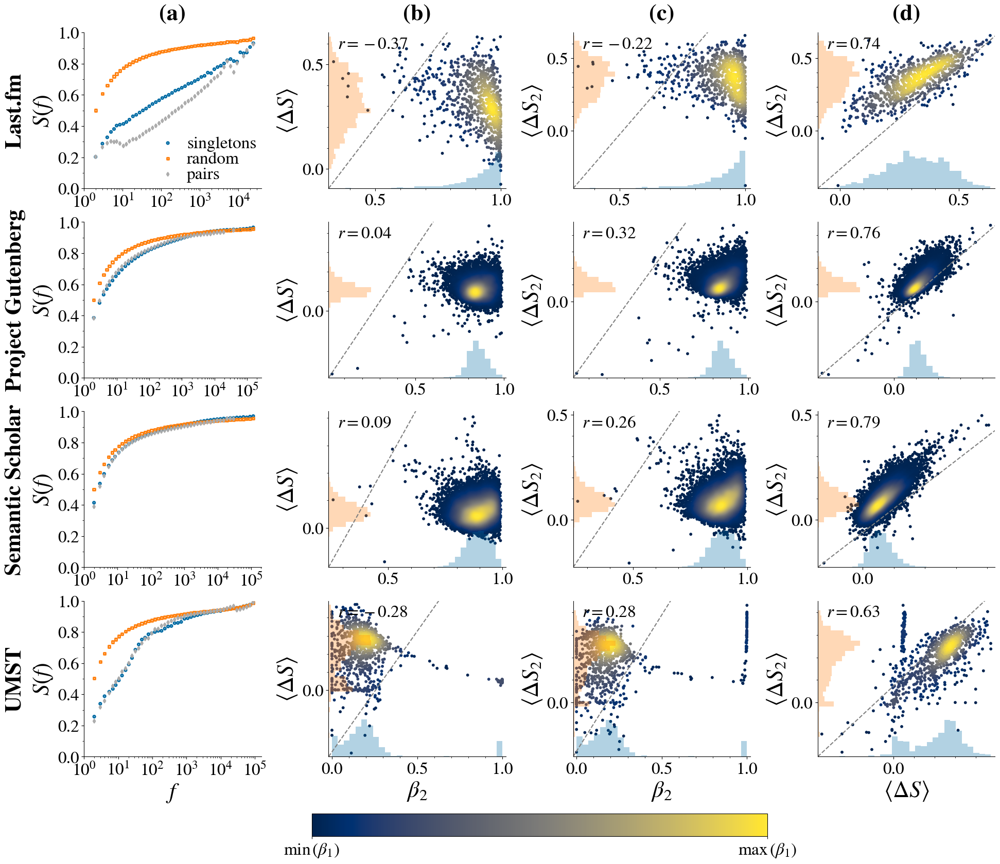

In [850]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

p-value pearson between None and $\langle\Delta S \rangle$ 1.2034278963553053e-30
p-value pearson between None and $\langle\Delta S_2 \rangle$ 4.596948264111428e-11
p-value pearson between None and $\langle\Delta S_2 \rangle$ 6.907131956589577e-158
p-value pearson between None and $\langle\Delta S \rangle$ 1.2716750886150943e-07
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between None and $\langle\Delta S \rangle$ 7.528467657611713e-33
p-value pearson between None and $\langle\Delta S_2 \rangle$ 9.692054212000998e-302
p-value pearson between None and $\langle\Delta S_2 \rangle$ 0.0
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 2.260517578240683e-19
p-value pearson between $\beta_2$ and $\langle\Delta S_2 \rangle$ 5.1269654548279894e-20
p-value pearson between $\langle\Delta S \rangle$ and $\langle\Delta S_2 \rangle$ 4.052796802407886e-112


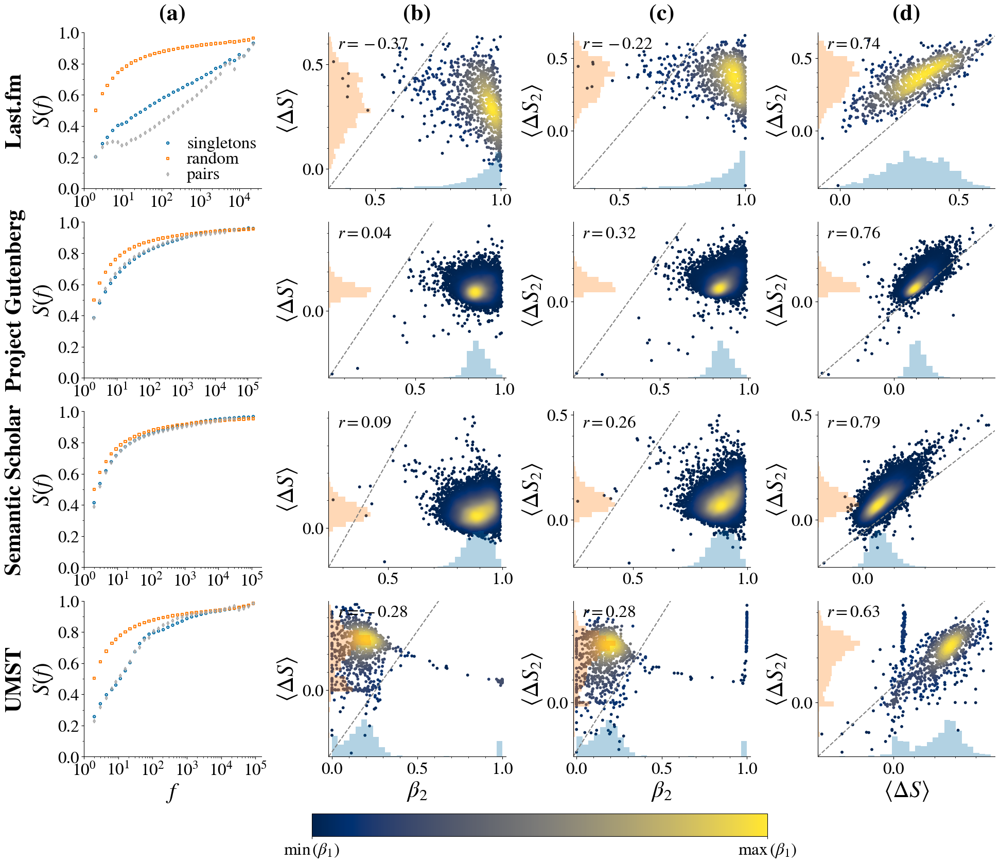

In [861]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
#           min_x = 0,
#           max_x = 1,
#           min_y = -0.1,
#           max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

### OLD Figures

p-value pearson between None and $\langle\Delta S \rangle$ 4.099423569830891e-06
p-value pearson between None and $\langle\Delta S \rangle$ 1.1071019303359732e-129
p-value pearson between None and $\langle\Delta S \rangle$ 2.5444345126675577e-249
p-value pearson between None and $\langle\Delta S \rangle$ 0.2283735308639822
p-value pearson between $\beta_2$ and $\langle\Delta S \rangle$ 5.6400797834081e-156


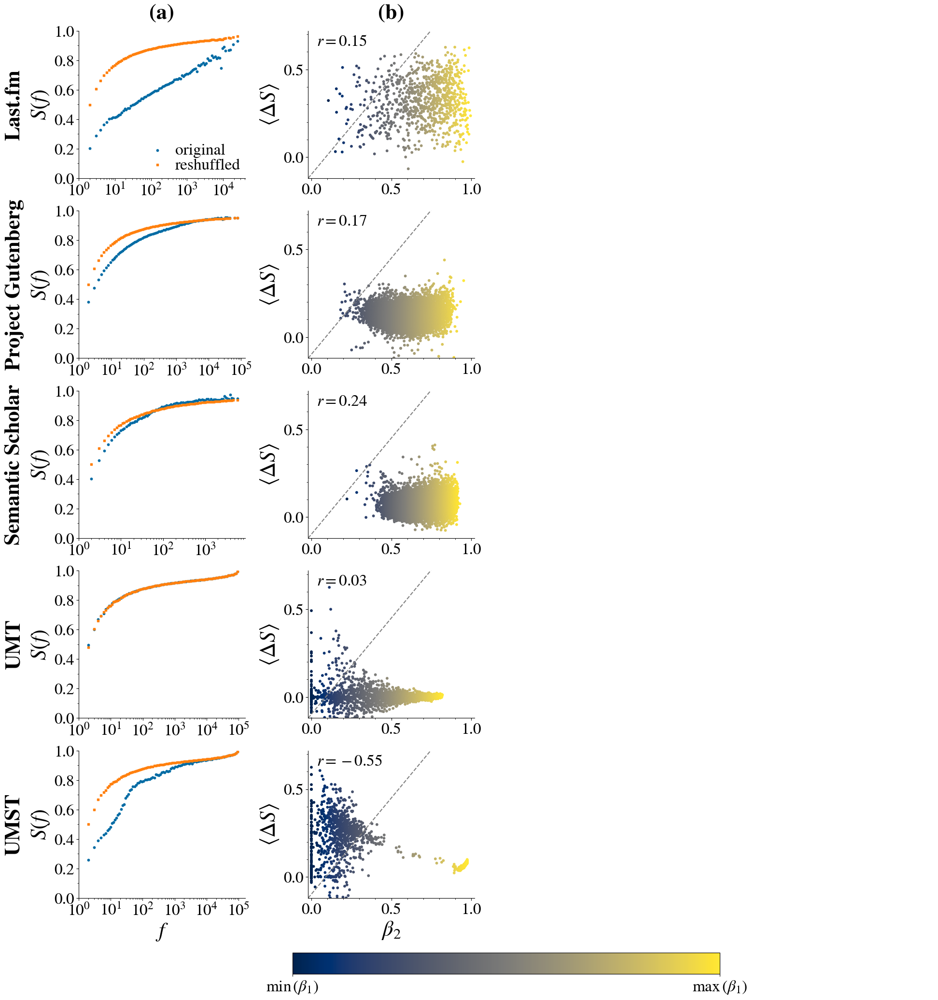

In [520]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

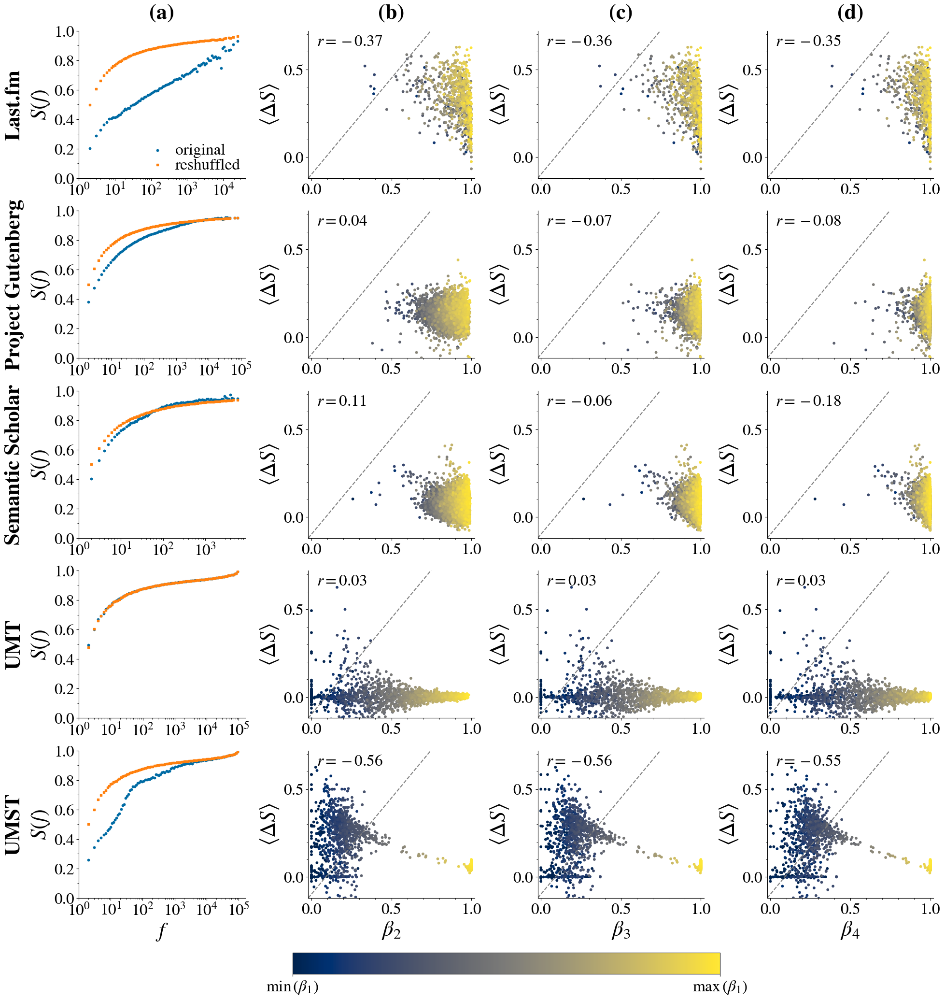

In [458]:
fig = fig_4(data_with_entropy, marker_size = 10, alpha_scatter = 1, 
          min_x = 0,
          max_x = 1,
          min_y = -0.1,
          max_y = 0.7,
          x_correlation_text = .05,
          y_correlation_text = .9,
          use_same_x_y_max_lim = False,
         )
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.png"))
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy_low_res.pdf"),dpi=100)
fig.savefig(os.path.join(figures_folder, f"Fig4_entropy.pdf"))

# Figure5: UMT numeric vs analytical

## Pairs

### Functions

In [176]:
def fit_to_str(a,b,c,d):
#     return r"$%.1f t^{%.2f+%.1f/(%.1f+\log_2(t))}$"%(a,b,c,d)
    return r"$%.1f t^{%.2f+\frac{%.1f}{%.1f+\log_2(t)}}$"%(a,b,c,d)

def get_dD2(analytic_data, nu, rho, ax, fontsize=16, print_all_legend_labels = True, use_approximated=True):
    """
    Takes the analytic data and finds a fit of the type a * x ** (b+c/(d+np.log2(x))). 
    If it does not give ERROR (a), it does not impose any constraint on b.
    """
    xs = np.array(list(analytic_data.t))
    Cs = np.array(list(analytic_data.data))
    beta_1 = float(nu)/rho
    b = (rho - nu)**beta_1
    factors = b * beta_1 * (xs ** (beta_1 - 1))
    ys = 2*factors - factors*factors + (1-factors)**2 * Cs
    if use_approximated:
        ys = 2*factors + Cs

    e=1
    f=0
    
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    xs_log = np.log2(xs)
    ys_log = np.log2(ys)
    try:
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,p0=[1,nu/rho-1,1,1], bounds=([0,-1,0,0], [np.inf,0,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (a)',er)
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,bounds=([0,nu/rho-0.000000001-1,0,0.1], [np.inf,nu/rho+0.000000001-1,np.inf,np.inf]))
    a,b,c,d = popt_log_B
    b_old = b
    residuals = ys - func(xs, *popt_log_B)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = ys_log - func_log(xs_log, *popt_log_B)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(ys)
    R_squared_log = 1-(ss_res_log**2)/np.var(ys_log)

    exponents_log = np.array([b+c*d/((d+np.log2(e*x))**2) for x in xs])

    return popt_log_B

In [177]:
def exp_to_str(a,b,c,d):
#    return r"$%.2f+%.1f/(%.1f+\log_2(t))$"%(b,c,d)
    return r"$%.2f+\frac{%.1f}{%.1f+\log_2(t)}$"%(np.round(b,decimals=2),np.round(c, decimals=1),np.round(d, decimals=1))
    
def get_D2(analytic_data,mean_urn, popt_log_B, nu, rho, ax, expMin=0, expMax=16, fontsize=16, 
            print_all_legend_labels = True,
            use_odeint = False,
           ):
    """
    Takes the fitted analytic function to dD2 analytic data and integrates it analytically.
    Then, it is both fitted with the power law function as in the simulations, and fitted to a similar function type as done with dD2, 
    i.e. of the type a * x ** (b+c/(d+np.log2(x))).  If it does not give ERROR (b), it does not impose any constraint on b.
    
    A similar analytical fit is done for the data from the simulations (using ts_geom >= 10**exmMin and D2 in loglog), 
    i.e. of the type a * x ** (b+c/(d+np.log2(x))).  If it does not give ERROR (c), it does not impose any constraint on b.
    
    if use_odeint == False, instead of integrating analytically, the new function is given by the same parameters obtained for dD2, 
    with just b += 1 and a /= b
    """
    from scipy.integrate import odeint
    e=1
    f=0
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    t0 = 1 
    y0 = 1 
    ts_system = np.geomspace(t0,10**expMax,10000)
    if use_odeint == True:
        # y'(t) = func(t,a,b,c,d)
        def system(y, t, *popt_log_B):
            dy = [func(t,*popt_log_B)]
            return dy
        a,b,c,d = popt_log_B
        sol = odeint(system, y0 , ts_system, args=(a,b,c,d))
        sol = np.transpose(sol)[0]
    else:
        a,b,c,d = popt_log_B
        b += 1
        a /= b
        sol = func(ts_system,a,b,c,d)
        popt_log = (a,b,c,d)
        sol = sol - sol[0] + 1
    
    last_to_check = 100
    mean_urn["new_analytic2_loglogregr_points"] = np.array([powerLawRegrPoints(ts_system[max(0,i-last_to_check):i], sol[max(0,i-last_to_check):i])[0]
                                               for i in range(last_to_check,len(ts_system))])
    mean_urn["new_analytic2_loglogregr_points_xs"] = ts_system[last_to_check:]

    if print_all_legend_labels:
        label1 = r"equation"
    else:
        label1 = ""

    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(ts_system)
    sol_log = np.log2(sol)
    if use_odeint == True:
        try:
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1], bounds=([0,0,0,0], [np.inf,1,np.inf,np.inf]))
        except RuntimeError as er:
            print('ERROR (b)',er)
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1],bounds=([0,float(nu)/rho-0.000000001,0,0.1], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
        a,b,c,d = popt_log
    b_free = b
    exp_law_free = exp_to_str(a,b,c,d)
    residuals = sol - func(ts_system, *popt_log)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = sol_log - func_log(ts_log, *popt_log)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(sol)
    R_squared_log = 1-(ss_res_log**2)/np.var(sol_log)
    label2 = 'an.fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    print(label2)

    exponents_eq = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['eq_fit_beta2_xs'] = ts_system
    mean_urn['eq_fit_beta2'] = exponents_eq

    
    if print_all_legend_labels:
        label3 = r"simulation"
    else:
        label3 = ""
    
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.array([np.log2(_) for _ in mean_urn["ts_geom"][1:]-1 if np.log10(_) >= expMin])
    D2_indices_log = np.array([np.log2(_) for i_,_ in enumerate(mean_urn["D2_indices"][mean_urn['indices_geom']][1:]) if np.log10(mean_urn["ts_geom"][1:]-1)[i_] >= expMin])
    try:
        raise RuntimeError
        popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,0,0,0], [np.inf,1,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (c)',er)
        popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
    a,b,c,d = popt_sim 
    b_sim = b
    exp_law_sim = exp_to_str(a,b,c,d)
    residuals = mean_urn["D2_indices"][mean_urn['indices_geom']][1:] - func(mean_urn["ts_geom"][1:]-1, *popt_sim)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = D2_indices_log - func_log(ts_log, *popt_sim)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn['indices_geom']][1:])
    R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
    label4 = 'an.fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    print(label4)
    exponents_sim = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['sim_fit_beta2_xs'] = ts_system
    mean_urn['sim_fit_beta2'] = exponents_sim

    return mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_free, exp_law_sim

In [516]:
for i in range(3,20):
    print(i, len(np.unique(np.geomspace(1, 10**i, 1000,dtype=int))),np.unique(np.geomspace(1, 10**i, 1000,dtype=int))[-100])

3 424 504
4 599 4014
5 698 31952
6 761 254334
7 805 2024446
8 836 16114142
9 860 128264983
10 878 1020960662
11 893 8126619200
12 905 64686076615
13 915 514886745013
14 923 4098383671757
15 930 32622220097116
16 936 259665597293487
17 941 2066880249629090
18 946 16451905877536674


OverflowError: Python int too large to convert to C long

In [518]:
m = 190000
for i in range(1000,10000):
    m = min(m,len(np.unique(np.geomspace(1, i, 1000,dtype=int))))
print(m)

424


In [513]:
for i in range(3,20):
    print(i, np.unique(np.geomspace(1, 10**i, 1000,dtype=float))[-100])

3 504
4 4014
5 31952
6 254334
7 2024446
8 16114142
9 128264983
10 1020960662
11 8126619200
12 64686076615
13 514886745013
14 4098383671757
15 32622220097116
16 259665597293487
17 2066880249629090
18 16451905877536674


OverflowError: Python int too large to convert to C long

In [178]:
def final_plot_fits(urn, nu, rho, ax, exp_law_free, exp_law_sim,fontsize=16, print_all_legend_labels = True, max_num_major_xticks = 5):
    ax.axhline(nu/rho,ls="--",color="gray",lw=3,label=r"$\nu/\rho=%.2f$"%(nu/rho))
    ax.plot(urn["new_analytic2_loglogregr_points_xs"],np.array(urn["new_analytic2_loglogregr_points"]),lw=3, color = CB_color_cycle[0], 
            label = "power-law fit Eq. 9" if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (eq. p.l. fit)")
    ax.plot(urn["eq_fit_beta2_xs"], np.array(urn["eq_fit_beta2"]),ls='--',lw=2, color = "blue", #CB_color_cycle[0], 
            label = fr"{exp_law_free}") # label = r"$\beta_2(t)$ (eq. an. fit)")
    ax.plot(urn["ts_geom"][100:]-1, np.array(urn["beta2_loglogregr_indices_geom"])[100:],lw=3, color = CB_color_cycle[1], 
            label = "power-law fit simul." if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (sim. p.l. fit)")
    ax.plot(urn["sim_fit_beta2_xs"], np.array(urn["sim_fit_beta2"]),ls='--',lw=2, color = "red", #CB_color_cycle[1], 
            label = fr"{exp_law_sim}") # label = r"$\beta_2(t)$ (sim. an. fit)")
    
#     if print_all_legend_labels:
    if nu/rho > 0.4:
        ax.legend(fontsize=fontsize, loc = "lower right", labelspacing = 0.3,)
    else:
        ax.legend(fontsize=fontsize, loc = "upper right", labelspacing = 0.3,)

    
    ax.set_xlim((100,Tmax))
    ax.set_ylim((0,1.01))
    ax.set_xscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\beta_2(t)$" if print_all_legend_labels else None)
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
    ax.xaxis.set_major_locator(locmaj)
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    return None

In [179]:
def simulation_vs_analytic_plot(rho, results_simulations,
                                fontsize_legend=16, lower_bound = 1e3, upper_bound = 1e7, 
                                use_approximated=True, expMin=3, expMax=7, 
                                max_num_major_xticks = 5, 
                                use_odeint=False,):
    Tmax = int(1e7)
    eta = 1
    counter = 0
    letters = "ABCDEFGHIJKLMNOPQRSTUVWXYZ".lower()
    fig, axes = plt.subplots(1,rho-1,figsize=(width_fig*(rho)/4,width_fig*2/3/3), gridspec_kw={'hspace':.2,'wspace':0.3})
    for row,nu in enumerate(range(1,rho)):
        print(nu)
        ax = axes[row]
        if row == 0:
            print_all_legend_labels = True
        else:
            print_all_legend_labels = False
        mean_urn = results_simulations[eta][rho][nu]
        indices = mean_urn["indices"]
        indices_geom = mean_urn["indices_geom"]
        ts = mean_urn["ts"]
        ts_geom = mean_urn["ts_geom"]

        if expMax <= 7:
            analytic_data = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{expMin}_expMax{expMax}_data.csv",names=["t","data"])
        else:
            analytic_data = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{3}_expMax{7}_data.csv",names=["t","data"])
            analytic_data2 = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{7}_expMax{10}_data.csv",names=["t","data"])
            analytic_data2.drop(analytic_data2.index[0], inplace=True)
            analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            if expMax > 10:
                analytic_data2 = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{10}_expMax{20}_data.csv",names=["t","data"])
                analytic_data2.drop(analytic_data2.index[0], inplace=True)
                analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            analytic_data = analytic_data[analytic_data.t <= 10**expMax]
        
        popt_log_B = get_dD2(analytic_data, nu, rho, ax, fontsize=fontsize_legend, print_all_legend_labels=True,use_approximated=use_approximated)
        results_simulations[eta][rho][nu]['parameters_dD2'] = popt_log_B

        mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_eq, exp_law_sim = get_D2(
            analytic_data, mean_urn, popt_log_B, nu, rho, ax, 
            expMin=expMin, expMax=expMax,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            use_odeint = use_odeint, 
        )

        final_plot_fits(
            mean_urn, nu, rho, ax, exp_law_eq, exp_law_sim,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            max_num_major_xticks = max_num_major_xticks, 
        )
        
#         if nu != 1:
#             ax.legend( [r"$\nu/\rho=%.2f$"%(nu/rho)], loc='lower right', fontsize=fontsize_legend, )#[ax.plot([],[],ls="--",color="gray",lw=3)],
        ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        
    if use_odeint == True:
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_odeint.png"%(rho, expMin, expMax)))
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_odeint.pdf"%(rho, expMin, expMax)))
    else:
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_from_dD2.png"%(rho, expMin, expMax)))
        fig.savefig(os.path.join(figures_folder, f"Fig5_UMT_numeric_vs_analytic_rho_%d_expMin_%d_expMax_%d_from_dD2.pdf"%(rho, expMin, expMax)))
        
    return(results_simulations)

### Figures

expMax must be 16, because after 16 there is a change in behaviour in the numerical results of the integral done in Mathematica (referring to $C(t)$ in the main paper), either because of working precision errors or similar issues.

1
an.fit: $1.0 t^{0.25+\frac{5.1}{16.1+\log_2(t)}}$
$SER$=0.01, $R^2=1.00$
ERROR (c) 
an.fit: $1.0 t^{0.25+\frac{7.2}{16.1+\log_2(t)}}$
$SER$=0.01, $R^2=1.00$
2
an.fit: $1.4 t^{0.52+\frac{5.2}{8.9+\log_2(t)}}$
$SER$=0.06, $R^2=1.00$
ERROR (c) 
an.fit: $0.6 t^{0.50+\frac{7.5}{18.3+\log_2(t)}}$
$SER$=0.01, $R^2=1.00$
3
an.fit: $0.7 t^{0.75+\frac{8.5}{13.2+\log_2(t)}}$
$SER$=0.05, $R^2=1.00$
ERROR (c) 
an.fit: $0.7 t^{0.75+\frac{8.1}{46.4+\log_2(t)}}$
$SER$=0.00, $R^2=1.00$


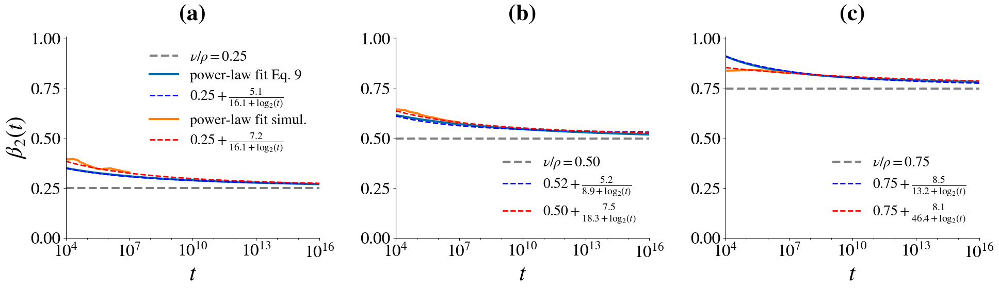

In [180]:
rho = 4
expMin = 2
expMax = 16
results_simulations_long = simulation_vs_analytic_plot(
    rho, results_simulations_long,fontsize_legend=20,
    lower_bound = 10**4, upper_bound = 10**expMax,
    expMin=expMin,expMax=expMax,
    use_odeint=True, 
    max_num_major_xticks = 5, 
    use_approximated=True,
)

## Figure SI: more details

### Pairs

#### Functions

In [157]:
def fit_to_str(a,b,c,d):
#     return r"$%.1f t^{%.2f+%.1f/(%.1f+\log_2(t))}$"%(a,b,c,d)
    return r"$%.1f t^{%.2f+\frac{%.1f}{%.1f+\log_2(t)}}$"%(a,b,c,d)

def plot_dD2_SI(analytic_data, nu, rho, ax, fontsize=16, print_all_legend_labels = True, use_approximated=True):
    xs = np.array(list(analytic_data.t))
    Cs = np.array(list(analytic_data.data))
    beta_1 = float(nu)/rho
    b = (rho - nu)**beta_1
    factors = b * beta_1 * (xs ** (beta_1 - 1))
    ys = 2*factors - factors*factors + (1-factors)**2 * Cs
    if use_approximated:
        ys = 2*factors + Cs

    e=1
    f=0
    
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    if print_all_legend_labels:
        ax.plot(xs,ys, lw=3, label=r"$\nu = %d, \, \rho = %d$"%(nu,rho), color = CB_color_cycle[0],)
    else:
        ax.plot(xs,ys, lw=3, color = CB_color_cycle[0],) 
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    xs_log = np.log2(xs)
    ys_log = np.log2(ys)
    try:
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,p0=[1,nu/rho-1,1,1], bounds=([0,-1,0,0], [np.inf,0,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (a)',er)
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,bounds=([0,nu/rho-0.000000001-1,0,0.1], [np.inf,nu/rho+0.000000001-1,np.inf,np.inf]))
    a,b,c,d = popt_log_B
    b_old = b
    residuals = ys - func(xs, *popt_log_B)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = ys_log - func_log(xs_log, *popt_log_B)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(ys)
    R_squared_log = 1-(ss_res_log**2)/np.var(ys_log)
    ax.plot(xs, func(xs,*popt_log_B), '--', color = "blue", #CB_color_cycle[0],
             label=fit_to_str(a,b,c,d) + 
            "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log))

    exponents_log = np.array([b+c*d/((d+np.log2(e*x))**2) for x in xs])

    ax.set_xscale("log")
    ax.set_yscale("log")
    if nu/rho < 0.:
        ax.legend(fontsize=fontsize, loc = "upper right") 
    else:
        ax.legend(fontsize=fontsize, loc = "lower left")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\mathrm{d}D_2(t)/\mathrm{d}t}$")
    
    return popt_log_B

In [181]:
def exp_to_str(a,b,c,d):
#     return r"$%.2f+%.1f/(%.1f+\log_2(t))$"%(b,c,d)
    return r"$%.2f+\frac{%.1f}{%.1f+\log_2(t)}$"%(np.round(b,decimals=2),np.round(c, decimals=1),np.round(d, decimals=1))
    
def plot_D2_SI(analytic_data,mean_urn, popt_log_B, nu, rho, ax, expMax=16, fontsize=16, 
            print_all_legend_labels = True,
            use_odeint = False,
           ):
    def func(x,a,b,c,d,e=1,f=0):#,x2):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    t0 = 1 
    y0 = 1 
    e=1
    f=0
    ts_system = np.geomspace(t0,10**expMax,10000)
    if use_odeint == True:
        # y'(t) = func(t,a,b,c,d)
        def system(y, t, *popt_log_B):
            dy =  [func(t,*popt_log_B)]
            return dy
        a,b,c,d = popt_log_B
        sol = odeint(system, y0 , ts_system, args=(a,b,c,d))
        sol = np.transpose(sol)[0]
    else:
        a,b,c,d = popt_log_B
        b += 1
        a /= b
        sol = func(ts_system,a,b,c,d)
        popt_log = (a,b,c,d)
        sol = sol - sol[0] + 1
    
    last_to_check = 100
    mean_urn["new_analytic2_loglogregr_points"] = np.array([powerLawRegrPoints(ts_system[max(0,i-last_to_check):i], sol[max(0,i-last_to_check):i])[0]
                                               for i in range(last_to_check,len(ts_system))])
    mean_urn["new_analytic2_loglogregr_points_xs"] = ts_system[last_to_check:]


    if print_all_legend_labels:
        label1 = r"equation"
    else:
        label1 = ""
    p1, = ax.plot(ts_system,sol, label=label1, lw=3, color = CB_color_cycle[0],)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(ts_system)
    sol_log = np.log2(sol)
    if use_odeint == True:
        try:
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1], bounds=([0,0,0,0], [np.inf,1,np.inf,np.inf]))
        except RuntimeError as er:
            print('ERROR (b)',er)
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1],bounds=([0,float(nu)/rho-0.000000001,0,0.1], [2,nu/rho+0.000000001,100,100]))
        a,b,c,d = popt_log
    b_free = b
    exp_law_free = exp_to_str(a,b,c,d)
    residuals = sol - func(ts_system, *popt_log)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = sol_log - func_log(ts_log, *popt_log)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(sol)
    R_squared_log = 1-(ss_res_log**2)/np.var(sol_log)
    label2 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    p2, = ax.plot(ts_system, func(ts_system,*popt_log), '--', color = "blue", #CB_color_cycle[0], 
                  label=label2)
    exponents_eq = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['eq_fit_beta2_xs'] = ts_system
    mean_urn['eq_fit_beta2'] = exponents_eq

    
    if print_all_legend_labels:
        label3 = r"simulation"
    else:
        label3 = ""
    
    p3, = ax.plot(mean_urn["ts_geom"][1:]-1,mean_urn["D2_indices"][mean_urn['indices_geom']][1:], label=label3, lw=3, color = CB_color_cycle[1],)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(mean_urn["ts_geom"][1:]-1)
    D2_indices_log = np.log2(mean_urn["D2_indices"][mean_urn['indices_geom']][1:])
    try:
        raise RuntimeError
        popt_sim, pcov = curve_fit(func_log, ts_log[30:], D2_indices_log[30:],p0=[1,float(nu)/rho,1,1],bounds=([0,0,0,0], [2,1,1000,1000]))
    except RuntimeError as er:
        print('ERROR (c)',er)
        popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
    a,b,c,d = popt_sim 
    b_sim = b
    exp_law_sim = exp_to_str(a,b,c,d)
    residuals = mean_urn["D2_indices"][mean_urn['indices_geom']][1:] - func(mean_urn["ts_geom"][1:]-1, *popt_sim)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = D2_indices_log - func_log(ts_log, *popt_sim)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn['indices_geom']][1:])
    R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
    label4 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    # USE same as system
#     p4, = ax.plot(mean_urn["ts_geom"], func(mean_urn["ts_geom"],*popt_sim), '--', color = "red", #CB_color_cycle[1],
    p4, = ax.plot(ts_system, func(ts_system,*popt_sim), '--', color = "red", #CB_color_cycle[1],
             label=label4)
    exponents_sim = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])
    
    mean_urn['sim_fit_beta2_xs'] = ts_system# mean_urn['ts_geom']
    mean_urn['sim_fit_beta2'] = exponents_sim

#     # REPEAT FOR D
    
#     ts_log = np.log2(mean_urn["ts_geom"])
#     D_indices_log = np.log2(mean_urn["D_indices"][mean_urn["indices_geom"]])
#     # popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,bounds=([0,0,0,0], [10,1,100,100]))
#     try:
#         raise RuntimeError
# #         popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,nu/rho,1,1],bounds=([0,0,0,0], [1,1,np.inf,np.inf]))
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0.9,0,0,0], [1,np.inf,np.inf,np.inf]))
#     except RuntimeError as er:
#         print('ERROR (d)',er)
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
#     a,b,c,d = popt_sim # [2.30976089, -0.52648358,  4.94643769,  7.35037396]
#     b_sim = b
#     exp_law_sim = exp_to_str(a,b,c,d)
# #     print(popt_sim)
#     residuals = mean_urn["D2_indices"][mean_urn["indices_geom"]] - func(mean_urn["ts_geom"], *popt_sim)
#     ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     residuals = D_indices_log - func_log(ts_log, *popt_sim)
#     ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn["indices_geom"]])
#     R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
#     labelD = 'fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
#     exponents_simD = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])

#     mean_urn['sim_fit_beta_xs'] = ts_system# mean_urn["ts_geom"]
#     mean_urn['sim_fit_beta'] = exponents_simD
    
    
    ax.set_xlim(left=100, right = 1e7)
    ax.set_ylim(bottom=1, top=1e7)
    
    if nu/rho < 0.4:
        ax.legend(fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) # loc = "upper left")
    else:
        if print_all_legend_labels:
            l1 = ax.legend([p1, p2],[label1,label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p3, p4],[label3,label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        else:
            l1 = ax.legend([p2],[label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p4],[label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        ax.add_artist(l1)

    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$D_2(t)$")

    return mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_free, exp_law_sim

In [182]:
def final_plot_fits(urn, nu, rho, ax, exp_law_free, exp_law_sim,fontsize=16, print_all_legend_labels = True, max_num_major_xticks = 5):
    ax.axhline(nu/rho,ls="--",color="gray",lw=3,label=r"$\nu/\rho=%.2f$"%(nu/rho))
    ax.plot(urn["new_analytic2_loglogregr_points_xs"],np.array(urn["new_analytic2_loglogregr_points"]),lw=3, color = CB_color_cycle[0], 
            label = "power-law fit Eq. 9" if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (eq. p.l. fit)")
    ax.plot(urn["eq_fit_beta2_xs"], np.array(urn["eq_fit_beta2"]),ls='--',lw=2, color = "blue", #CB_color_cycle[0], 
            label = fr"{exp_law_free}") # label = r"$\beta_2(t)$ (eq. an. fit)")
    ax.plot(urn["ts_geom"][100:]-1, np.array(urn["beta2_loglogregr_indices_geom"])[100:],lw=3, color = CB_color_cycle[1], 
            label = "power-law fit simul." if print_all_legend_labels else None) # label = r"$\beta_2(t)$ (sim. p.l. fit)")
    ax.plot(urn["sim_fit_beta2_xs"], np.array(urn["sim_fit_beta2"]),ls='--',lw=2, color = "red", #CB_color_cycle[1], 
            label = fr"{exp_law_sim}") # label = r"$\beta_2(t)$ (sim. an. fit)")
    
#     if print_all_legend_labels:
    if nu/rho > 0.4:
        ax.legend(fontsize=fontsize, loc = "lower right", labelspacing = 0.3,)
    else:
        ax.legend(fontsize=fontsize, loc = "upper right", labelspacing = 0.3,)

    
    ax.set_xlim((100,Tmax))
    ax.set_ylim((0,1.01))
    ax.set_xscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\beta_2(t)$" if print_all_legend_labels else None)
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
    ax.xaxis.set_major_locator(locmaj)
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    return None

In [183]:
def simulation_vs_analytic_plot_SI(rho, results_simulations,
                                fontsize_legend=16, lower_bound = 1e3, upper_bound = 1e7, 
                                use_approximated=True, expMin=3, expMax=7, 
                                max_num_major_xticks = 5,
                                use_odeint=False,):
    Tmax = int(1e7)
    eta = 1
    counter = 0
    letters = "ABCDEFGHIJKLMNOPQRSTUVWXYZ".lower()
    fig, axes = plt.subplots(rho-1,3,figsize=(width_fig,width_fig*2/3*(rho-1)/3), gridspec_kw={'hspace':.2,'wspace':0.33})
    for row,nu in enumerate(range(1,rho)):
        print(nu)
        if row == 0:
            print_all_legend_labels = True
        else:
            print_all_legend_labels = False
        mean_urn = results_simulations[eta][rho][nu]
        indices = mean_urn["indices"]
        indices_geom = mean_urn["indices_geom"]
        ts = mean_urn["ts"]
        ts_geom = mean_urn["ts_geom"]

        if expMax <= 7:
            analytic_data = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{expMin}_expMax{expMax}_data.csv",names=["t","data"])
        else:
            analytic_data = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{0}_expMax{7}_data.csv",names=["t","data"])
            analytic_data2 = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{7}_expMax{10}_data.csv",names=["t","data"])
            analytic_data2.drop(analytic_data2.index[0], inplace=True)
            analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            if expMax > 10:
                analytic_data2 = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent/rho{rho}_nu{nu}_expMin{10}_expMax{20}_data.csv",names=["t","data"])
                analytic_data2.drop(analytic_data2.index[0], inplace=True)
                analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            analytic_data = analytic_data[analytic_data.t <= 10**expMax]
#         analytic_data.data = analytic_data.data.apply(lambda x:min(x,1))
        
        ax = axes[row,0] if rho > 2 else axes[0]
        popt_log_B = plot_dD2_SI(analytic_data, nu, rho, ax, fontsize=fontsize_legend, print_all_legend_labels=True,use_approximated=use_approximated)
        results_simulations[eta][rho][nu]['parameters_dD2'] = popt_log_B
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        
        ax = axes[row,1] if rho > 2 else axes[1]
        mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_eq, exp_law_sim = plot_D2_SI(
            analytic_data, mean_urn, popt_log_B, nu, rho, ax, 
            expMax=expMax,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            use_odeint = use_odeint, 
        )
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        ax.set_ylim(1,upper_bound)
        
#         ax = axes[row,2] if rho > 2 else axes[2]
#         plot_b2_fit(ts_system, mean_urn,exponents_eq, exponents_sim, exp_law_free, exp_law_sim, ax, fontsize=16)

        ax = axes[row,2] if rho > 2 else axes[2]
        final_plot_fits(
            mean_urn, nu, rho, ax, exp_law_eq, exp_law_sim,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            max_num_major_xticks = max_num_major_xticks, 
        )
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
#         ax.set_xticks([10**3, 10**5, 10**7])
        ax.set_ylabel(r"$\beta_2(t)$")
        counter += 1
        
    if use_odeint == True:
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_odeint_expMin_%d.png"%(rho,expMin)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_odeint_expMin_%d.pdf"%(rho,expMin)))
    else:
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_from_dD2_expMin_%d.png"%(rho,expMin)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_UMT_numeric_vs_analytic_rho_%d_from_dD2_expMin_%d.pdf"%(rho,expMin)))
        
    return(results_simulations)

#### Figures

expMax must be 16, because after 16 there is a change in behaviour in the numerical results of the integral done in Mathematica (referring to $C(t)$ in the main paper), either because of working precision errors or similar issues.

1
ERROR (c) 
2
ERROR (c) 
3
ERROR (c) 


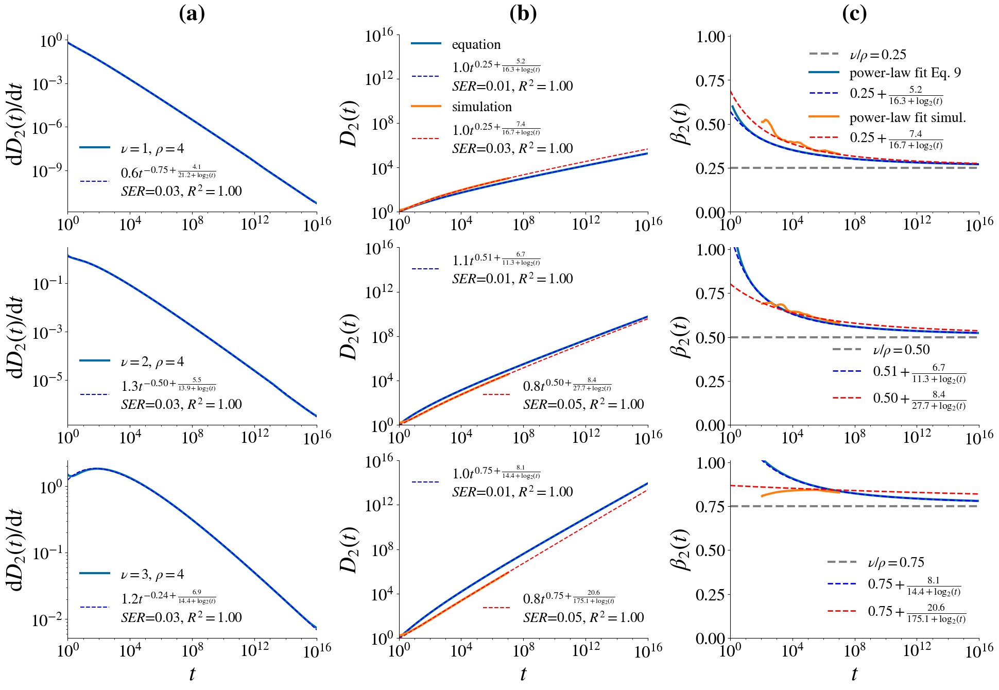

In [184]:
rho = 4
expMin = 0
expMax = 16
_ = simulation_vs_analytic_plot_SI(
    rho, results_simulations_long,fontsize_legend=20,
    lower_bound = 10**expMin, upper_bound = 10**expMax,
    expMin=expMin,expMax=expMax,
    use_odeint=True, 
    max_num_major_xticks = 5, 
    use_approximated=True,
)

1
ERROR (c) 
2
ERROR (c) 
3
ERROR (c) 


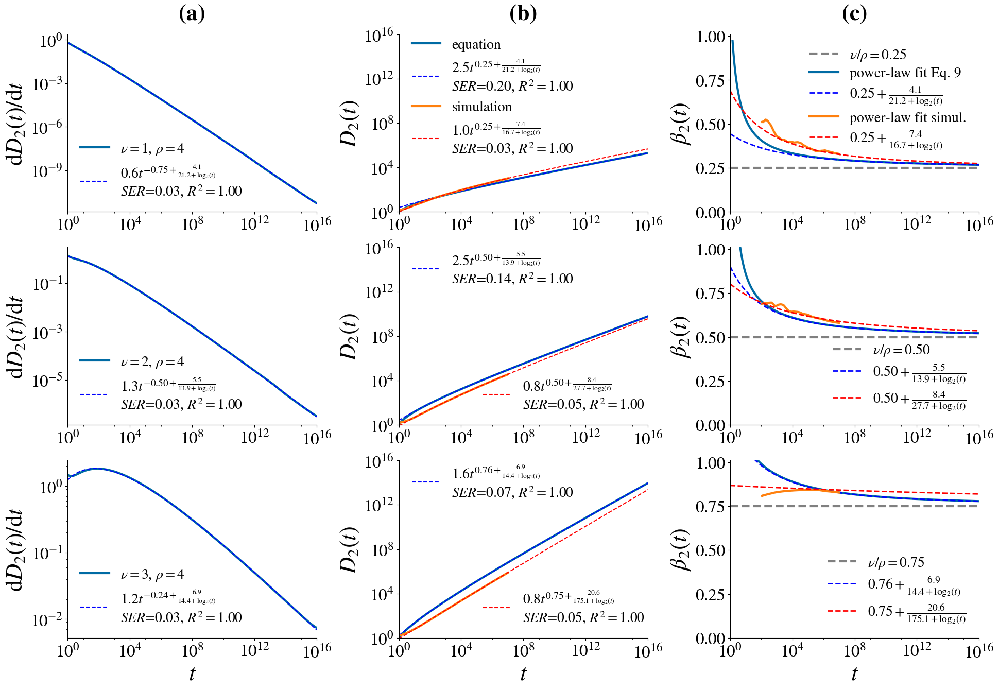

In [185]:
rho = 4
expMin = 0
expMax = 16
_ = simulation_vs_analytic_plot_SI(
    rho, results_simulations_long,fontsize_legend=20,
    lower_bound = 10**expMin, upper_bound = 10**expMax,
    expMin=expMin,expMax=expMax,
    use_odeint=False, 
    max_num_major_xticks = 5, 
    use_approximated=True,
)

### Triplets

#### Functions

In [187]:
def fit_to_str(a,b,c,d):
#     return r"$%.1f t^{%.2f+%.1f/(%.1f+\log_2(t))}$"%(a,b,c,d)
    return r"$%.1f t^{%.2f+\frac{%.1f}{%.1f+\log_2(t)}}$"%(a,b,c,d)


def plot_dD3(analytic_data, nu, rho, ax, results_simulations, fontsize=16, print_all_legend_labels = True, use_approximated=True):
    xs = np.array(list(analytic_data.t))
    Cs = np.array(list(analytic_data.data))
    beta_1 = float(nu)/rho
    b = (rho - nu)**beta_1
    dD1 = b * beta_1 * (xs ** (beta_1 - 1))
    dD2_popt_log = results_simulations[1][rho][nu]['parameters_dD2']
    e=1
    f=0
    def func(x,a,b,c,d):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    dD2 = func(xs,*dD2_popt_log)
    ys = dD2 + dD1 + Cs

    
    if print_all_legend_labels:
        ax.plot(xs,ys, lw=3, label=r"$\nu = %d, \, \rho = %d$"%(nu,rho))
    else:
        ax.plot(xs,ys, lw=3) 
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    xs_log = np.log2(xs)
    ys_log = np.log2(ys)
    try:
        raise RuntimeError
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,p0=[1,nu/rho-1,1,1], bounds=([0,-1,0,0], [np.inf,0,np.inf,np.inf]))
    except RuntimeError as er:
        print('ERROR (a)',er)
        popt_log_B, pcov = curve_fit(func_log, xs_log, ys_log,bounds=([0,nu/rho-0.000000001-1,0,0.1], [np.inf,nu/rho+0.000000001-1,np.inf,np.inf]))
    a,b,c,d = popt_log_B
    b_old = b
    residuals = ys - func(xs, *popt_log_B)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = ys_log - func_log(xs_log, *popt_log_B)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(ys)
    R_squared_log = 1-(ss_res_log**2)/np.var(ys_log)
    ax.plot(xs, func(xs,*popt_log_B), 'b--',
             label=fit_to_str(a,b,c,d) + 
            "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log))

    exponents_log = np.array([b+c*d/((d+np.log2(e*x))**2) for x in xs])

    ax.set_xscale("log")
    ax.set_yscale("log")
    if nu/rho < 0.:
        ax.legend(fontsize=fontsize, loc = "upper right") 
    else:
        ax.legend(fontsize=fontsize, loc = "lower left")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\mathrm{d}D_3(t)/\mathrm{d}t}$")
    
    return popt_log_B

In [199]:
def exp_to_str(a,b,c,d):
#         return r"$%.2f+%.1f/(%.1f+\log_2(t))$"%(b,c,d)
    return r"$%.2f+\frac{%.1f}{%.1f+\log_2(t)}$"%(np.round(b,decimals=2),np.round(c, decimals=1),np.round(d, decimals=1))
    
def plot_D3(analytic_data,mean_urn, popt_log_B, nu, rho, ax, expMax=16, fontsize=16, 
            print_all_legend_labels = True,
            use_odeint = False,
           ):
    from scipy.integrate import odeint
    def func(x,a,b,c,d,e=1,f=0):#,x2):
        return a * x ** (b+c/(d+np.log2(e*x))) + f
    t0 = 1 
    y0 = 1 
    e=1
    f=0
    ts_system = np.geomspace(t0,10**expMax,10000)
    if use_odeint == True:
        # y'(t) = func(t,a,b,c,d)
        def system(y, t, *popt_log_B):
            dy = [func(t,*popt_log_B)]
            return dy
        a,b,c,d = popt_log_B
        sol = odeint(system, y0 , ts_system, args=(a,b,c,d))
        sol = np.transpose(sol)[0]
    else:
        a,b,c,d = popt_log_B
        b += 1
        a /= b
        sol = func(ts_system,a,b,c,d)
        popt_log = (a,b,c,d)
        sol = sol - sol[0] + 1
    
    last_to_check = 100
    mean_urn["new_analytic3_loglogregr_points"] = np.array([powerLawRegrPoints(ts_system[max(0,i-last_to_check):i], sol[max(0,i-last_to_check):i])[0]
                                               for i in range(last_to_check,len(ts_system))])
    mean_urn["new_analytic3_loglogregr_points_xs"] = ts_system[last_to_check:]


    if print_all_legend_labels:
        label1 = r"equation"
    else:
        label1 = ""
    p1, = ax.plot(ts_system,sol, label=label1, lw=3)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(ts_system)
    sol_log = np.log2(sol)
    if use_odeint == True:
        try:
            raise RuntimeError
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1], bounds=([0,0,0,0], [2,1,100,100]))
        except RuntimeError as er:
            print('ERROR (b)',er)
            popt_log, pcov = curve_fit(func_log, ts_log, sol_log,p0=[1,float(nu)/rho,1,1],bounds=([0,float(nu)/rho-0.000000001,0,0.1], [2,nu/rho+0.000000001,100,100]))
        a,b,c,d = popt_log
    b_free = b
    exp_law_free = exp_to_str(a,b,c,d)
    residuals = sol - func(ts_system, *popt_log)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = sol_log - func_log(ts_log, *popt_log)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(sol)
    R_squared_log = 1-(ss_res_log**2)/np.var(sol_log)
    label2 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    p2, = ax.plot(ts_system, func(ts_system,*popt_log), 'b--',label=label2)
    exponents_eq = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])
    
    mean_urn['eq_fit_beta3_xs'] = ts_system
    mean_urn['eq_fit_beta3'] = exponents_eq

    
    if print_all_legend_labels:
        label3 = r"simulation"
    else:
        label3 = ""
    
    p3, = ax.plot(mean_urn["ts_geom"][2:]-2,mean_urn["D3_indices"][mean_urn['indices_geom']][2:], label= label3, lw=3)
    def func_log(x,a,b,c,d):
        return np.log2(a) + x * (b+c/(d+np.log2(e*2**x))) 
    ts_log = np.log2(mean_urn["ts_geom"][2:]-2)
    D3_indices_log = np.log2(mean_urn["D3_indices"][mean_urn['indices_geom']][2:])
    try:
        raise RuntimeError
        popt_sim, pcov = curve_fit(func_log, ts_log[30:], D3_indices_log[30:],p0=[1,float(nu)/rho,1,1],bounds=([0,0,0,0], [2,1,1000,1000]))
    except RuntimeError as er:
        print('ERROR (c)',er)
        popt_sim, pcov = curve_fit(func_log, ts_log, D3_indices_log,p0=[1,float(nu)/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [1000,nu/rho+0.000000001,1000,1000]))
    a,b,c,d = popt_sim 
    b_sim = b
    exp_law_sim = exp_to_str(a,b,c,d)
    residuals = mean_urn["D3_indices"][mean_urn['indices_geom']][2:] - func(mean_urn["ts_geom"][2:]-2, *popt_sim)
    ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    residuals = D3_indices_log - func_log(ts_log, *popt_sim)
    ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
    R_squared = 1-(ss_res**2)/np.var(mean_urn["D3_indices"][mean_urn['indices_geom']][2:])
    R_squared_log = 1-(ss_res_log**2)/np.var(D3_indices_log)
    label4 = fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
    p4, = ax.plot(mean_urn["ts_geom"][2:]-2, func(mean_urn["ts_geom"][2:]-2,*popt_sim), 'r--',
             label=label4)
    exponents_sim = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])
    
    mean_urn['sim_fit_beta3_xs'] = ts_system# mean_urn['ts_geom']
    mean_urn['sim_fit_beta3'] = exponents_sim

#     # REPEAT FOR D
    
#     ts_log = np.log2(mean_urn["ts_geom"])
#     D_indices_log = np.log2(mean_urn["D_indices"][mean_urn["indices_geom"]])
#     # popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,bounds=([0,0,0,0], [10,1,100,100]))
#     try:
#         raise RuntimeError
# #         popt_sim, pcov = curve_fit(func_log, ts_log, D2_indices_log,p0=[1,nu/rho,1,1],bounds=([0,0,0,0], [1,1,np.inf,np.inf]))
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0.9,0,0,0], [1,np.inf,np.inf,np.inf]))
#     except RuntimeError as er:
#         print('ERROR (d)',er)
#         popt_sim, pcov = curve_fit(func_log, ts_log, D_indices_log,p0=[1,nu/rho,1,1],bounds=([0,nu/rho-0.000000001,0,0], [np.inf,nu/rho+0.000000001,np.inf,np.inf]))
#     a,b,c,d = popt_sim # [2.30976089, -0.52648358,  4.94643769,  7.35037396]
#     b_sim = b
#     exp_law_sim = exp_to_str(a,b,c,d)
# #     print(popt_sim)
#     residuals = mean_urn["D2_indices"][mean_urn["indices_geom"]] - func(mean_urn["ts_geom"], *popt_sim)
#     ss_res = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     residuals = D_indices_log - func_log(ts_log, *popt_sim)
#     ss_res_log = np.sqrt(np.sum(residuals**2)/(len(residuals)-2))
#     R_squared = 1-(ss_res**2)/np.var(mean_urn["D2_indices"][mean_urn["indices_geom"]])
#     R_squared_log = 1-(ss_res_log**2)/np.var(D2_indices_log)
#     labelD = 'fit: %s'%fit_to_str(a,b,c,d) + "\n"+r"$SER$=%.2f"%ss_res_log + r", $R^2=%.2f$"%(R_squared_log)
#     exponents_simD = np.array([b+c*d/((d+np.log2(e*x))**2) for x in ts_system])# mean_urn["ts_geom"]])

#     mean_urn['sim_fit_beta_xs'] = ts_system# mean_urn["ts_geom"]
#     mean_urn['sim_fit_beta'] = exponents_simD
    
    
    ax.set_xlim(left=100, right = 1e7)
    ax.set_ylim(bottom=1, top=1e7)
    
    if nu/rho < 0.4:
        ax.legend(fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) # loc = "upper left")
    else:
        if print_all_legend_labels:
            l1 = ax.legend([p1, p2],[label1,label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p3, p4],[label3,label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        else:
            l1 = ax.legend([p2],[label2], fontsize=fontsize, loc='upper left', bbox_to_anchor=(0., 1.05)) #, loc="upper left")
            l2 = ax.legend([p4],[label4], fontsize=fontsize, loc='lower right', bbox_to_anchor=(1.04, 0)) # , loc="lower right")
        ax.add_artist(l1)

    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$D_3(t)$")

    return mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_free, exp_law_sim

In [200]:
def final_plot_fits_D3(urn, nu, rho, ax, exp_law_free, exp_law_sim,fontsize=16, print_all_legend_labels = True, max_num_major_xticks = 5):
    ax.axhline(nu/rho,ls="--",color="gray",lw=3,label=r"$\nu/\rho=%.2f$"%(nu/rho))
    ax.plot(urn["new_analytic3_loglogregr_points_xs"],np.array(urn["new_analytic3_loglogregr_points"]),lw=3, color = CB_color_cycle[0], 
            label = "power-law fit Eq. 31" if print_all_legend_labels else None) # label = r"$\beta_2$ (eq. p.l. fit)")
    ax.plot(urn["eq_fit_beta3_xs"], np.array(urn["eq_fit_beta3"]),ls='--',lw=2, color = "blue", #CB_color_cycle[0], 
            label = fr"{exp_law_free}") # label = r"$\beta_2$ (eq. an. fit)")
    ax.plot(urn["ts_geom"][100:], np.array(urn["beta3_loglogregr_indices_geom"])[100:],lw=3, color = CB_color_cycle[1], 
            label = "power-law fit simul." if print_all_legend_labels else None) # label = r"$\beta_2$ (sim. p.l. fit)")
    ax.plot(urn["sim_fit_beta3_xs"], np.array(urn["sim_fit_beta3"]),ls='--',lw=2, color = "red", #CB_color_cycle[1], 
            label = fr"{exp_law_sim}") # label = r"$\beta_2$ (sim. an. fit)")
    
#     if print_all_legend_labels:
    if nu/rho > 0.4:
        ax.legend(fontsize=fontsize, loc = "lower right", labelspacing = 0.3,)
    else:
        ax.legend(fontsize=fontsize, loc = "upper right", labelspacing = 0)

    
    ax.set_xlim((100,Tmax))
    ax.set_ylim((0,1.01))
    ax.set_xscale("log")
    ax.set_xlabel(r"$t$")
    ax.set_ylabel(r"$\beta_3(t)$")
    # Impose xticks
    locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
    ax.xaxis.set_major_locator(locmaj)
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
    locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
    ax.xaxis.set_minor_locator(locmin)
    ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
    return None

In [201]:
def simulation_vs_analytic_plot_D3(rho, results_simulations,
                                fontsize_legend=16, lower_bound = 1e3, upper_bound = 1e7, 
                                use_approximated=True, expMin=3, expMax=7, 
                                   max_num_major_xticks = 5,
                                use_odeint=False,):
    Tmax = int(1e7)
    eta = 1
    counter = 0
    letters = "ABCDEFGHIJKLMNOPQRSTUVWXYZ".lower()
    fig, axes = plt.subplots(rho-1,3,figsize=(width_fig,width_fig*2/3*(rho-1)/3), gridspec_kw={'hspace':.2,'wspace':0.33})
    for row,nu in enumerate(range(1,rho)):
        print(nu)
        if row == 0:
            print_all_legend_labels = True
        else:
            print_all_legend_labels = False
        mean_urn = results_simulations[eta][rho][nu]
        indices = mean_urn["indices"]
        indices_geom = mean_urn["indices_geom"]
        ts = mean_urn["ts"]
        ts_geom = mean_urn["ts_geom"]

        if expMax <= 7:
            analytic_data = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{expMin}_expMax{expMax}_data.csv",names=["t","data"])
        else:
            analytic_data = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{expMin}_expMax{7}_data.csv",names=["t","data"])
            analytic_data2 = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{7}_expMax{10}_data.csv",names=["t","data"])
            analytic_data2.drop(analytic_data2.index[0], inplace=True)
            analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            if expMax > 10:
                analytic_data2 = pd.read_csv(f"./data/Analytic_UMT/Analytic_data_independent_triplet/rho{rho}_nu{nu}_expMin{10}_expMax{20}_data.csv",names=["t","data"])
                analytic_data2.drop(analytic_data2.index[0], inplace=True)
                analytic_data = analytic_data.append(analytic_data2, ignore_index=True)
            analytic_data = analytic_data[analytic_data.t <= 10**expMax]
#         analytic_data.data = analytic_data.data.apply(lambda x:min(x,1))
        
        ax = axes[row,0] if rho > 2 else axes[0]
        popt_log_B = plot_dD3(analytic_data, nu, rho, ax, results_simulations, fontsize=fontsize_legend, print_all_legend_labels=True,use_approximated=use_approximated)
        results_simulations[eta][rho][nu]['parameters_dD3'] = popt_log_B
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        
        ax = axes[row,1] if rho > 2 else axes[1]
        mean_urn, ts_system, exponents_eq, exponents_sim, exp_law_eq, exp_law_sim = plot_D3(
            analytic_data, mean_urn, popt_log_B, nu, rho, ax, 
            expMax=expMax,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            use_odeint = use_odeint, 
        )
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
#         ax.set_xticks([10**3, 10**5, 10**7])
        counter += 1
        ax.set_ylim(1,upper_bound)
        
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        

        ax = axes[row,2] if rho > 2 else axes[2]
        final_plot_fits_D3(
            mean_urn, nu, rho, ax, exp_law_eq, exp_law_sim,
            fontsize=fontsize_legend, 
            print_all_legend_labels=print_all_legend_labels,
            max_num_major_xticks = max_num_major_xticks, 
        )
        
        if nu != rho-1:
            ax.set_xlabel("")
        if row == 0:
            ax.text(0.5, 1.08, f"({letters[counter]})", transform=ax.transAxes, fontweight='bold', horizontalalignment='center')
        ax.set_xlim(lower_bound, upper_bound)
# #         ax.set_xticks([10**3, 10**5, 10**7])
#         ax.set_ylabel(r"$\beta_n$")
        counter += 1
        # Impose xticks
        locmaj = matplotlib.ticker.LogLocator(base=10,numticks=max_num_major_xticks) 
        ax.xaxis.set_major_locator(locmaj)
        # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(np.arange(0.1,1,0.1)),numticks=20)
        locmin = matplotlib.ticker.LogLocator(base=10.0,numticks=100)
        ax.xaxis.set_minor_locator(locmin)
        ax.xaxis.set_minor_formatter(matplotlib.ticker.NullFormatter())
        
    if use_odeint == True:
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_odeint.png"%(rho)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_odeint.pdf"%(rho)))
    else:
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_from_dD3.png"%(rho)))
        fig.savefig(os.path.join(figures_folder, f"FigSI_D3_UMT_numeric_vs_analytic_rho_%d_from_dD3.pdf"%(rho)))
        
    return(results_simulations)

#### Figures

In [260]:
with open('./data/simulations/rho_4.00000/nu_1/Tmax_10000000/eta_1.00000/UMT_light_run_38.pkl', 'rb') as fp:
    tmp = pickle.load(fp)

In [261]:
tmp.keys()

dict_keys(['ts', 'indices', 'ts_geom', 'indices_geom', 'D_indices', 'D2_indices', 'D3_indices', 'D4_indices', 'weighted_diff_entropies', 'beta_mean_indices', 'beta2_mean_indices', 'beta3_mean_indices', 'beta4_mean_indices', 'beta_loglogregr_indices_geom', 'beta2_loglogregr_indices_geom', 'beta3_loglogregr_indices_geom', 'beta4_loglogregr_indices_geom', 'intercept_loglogregr_indices_geom', 'intercept2_loglogregr_indices_geom', 'intercept3_loglogregr_indices_geom', 'intercept4_loglogregr_indices_geom', 'std_err_beta_loglogregr_indices_geom', 'std_err_beta2_loglogregr_indices_geom', 'std_err_beta3_loglogregr_indices_geom', 'std_err_beta4_loglogregr_indices_geom', 'std_err_intercept_loglogregr_indices_geom', 'std_err_intercept2_loglogregr_indices_geom', 'std_err_intercept3_loglogregr_indices_geom', 'std_err_intercept4_loglogregr_indices_geom'])

In [250]:
eta = .1
rho = 4
nu = 1
mean_urn = results_simulations_long[eta][rho][nu]
indices = mean_urn["indices"]
indices_geom = mean_urn["indices_geom"]
ts = mean_urn["ts"]
ts_geom = mean_urn["ts_geom"]
D = mean_urn["D_indices"]
D2 = mean_urn["D2_indices"]
D3 = mean_urn["D3_indices"]

In [251]:
len(ts), len(indices), len(D), len(D2), len(indices_geom), len(mean_urn["beta3_loglogregr_indices_geom"])

(1803, 1803, 1803, 1803, 805, 805)

In [262]:
results = tmp
if results['ts'][-1] == Tmax - 1 or results['D_indices'][0] > 1:
        # adjust the results from the old setup to the new one
        right_len_indices = len(results['indices'])+1
        right_len_indices_geom = len(results['indices_geom'])+1
        for _ in results.keys():
            if _ in ['indices','indices_geom']:
                results[_] = [1] + list(np.array(results[_])+1)
            elif _ in ['ts', 'ts_geom']:
                results[_] = np.array([1] + list(np.array(results[_])+1))
            elif _ in ['D_indices']:
                results[_] = np.array([1] + list(np.array(results[_])))
            elif _ in ['D2_indices', 'D3_indices','D4_indices']:
                results[_] = np.array([0] + list(np.array(results[_])))
            else:
                if 'geom' in _ and len(_) == right_len_indices_geom - 1:
                    results[_] = np.array(list(results[_])+results[_][-1])
                elif len(_) == right_len_indices - 1:
                    results[_] = np.array(list(results[_])+results[_][-1])
                else:
                    print('problem with', _,)

problem with weighted_diff_entropies
problem with beta_mean_indices
problem with beta2_mean_indices
problem with beta3_mean_indices
problem with beta4_mean_indices
problem with beta_loglogregr_indices_geom
problem with beta2_loglogregr_indices_geom
problem with beta3_loglogregr_indices_geom
problem with beta4_loglogregr_indices_geom
problem with intercept_loglogregr_indices_geom
problem with intercept2_loglogregr_indices_geom
problem with intercept3_loglogregr_indices_geom
problem with intercept4_loglogregr_indices_geom
problem with std_err_beta_loglogregr_indices_geom
problem with std_err_beta2_loglogregr_indices_geom
problem with std_err_beta3_loglogregr_indices_geom
problem with std_err_beta4_loglogregr_indices_geom
problem with std_err_intercept_loglogregr_indices_geom
problem with std_err_intercept2_loglogregr_indices_geom
problem with std_err_intercept3_loglogregr_indices_geom
problem with std_err_intercept4_loglogregr_indices_geom


In [265]:
right_len_indices

1804

In [266]:
results['indices']

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 74,
 75,
 76,
 77,
 78,
 80,
 81,
 82,
 84,
 85,
 86,
 88,
 89,
 91,
 92,
 94,
 95,
 97,
 98,
 100,
 101,
 103,
 105,
 106,
 108,
 110,
 112,
 113,
 115,
 117,
 119,
 121,
 123,
 125,
 127,
 129,
 131,
 133,
 135,
 138,
 140,
 142,
 144,
 147,
 149,
 152,
 154,
 157,
 159,
 162,
 164,
 167,
 170,
 172,
 175,
 178,
 181,
 184,
 187,
 190,
 193,
 196,
 199,
 202,
 206,
 209,
 212,
 216,
 219,
 223,
 227,
 230,
 234,
 238,
 242,
 246,
 250,
 254,
 258,
 262,
 266,
 271,
 275,
 279,
 284,
 289,
 293,
 298,
 303,
 308,
 313,
 318,
 323,
 328,
 334,
 339,
 344,
 350,
 356,
 362,
 367,
 373,
 379,
 386,
 392,
 398,
 405,
 411,
 418,
 425,
 432,
 4

In [264]:
len(results['beta_mean_indices'])

1803

[]

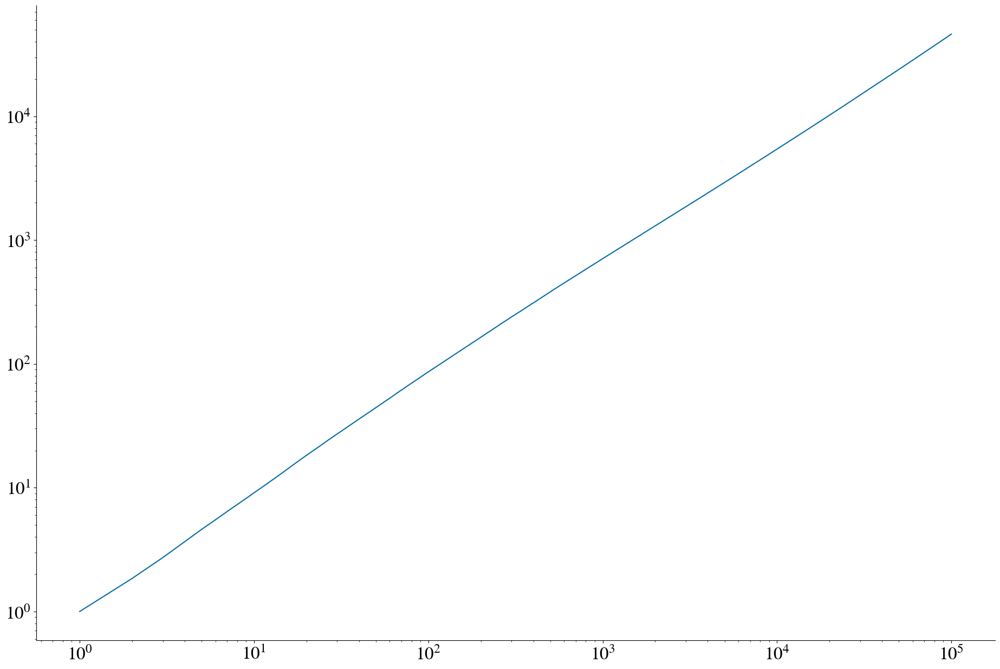

In [207]:
plt.plot(mean_urn["ts_geom"][2:]-2,mean_urn["D3_indices"][mean_urn['indices_geom']][2:])
plt.loglog()

1
ERROR (a) 
ERROR (b) 
ERROR (c) 
2
ERROR (a) 
ERROR (b) 
ERROR (c) 
3
ERROR (a) 
ERROR (b) 
ERROR (c) 


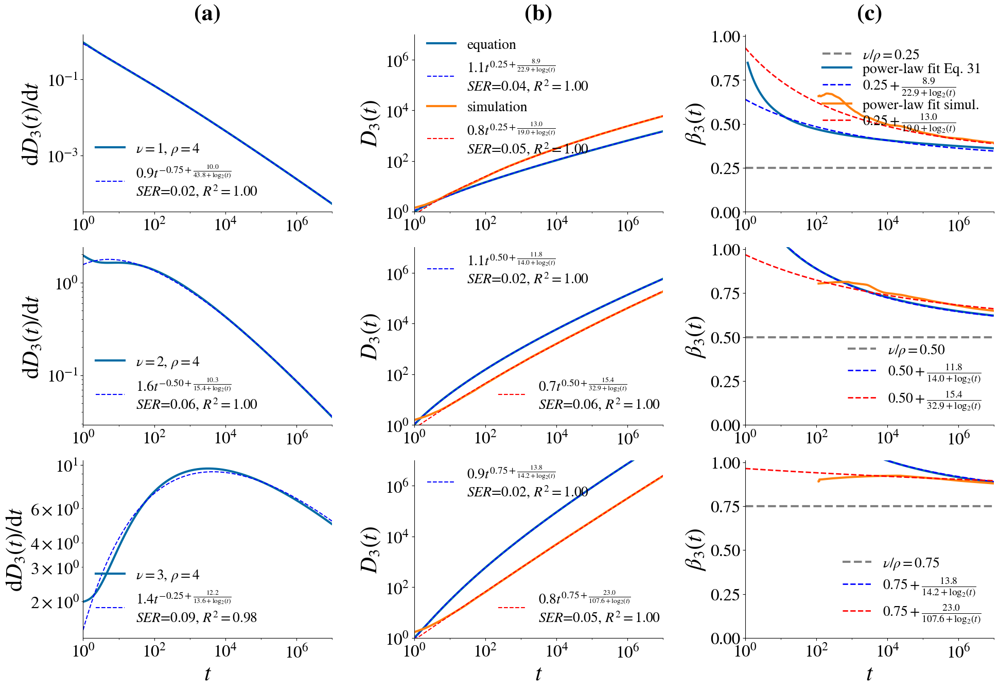

In [202]:
expMax = 7
_ = simulation_vs_analytic_plot_D3(4, results_simulations_long,fontsize_legend=20,
                                       lower_bound = 1e0, upper_bound = 10**(expMax),
                                       expMin=0,expMax=expMax,
                                   max_num_major_xticks = 5,
                                       use_odeint=True, 
                                       use_approximated=True,)